<a href="https://colab.research.google.com/github/G-Gaddu/Quant-Material/blob/main/Volatility_Forecasting_on_Commodities.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [34]:
!pip install arch

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 983.4/983.4 kB 39.3 MB/s eta 0:00:00


In [35]:
import yfinance as yf
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
import datetime
import scipy.stats as stats
import seaborn as sns
from statsmodels.tsa.stattools import adfuller
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error as mse
from arch import arch_model

In [37]:
import warnings
warnings.filterwarnings('ignore')


In [3]:
# Define the tickers for the 27 largest commodity futures
tickers = [
    "CL=F",  # Crude Oil
    "GC=F",  # Gold
    "NG=F",  # Natural Gas
    "ZC=F", # Corn Futures
    "MGC=F", # Mini Gold
    "SB=F", # Sugar
    "ZS=F", # Soybean
    "SI=F", # Silver
    "ZL=F", # Soybean Oil
    "HG=F", # Copper
    "ZM-F", # Soybean Meal
    "RB=F", # RBOB Gasoline
    "BZ=F" # Brent Crude
    "HO=F", # Heating Oil
    "PL=F", # Platinum
    "HE=F", # Lean Hogs
    "CF=F", # Cotton
    "SIL=F", # Micro Silver
    "KE=F", # KC HRW Wheat
    "CC=F", # Cocoa
    "LE=F", # Live Cattle
    "KC=F", # Coffee
    "PA=F", # Palladium
    "GF=F", # Feeder Cattle
    "OJ=F", # Orange Juice
    "ZO=F", # Oat
    "ZR=F", # Rough Rice
    "LBS=F", # Lumber
]

# Define the date range
start_date = datetime.datetime.now() - datetime.timedelta(days=5*365)
end_date = datetime.datetime.now()

# Download the data
data = yf.download(tickers, start=start_date, end=end_date, interval="1d")['Adj Close']

# Print the data
print(data)


[*********************100%***********************]  27 of 27 completed
ERROR:yfinance:
3 Failed downloads:
ERROR:yfinance:['BZ=FHO=F', 'CF=F', 'ZM-F']: YFTzMissingError('$%ticker%: possibly delisted; no timezone found')


Ticker                     BZ=FHO=F     CC=F  CF=F       CL=F         GC=F  \
Date                                                                         
2019-09-16 00:00:00+00:00       NaN   2383.0   NaN  62.900002  1503.099976   
2019-09-17 00:00:00+00:00       NaN   2394.0   NaN  59.340000  1505.099976   
2019-09-18 00:00:00+00:00       NaN   2401.0   NaN  58.110001  1507.500000   
2019-09-19 00:00:00+00:00       NaN   2468.0   NaN  58.130001  1498.400024   
2019-09-20 00:00:00+00:00       NaN   2473.0   NaN  58.090000  1507.300049   
...                             ...      ...   ...        ...          ...   
2024-09-06 00:00:00+00:00       NaN   9459.0   NaN  67.669998  2493.500000   
2024-09-09 00:00:00+00:00       NaN   9839.0   NaN  68.709999  2501.800049   
2024-09-10 00:00:00+00:00       NaN   9654.0   NaN  65.750000  2512.300049   
2024-09-11 00:00:00+00:00       NaN  10115.0   NaN  67.309998  2512.100098   
2024-09-12 00:00:00+00:00       NaN   7517.0   NaN  68.269997  2

In [4]:
# Count the NaNs for each column
nan_counts = data.isna().sum()
print(nan_counts)


Ticker
BZ=FHO=F    1258
CC=F           0
CF=F        1258
CL=F           0
GC=F           0
GF=F           2
HE=F           2
HG=F           0
KC=F           0
KE=F           1
LBS=F        335
LE=F           2
MGC=F          0
NG=F           0
OJ=F           0
PA=F           1
PL=F           1
RB=F           0
SB=F           0
SI=F           1
SIL=F          1
ZC=F           1
ZL=F           1
ZM-F        1258
ZO=F           1
ZR=F           3
ZS=F           1
dtype: int64


In [5]:
# Drop columns with more than 252 NaNs
data = data.dropna(axis=1, thresh=len(data) - 252)

# Fill remaining NaNs with forward fill and then backfill
data.fillna(method='ffill', inplace=True)
data.fillna(method='bfill', inplace=True)


Data Exploration

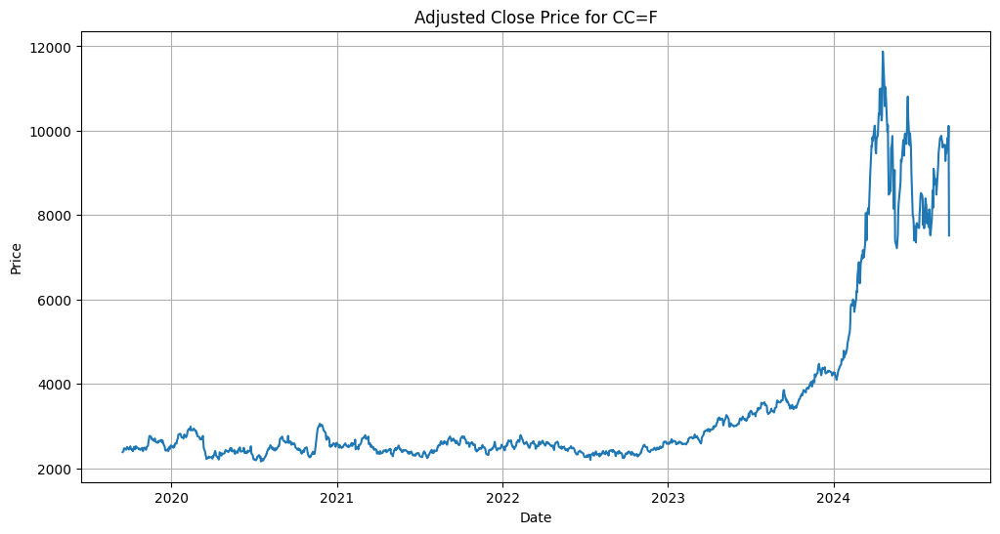

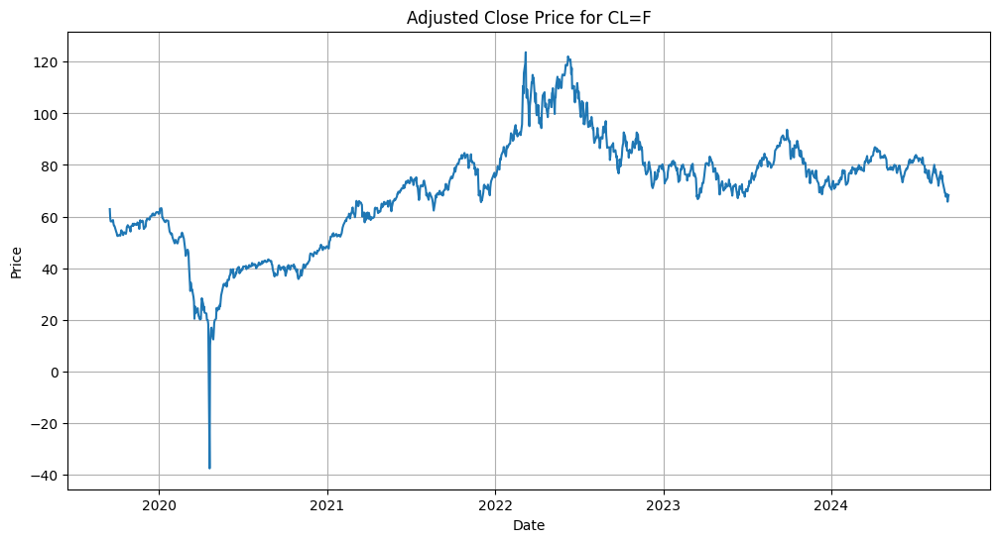

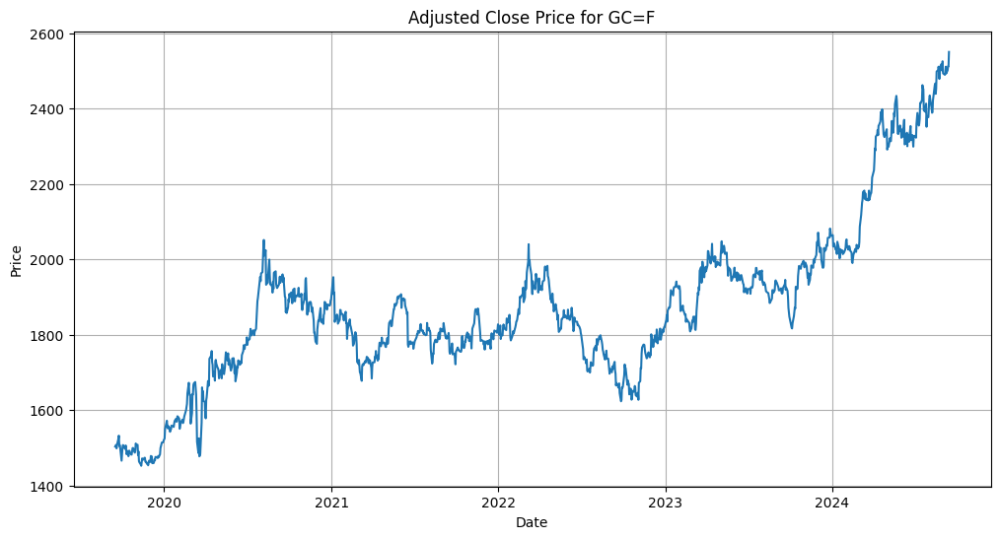

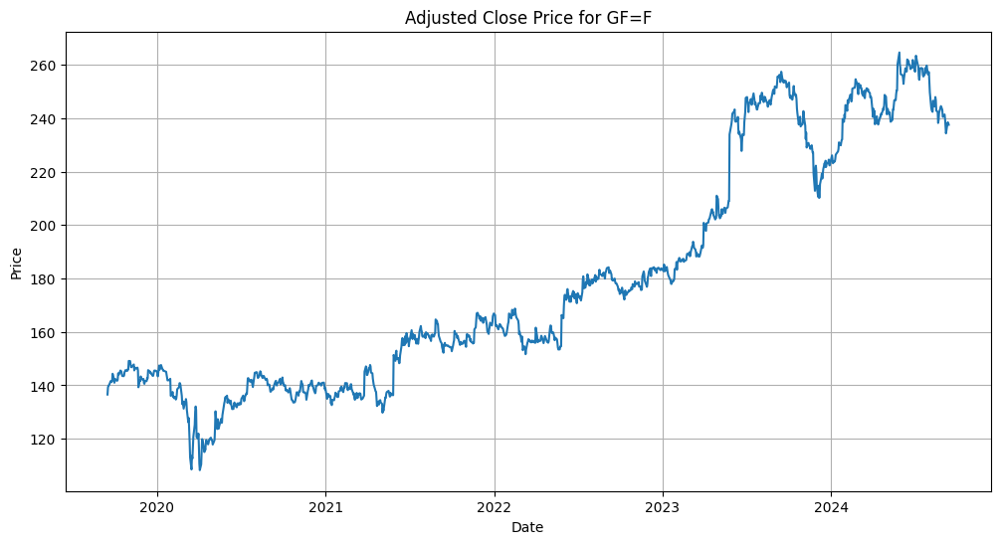

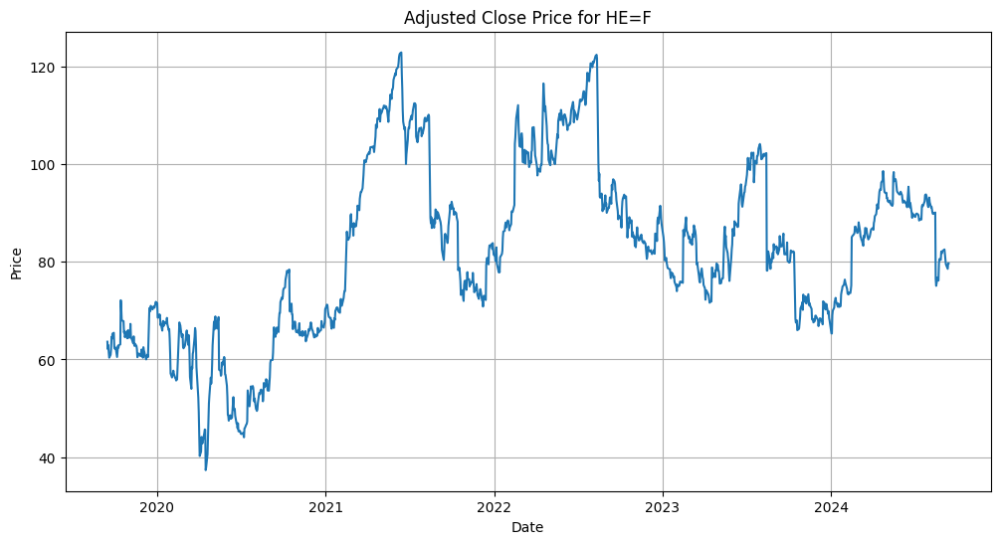

...

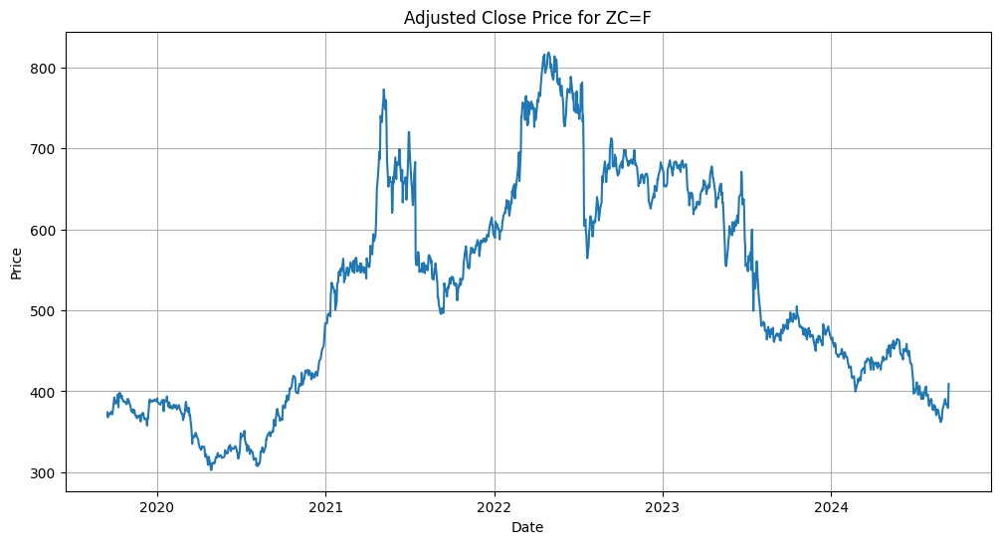

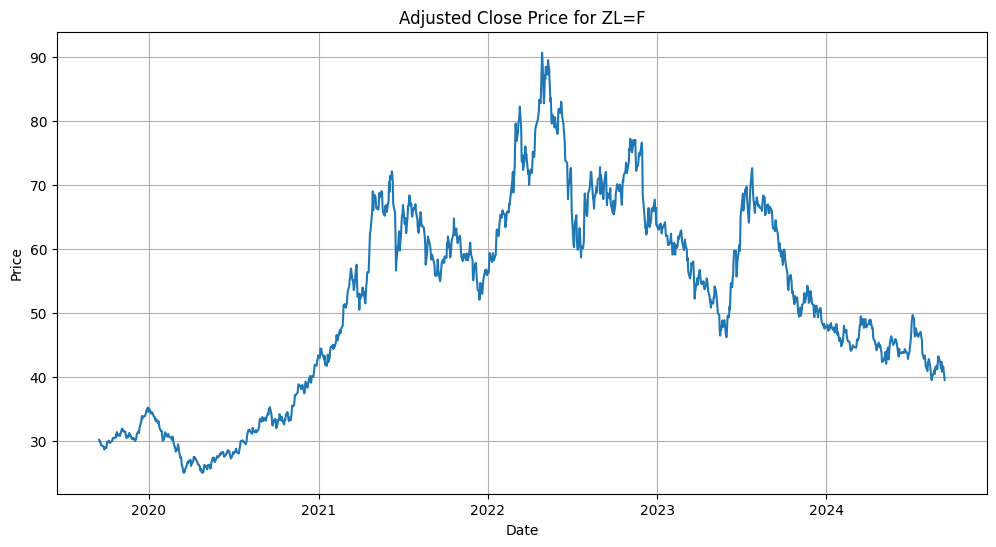

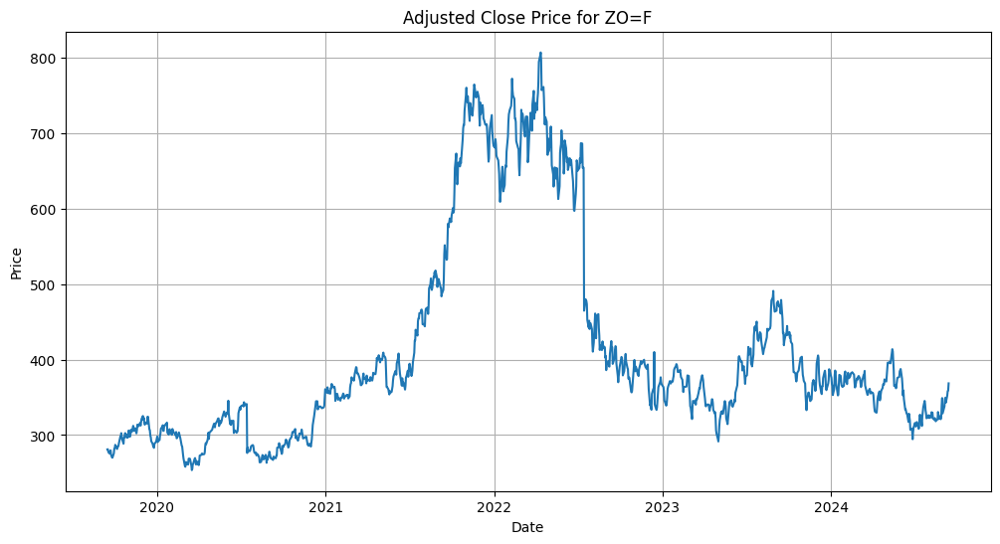

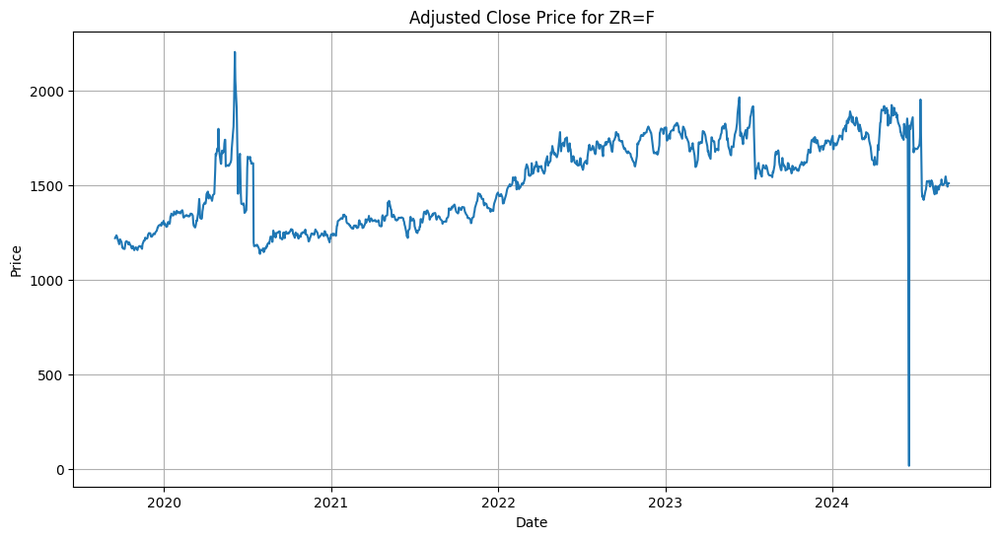

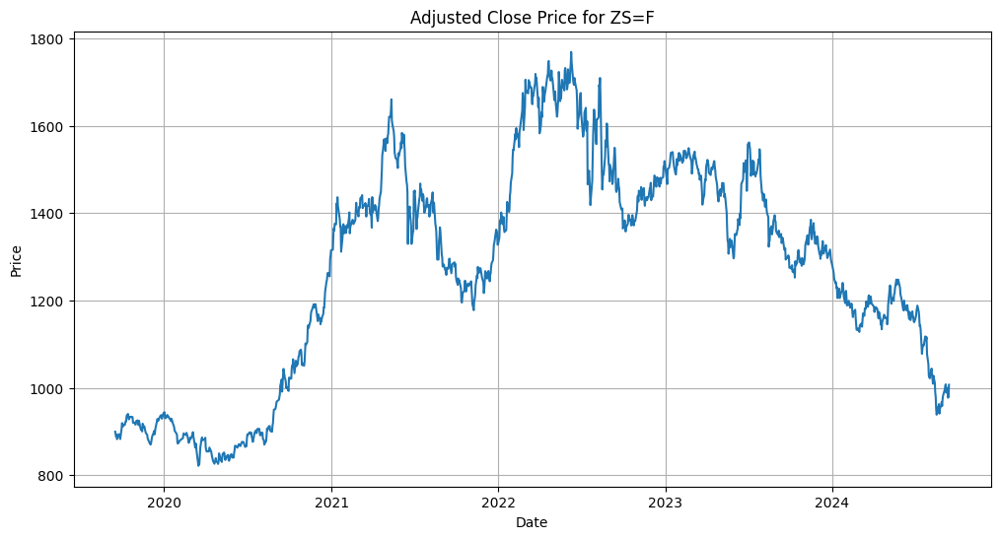

In [6]:
# Plot the adjusted close price for each commodity
for ticker in data.columns:
  plt.figure(figsize=(12, 6))
  plt.plot(data[ticker])
  plt.title(f'Adjusted Close Price for {ticker}')
  plt.xlabel('Date')
  plt.ylabel('Price')
  plt.grid(True)
  plt.show()


In [7]:
# Calculate the daily returns as a percentage
returns = data.pct_change().dropna()*100

# Print the returns DataFrame
print(returns)


Ticker                          CC=F      CL=F      GC=F      GF=F      HE=F  \
Date                                                                           
2019-09-17 00:00:00+00:00   0.461603 -5.659779  0.133058  1.922373 -2.396859   
2019-09-18 00:00:00+00:00   0.292398 -2.072800  0.159459  0.502962  1.328504   
2019-09-19 00:00:00+00:00   2.790504  0.034418 -0.603647  0.053617 -2.423516   
2019-09-20 00:00:00+00:00   0.202593 -0.068813  0.593969  0.267953 -1.710103   
2019-09-23 00:00:00+00:00  -0.768298  0.946805  1.088032  0.908612  0.994204   
...                              ...       ...       ...       ...       ...   
2024-09-06 00:00:00+00:00  -0.838662 -2.140280 -0.712746 -1.191353 -1.486985   
2024-09-09 00:00:00+00:00   4.017338  1.536871  0.332867  1.461802 -0.880499   
2024-09-10 00:00:00+00:00  -1.880272 -4.307960  0.419698  0.315491 -0.317259   
2024-09-11 00:00:00+00:00   4.775223  2.372620 -0.007959 -0.398370  1.432209   
2024-09-12 00:00:00+00:00 -25.684627  1.

In [8]:
# Calculate the log returns for each commodity using np.log(close/close).shift(1)

log_returns = np.log(data / data.shift(1)).dropna()
print(log_returns)


Ticker                         CC=F      CL=F      GC=F      GF=F      HE=F  \
Date                                                                          
2019-09-17 00:00:00+00:00  0.004605 -0.058263  0.001330  0.019041 -0.024261   
2019-09-18 00:00:00+00:00  0.002920 -0.020946  0.001593  0.005017  0.013198   
2019-09-19 00:00:00+00:00  0.027523  0.000344 -0.006055  0.000536 -0.024534   
2019-09-20 00:00:00+00:00  0.002024 -0.000688  0.005922  0.002676 -0.017249   
2019-09-23 00:00:00+00:00 -0.007713  0.009424  0.010822  0.009045  0.009893   
...                             ...       ...       ...       ...       ...   
2024-09-06 00:00:00+00:00 -0.008422 -0.021635 -0.007153 -0.011985 -0.014982   
2024-09-09 00:00:00+00:00  0.039387  0.015252  0.003323  0.014512 -0.008844   
2024-09-10 00:00:00+00:00 -0.018982 -0.044035  0.004188  0.003150 -0.003178   
2024-09-11 00:00:00+00:00  0.046647  0.023449 -0.000080 -0.003992  0.014220   
2024-09-12 00:00:00+00:00 -0.296852  0.014162  0.015

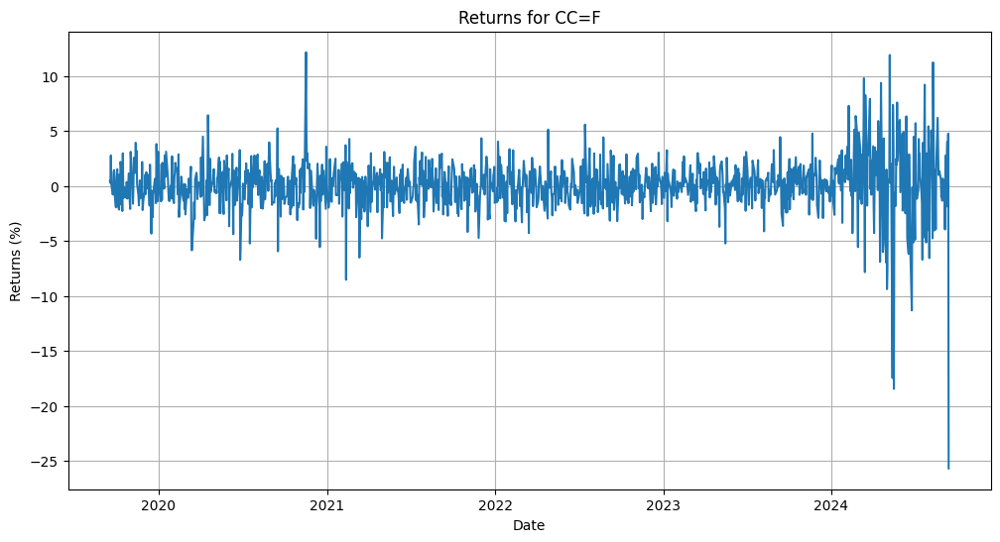

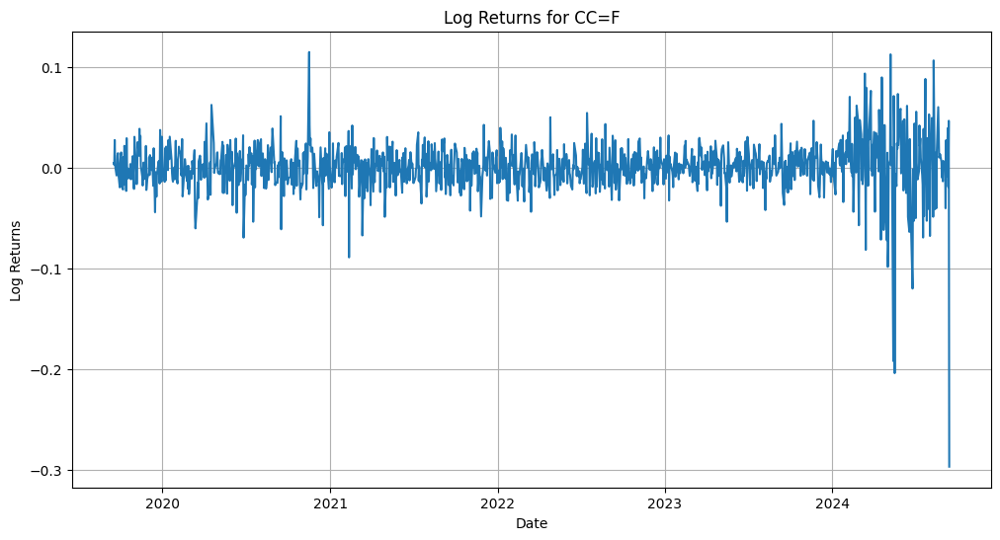

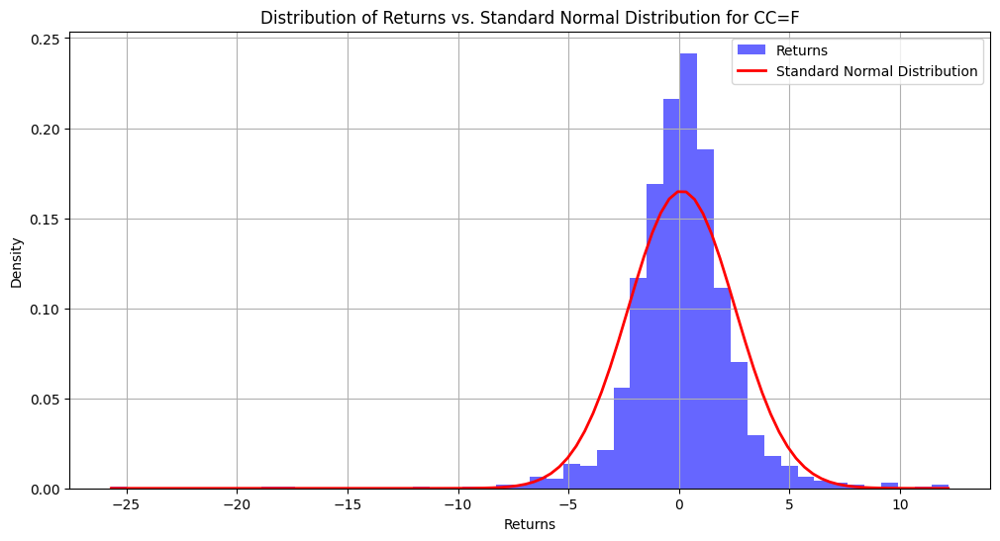

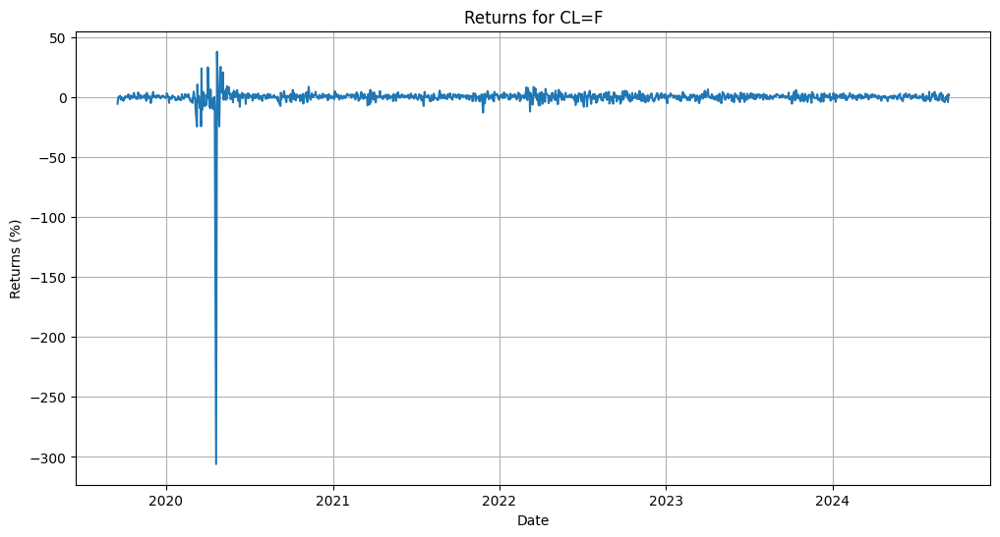

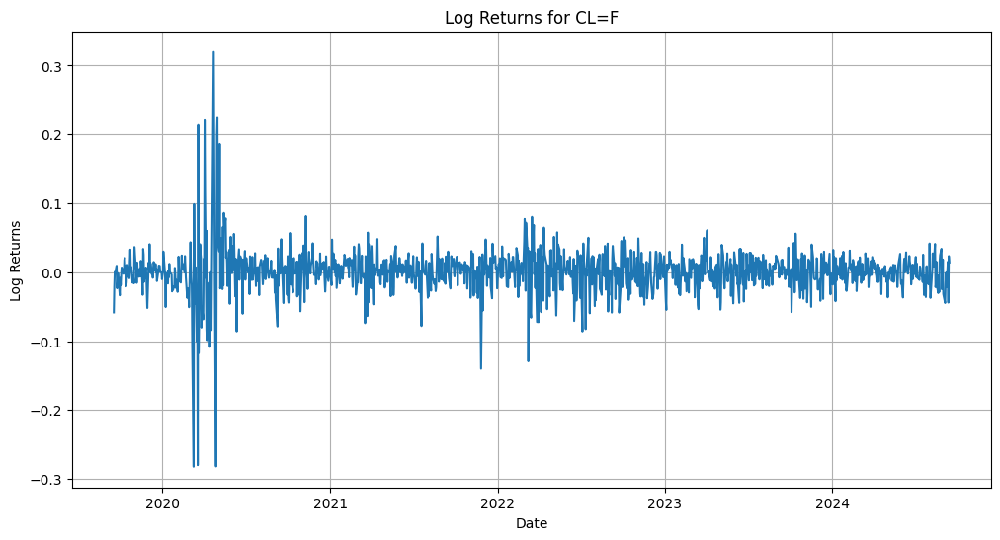

...

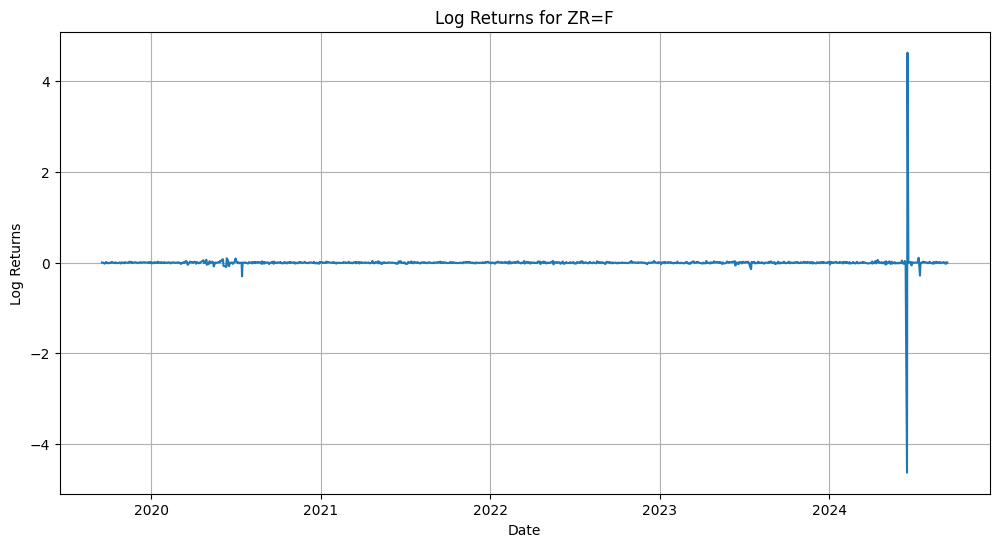

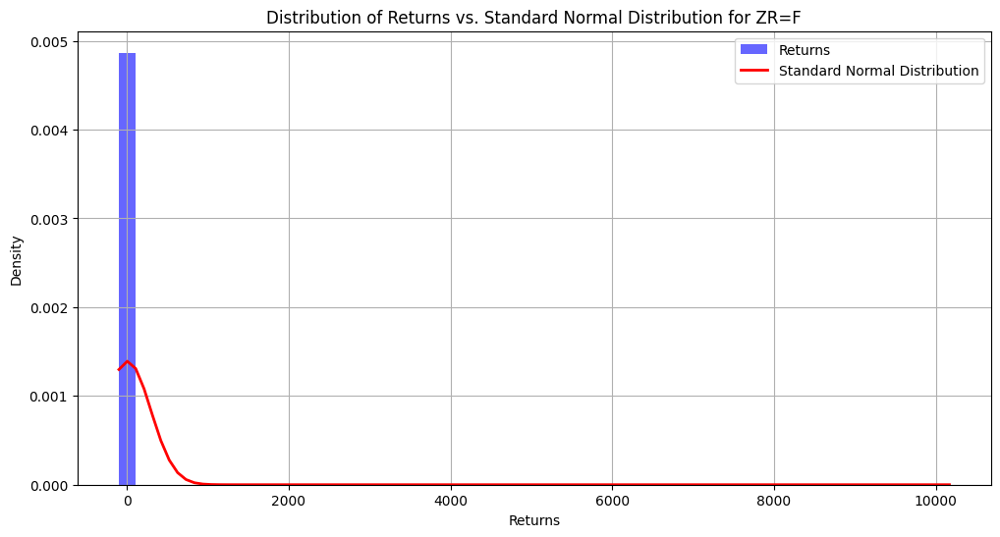

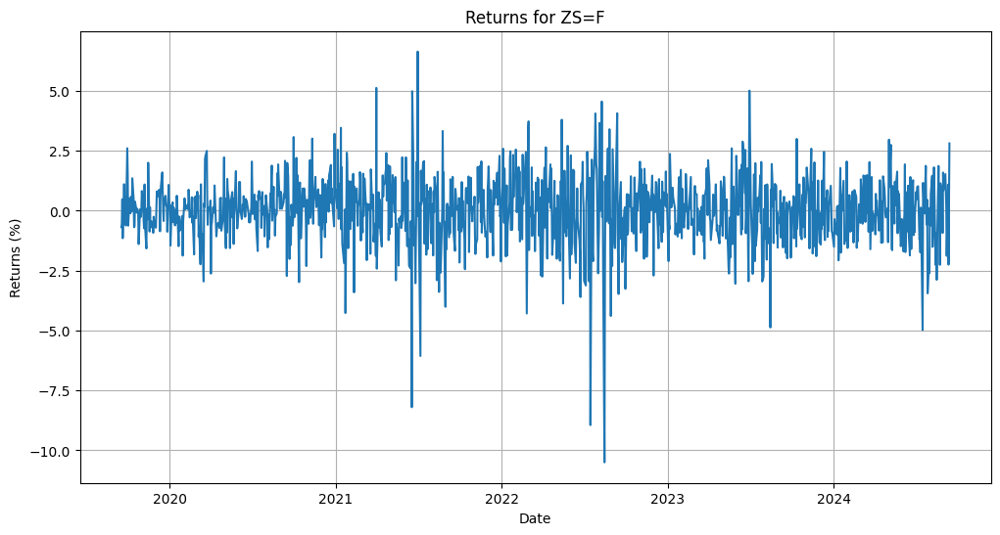

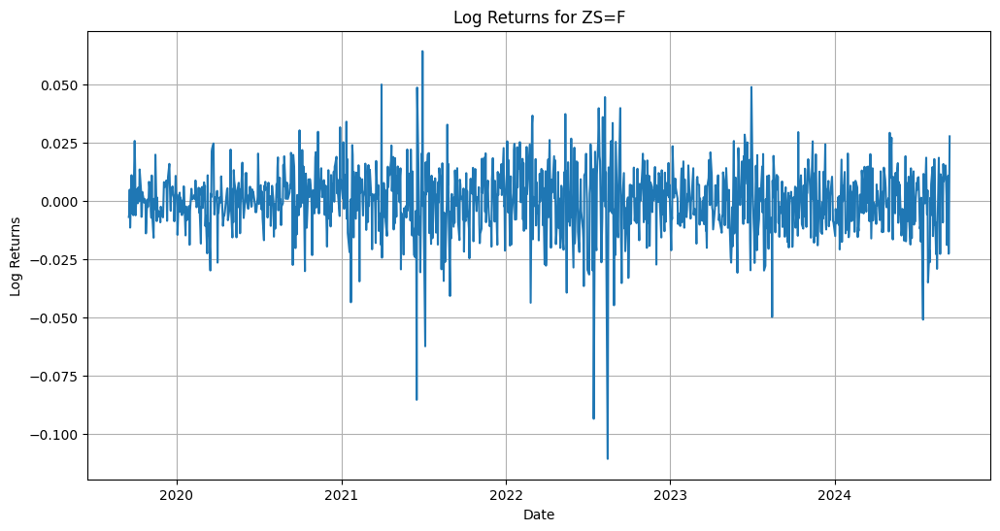

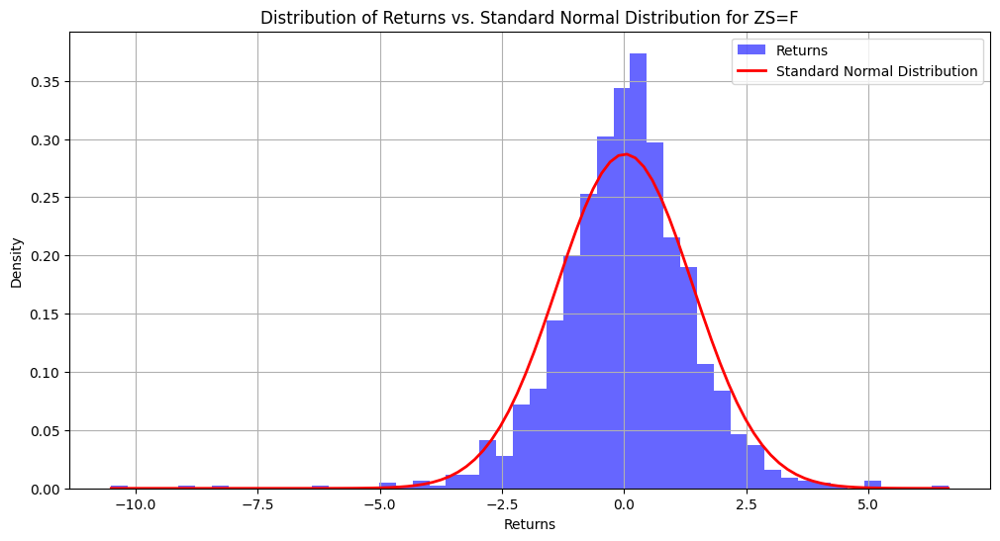

In [9]:
# Plot the returns, log returns and the distribution of returns for each commodity, compare with normal distrbution
for ticker in returns.columns:
  # Plot returns
  plt.figure(figsize=(12, 6))
  plt.plot(returns[ticker])
  plt.title(f'Returns for {ticker}')
  plt.xlabel('Date')
  plt.ylabel('Returns (%)')
  plt.grid(True)
  plt.show()

  # Plot log returns
  plt.figure(figsize=(12, 6))
  plt.plot(log_returns[ticker])
  plt.title(f'Log Returns for {ticker}')
  plt.xlabel('Date')
  plt.ylabel('Log Returns')
  plt.grid(True)
  plt.show()

  # Compare the distribution of returns with the standard normal distribution
  plt.figure(figsize=(12, 6))
  plt.hist(returns[ticker], bins=50, density=True, alpha=0.6, color='blue', label='Returns')
  # Generate a standard normal distribution
  x = np.linspace(returns[ticker].min(), returns[ticker].max(), 100)
  plt.plot(x, stats.norm.pdf(x, loc=returns[ticker].mean(), scale=returns[ticker].std()), 'r-', lw=2, label='Standard Normal Distribution')
  plt.title(f'Distribution of Returns vs. Standard Normal Distribution for {ticker}')
  plt.xlabel('Returns')
  plt.ylabel('Density')
  plt.legend()
  plt.grid(True)
  plt.show()


In [10]:
# For each commodity in the returns and log_returns data apply the describe function and show the results in a dataframe

# Create empty dictionaries to store the descriptive statistics for returns and log_returns
returns_stats = {}
log_returns_stats = {}

# Loop through each commodity
for ticker in returns.columns:
  # Calculate descriptive statistics for returns and store in the dictionary
  returns_stats[ticker] = returns[ticker].describe()

  # Calculate descriptive statistics for log_returns and store in the dictionary
  log_returns_stats[ticker] = log_returns[ticker].describe()

# Convert the dictionaries to pandas DataFrames
returns_stats_df = pd.DataFrame(returns_stats).T
log_returns_stats_df = pd.DataFrame(log_returns_stats).T

# Print the DataFrames
print("Descriptive Statistics for Returns:")
print(returns_stats_df)

print("\nDescriptive Statistics for Log Returns:")
print(log_returns_stats_df)


Descriptive Statistics for Returns:
        count      mean         std         min       25%       50%       75%  \
CC=F   1257.0  0.121400    2.415321  -25.684627 -1.036484  0.173430  1.284722   
CL=F   1257.0 -0.233169    9.937975 -305.966065 -1.380353  0.197935  1.530186   
GC=F   1257.0  0.047166    1.008953   -4.978726 -0.438676  0.053466  0.605274   
GF=F   1257.0  0.051386    1.218644   -7.798168 -0.536535  0.013585  0.557207   
HE=F   1257.0  0.056917    2.774261  -23.520785 -0.884754  0.000000  0.959534   
HG=F   1257.0  0.049026    1.495883   -6.694017 -0.871245  0.052829  1.006032   
KC=F   1257.0  0.097846    2.276911   -8.625953 -1.340209  0.000000  1.509845   
KE=F   1257.0  0.052052    2.110372   -8.029801 -1.269316  0.000000  1.284404   
LE=F   1257.0  0.053504    1.141660   -6.027024 -0.386429  0.062406  0.539754   
MGC=F  1257.0  0.047094    1.011344   -4.985394 -0.439646  0.060196  0.606806   
NG=F   1257.0  0.094564    4.678707  -25.953710 -2.635137  0.000000  2.66

In [11]:
# Define a function to determine the realised volatility
def realised_volatility_daily(series_log_return):
    """
    Get the daily realized volatility which is calculated as the square root
    of sum of squares of log returns within a specific window interval
    """
    n = len(series_log_return)
    return np.sqrt(np.sum(series_log_return**2)/(n - 1))

In [12]:
# Get the Realised volatilities over weekly, monthly, bi annually and annually and store as a dataframe
# Create an empty dictionary to store the realised volatility data
realised_volatility_data = {}

# Loop through each commodity
for ticker in log_returns.columns:
  # Create an empty dictionary to store the realised volatility for different windows
  realised_volatility_ticker = {}

  # Calculate realised volatility for different windows
  for window in [5, 22, 126, 252]:
    realised_volatility_ticker[f'{window}_day_volatility'] = log_returns[ticker].rolling(window=window).apply(realised_volatility_daily, raw=True)

  # Store the realised volatility data for the ticker in the main dictionary
  realised_volatility_data[ticker] = pd.DataFrame(realised_volatility_ticker)


# Convert the dictionary to a pandas DataFrame
realised_volatility_df = pd.concat(realised_volatility_data, axis=1, keys=realised_volatility_data.keys())

# Print the DataFrame
print(realised_volatility_df)


                                      CC=F                    \
                          5_day_volatility 22_day_volatility   
Date                                                           
2019-09-17 00:00:00+00:00              NaN               NaN   
2019-09-18 00:00:00+00:00              NaN               NaN   
2019-09-19 00:00:00+00:00              NaN               NaN   
2019-09-20 00:00:00+00:00              NaN               NaN   
2019-09-23 00:00:00+00:00         0.014584               NaN   
...                                    ...               ...   
2024-09-06 00:00:00+00:00         0.024910          0.036150   
2024-09-09 00:00:00+00:00         0.031570          0.035942   
2024-09-10 00:00:00+00:00         0.032965          0.034585   
2024-09-11 00:00:00+00:00         0.035016          0.027541   
2024-09-12 00:00:00+00:00         0.151888          0.069814   

                                                                 \
                          126_day_vo

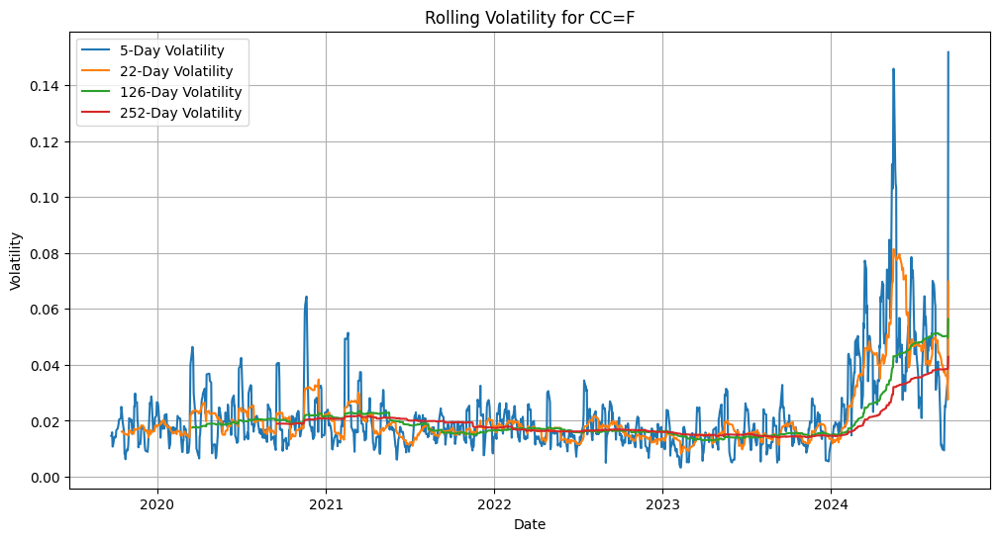

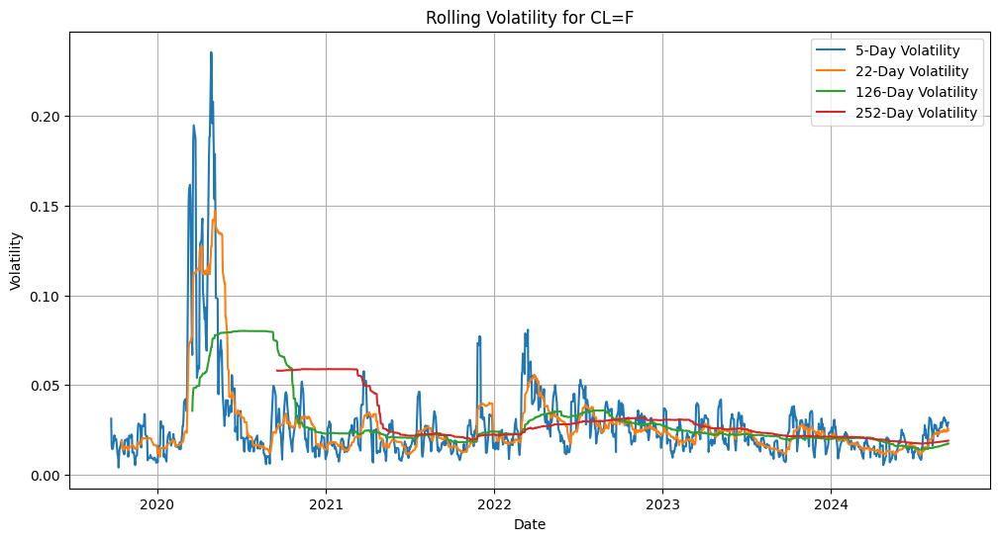

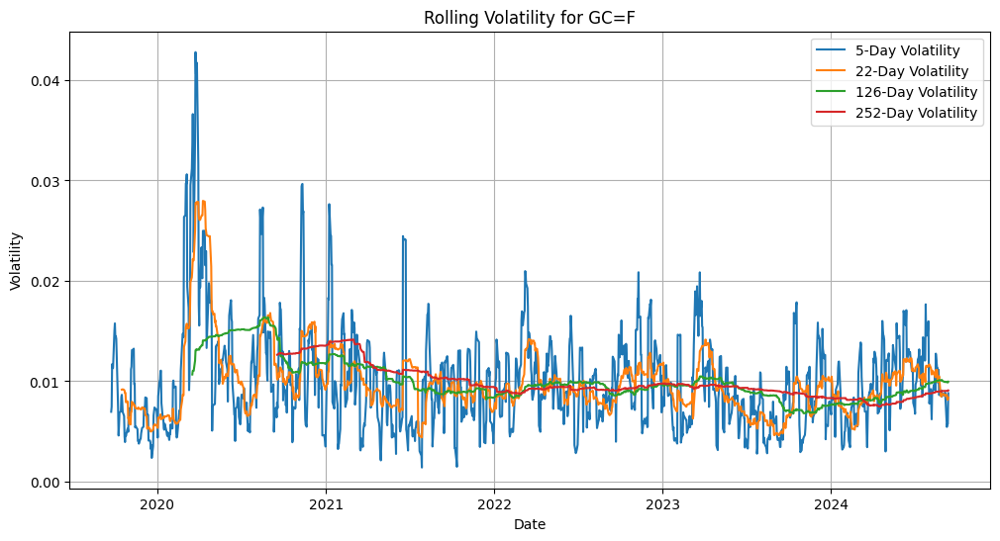

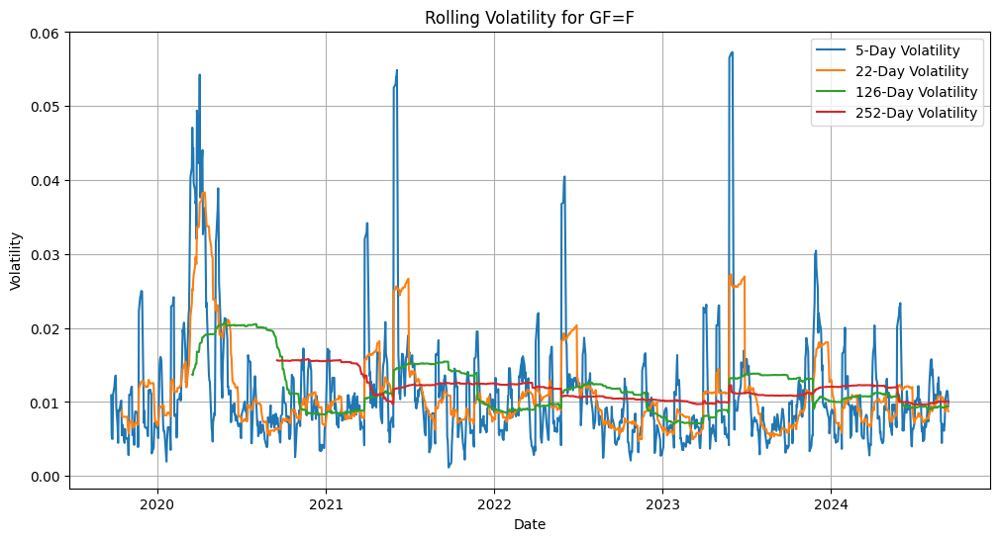

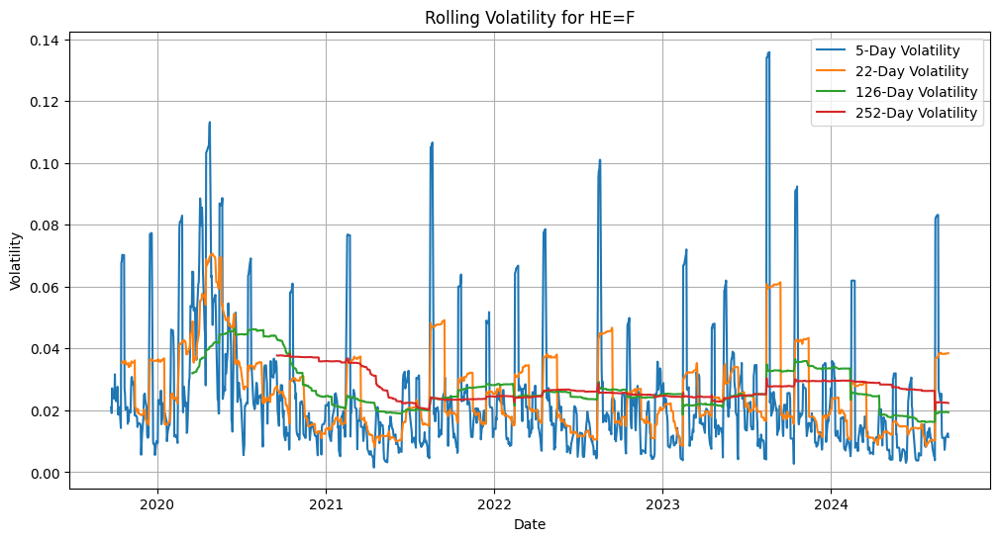

...

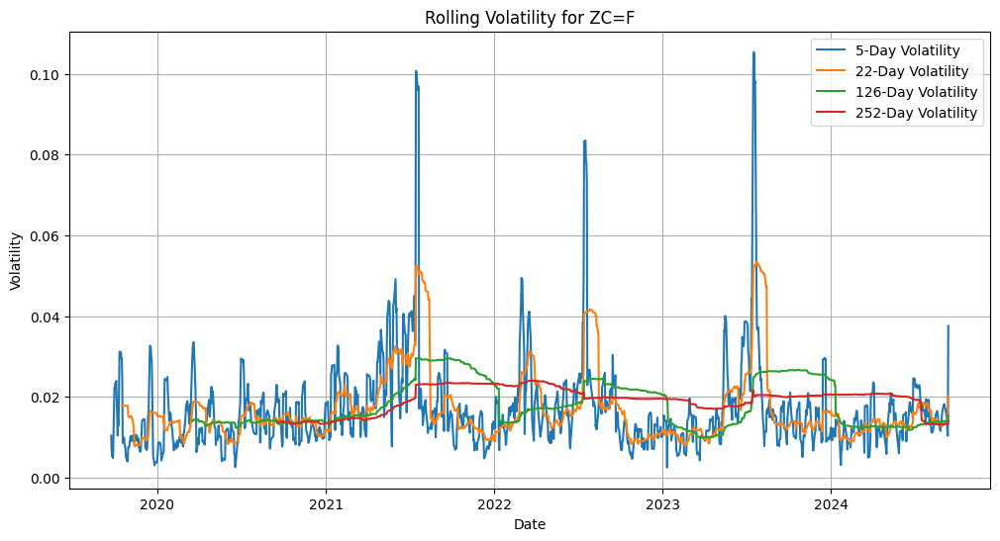

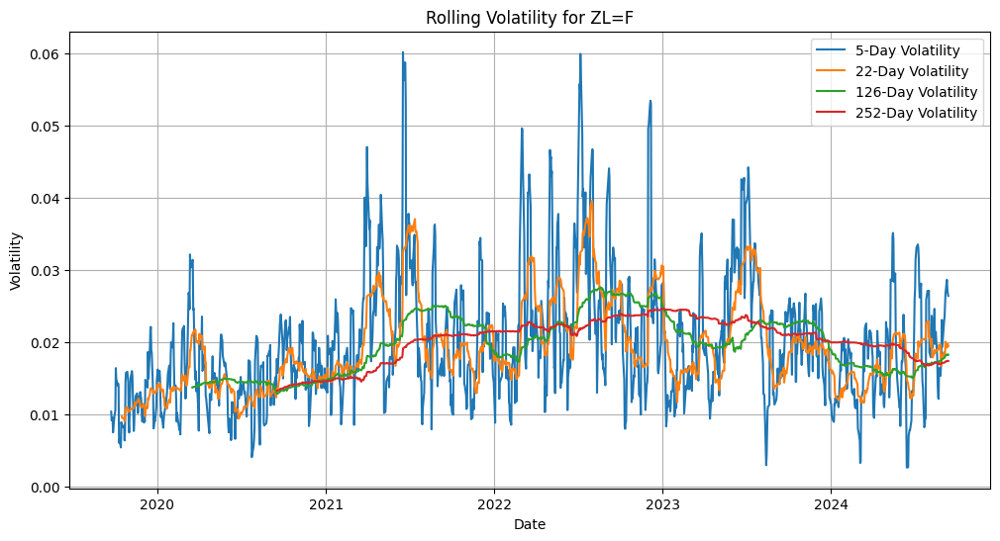

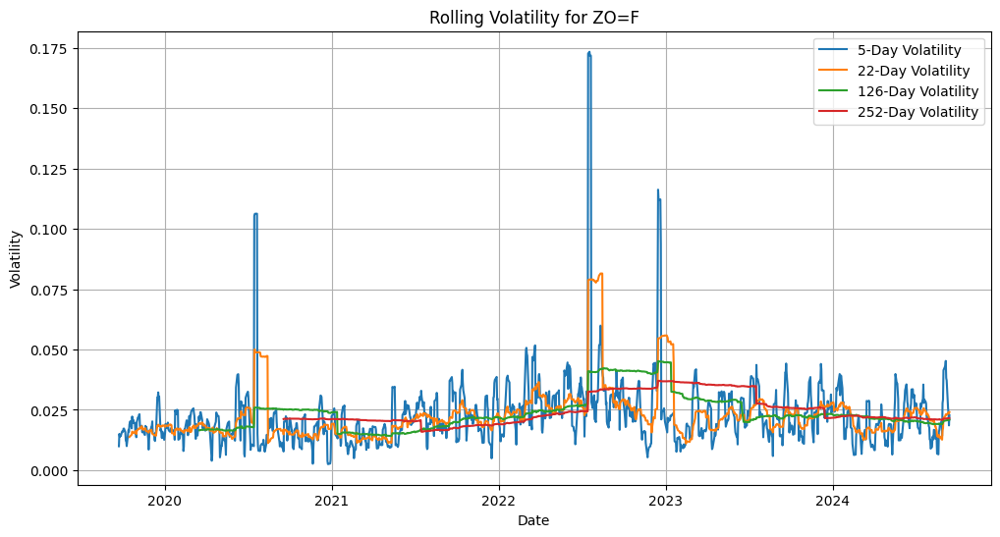

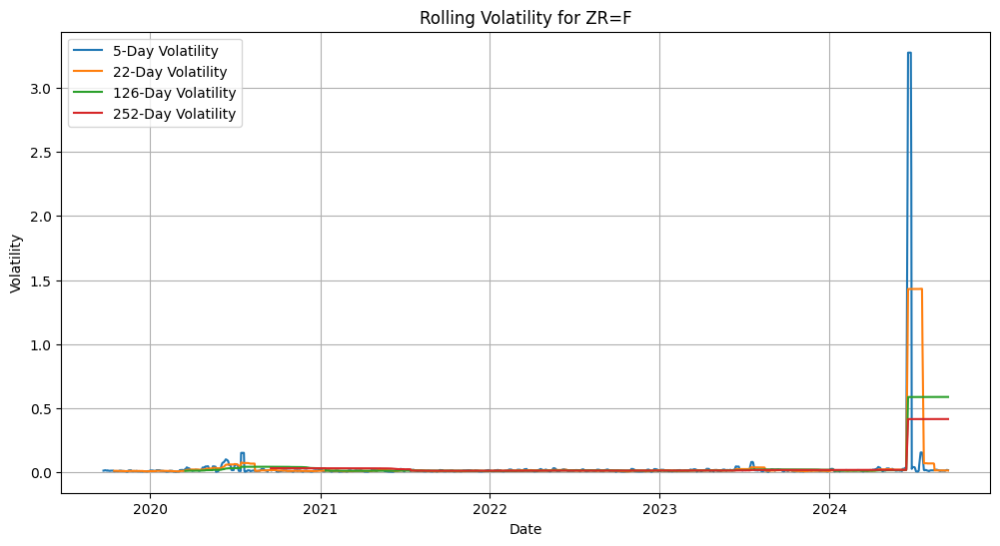

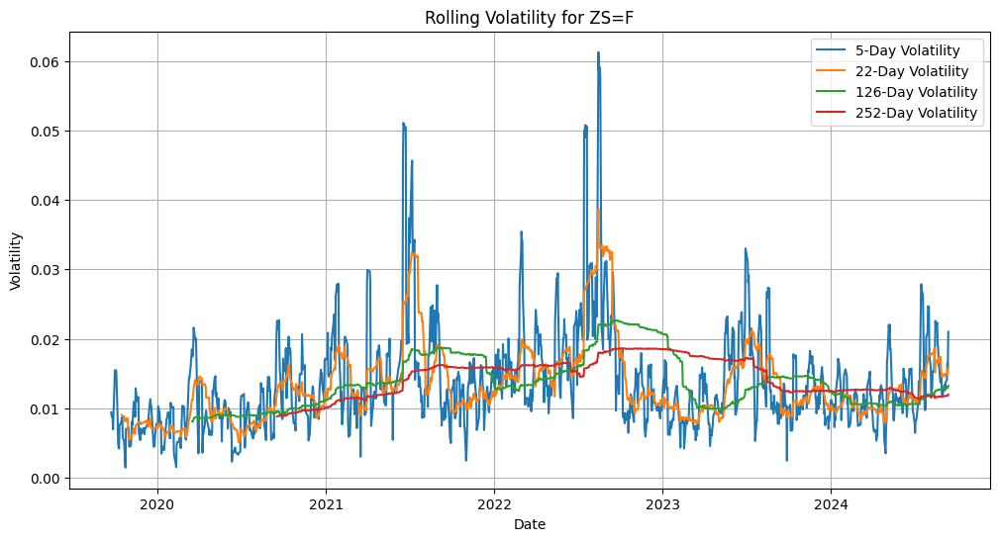

In [13]:
# Plot the realised volatilities for each commodity over the window periods
for ticker in log_returns.columns:
  plt.figure(figsize=(12, 6))
  plt.plot(realised_volatility_df[(ticker, '5_day_volatility')], label='5-Day Volatility')
  plt.plot(realised_volatility_df[(ticker, '22_day_volatility')], label='22-Day Volatility')
  plt.plot(realised_volatility_df[(ticker, '126_day_volatility')], label='126-Day Volatility')
  plt.plot(realised_volatility_df[(ticker, '252_day_volatility')], label='252-Day Volatility')
  plt.title(f'Rolling Volatility for {ticker}')
  plt.xlabel('Date')
  plt.ylabel('Volatility')
  plt.legend()
  plt.grid(True)
  plt.show()


We use the monthly day window as the weekly seems too noisy to observe meaningful patterns whilst longer periods seem to smmoth the volatility down significantly and tend to revert to the mean.

In [14]:
# Get the backward looking realised volatility
# Create an empty dictionary to store the backward looking realised volatility data
vol_back_data = {}

# Loop through each commodity
for ticker in log_returns.columns:
  # Calculate backward looking realised volatility using a 22-day window
  vol_back_data[ticker] = log_returns[ticker].rolling(window=22).apply(realised_volatility_daily, raw=True)

# Convert the dictionary to a pandas DataFrame
vol_back_df = pd.DataFrame(vol_back_data)



In [15]:
# Drop the rows containing NaNs from the vol_back_dr
vol_back_df.dropna(inplace=True)
vol_back_df.head()



,CC=F,CL=F,GC=F,GF=F,HE=F,HG=F,KC=F,KE=F,LE=F,MGC=F,...,PL=F,RB=F,SB=F,SI=F,SIL=F,ZC=F,ZL=F,ZO=F,ZR=F,ZS=F
Date,,,,,,,,,,,,,,,,,,,,,
2019-10-16 00:00:00+00:00,0.016127,0.019349,0.009159,0.008892,0.035386,0.006818,0.014934,0.014529,0.010045,0.009156,...,0.014891,0.017980,0.021948,0.017850,0.017850,0.017973,0.009686,0.013724,0.009798,0.009049
2019-10-17 00:00:00+00:00,0.016267,0.014769,0.009176,0.008012,0.035843,0.006780,0.012217,0.014424,0.009591,0.009173,...,0.014858,0.015049,0.021833,0.017945,0.017945,0.017702,0.009454,0.013990,0.009742,0.008958
2019-10-18 00:00:00+00:00,0.016255,0.014057,0.009189,0.008007,0.035733,0.007397,0.013829,0.013907,0.010059,0.009187,...,0.014712,0.014875,0.021847,0.017747,0.017747,0.017720,0.009455,0.014115,0.009831,0.008893
2019-10-21 00:00:00+00:00,0.015142,0.014187,0.009133,0.008007,0.035332,0.007434,0.013497,0.014524,0.010024,0.009121,...,0.014629,0.013950,0.021864,0.017747,0.017747,0.017823,0.009484,0.014736,0.010009,0.008834
2019-10-22 00:00:00+00:00,0.015310,0.014600,0.009042,0.007997,0.035946,0.007511,0.014651,0.014649,0.010199,0.009037,...,0.014659,0.013651,0.021833,0.017777,0.017777,0.017789,0.009031,0.015949,0.010125,0.008468


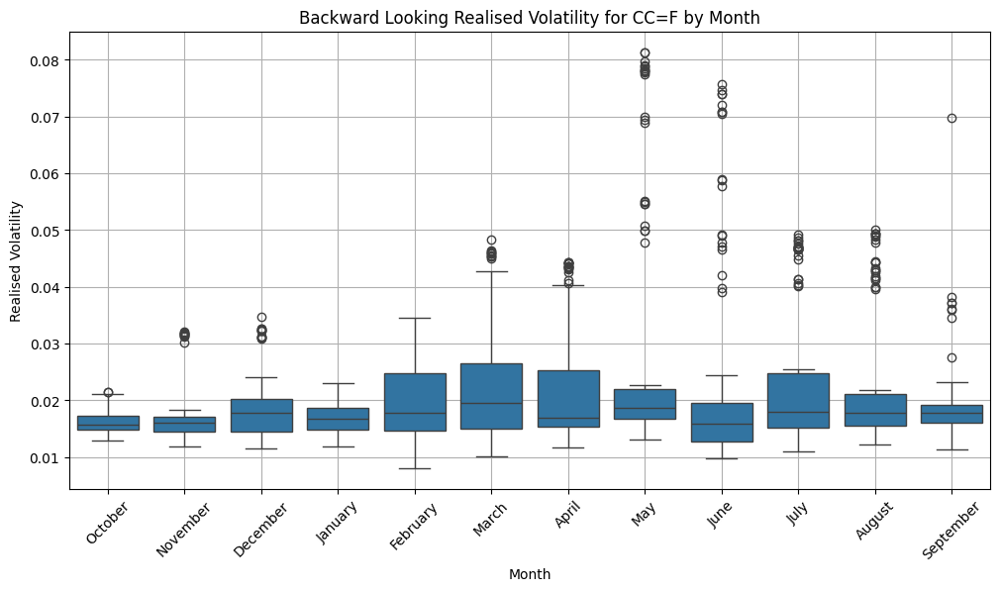

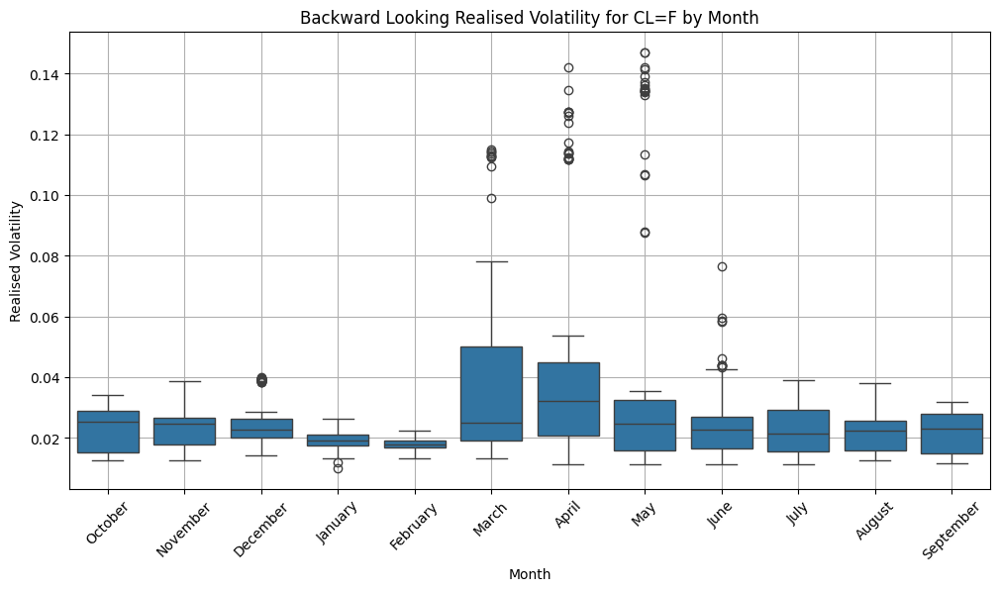

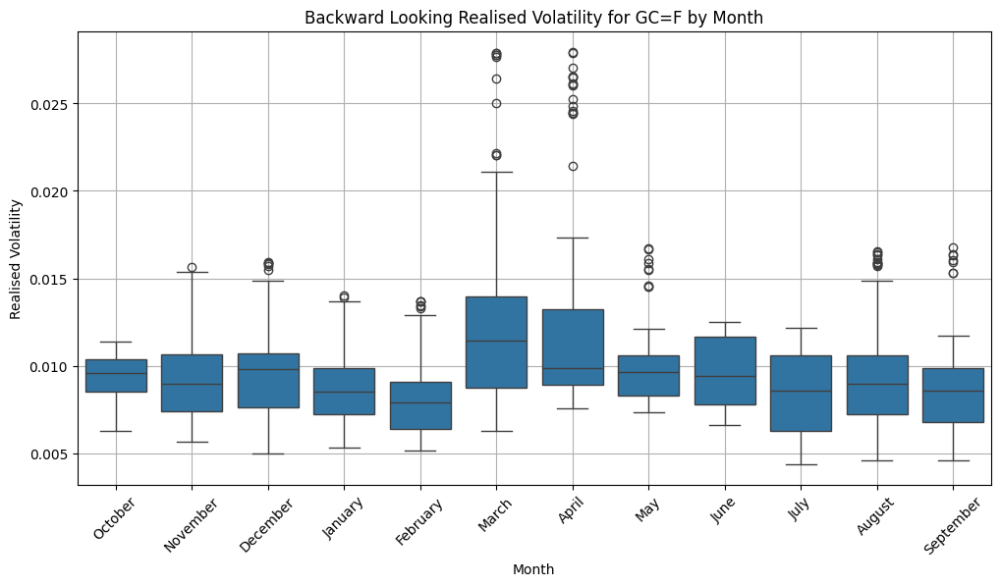

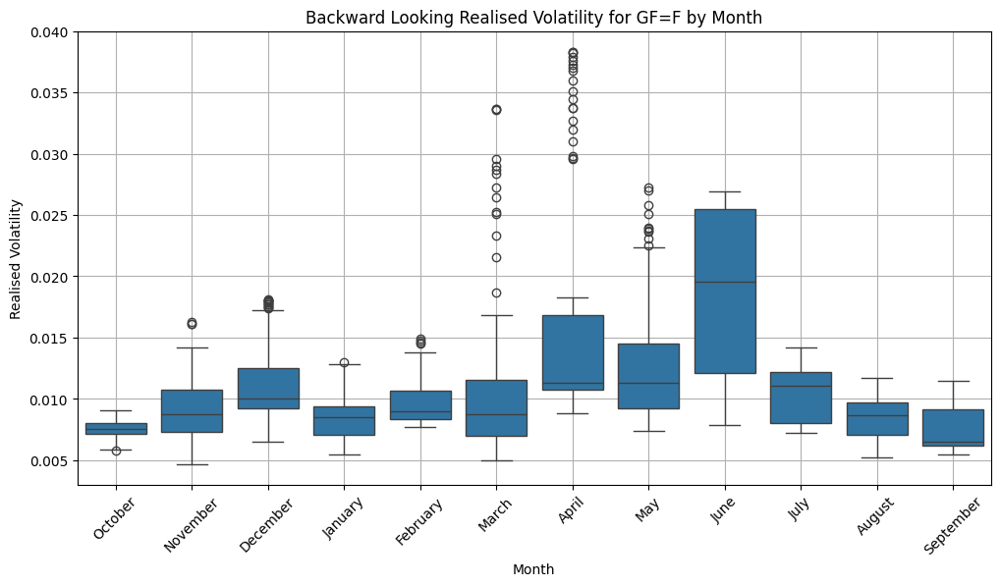

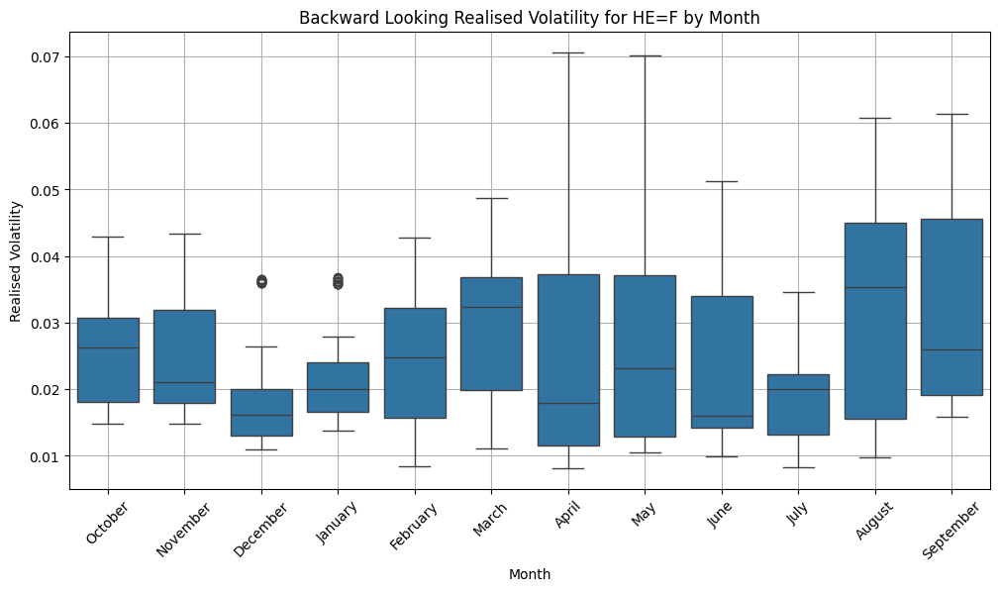

...

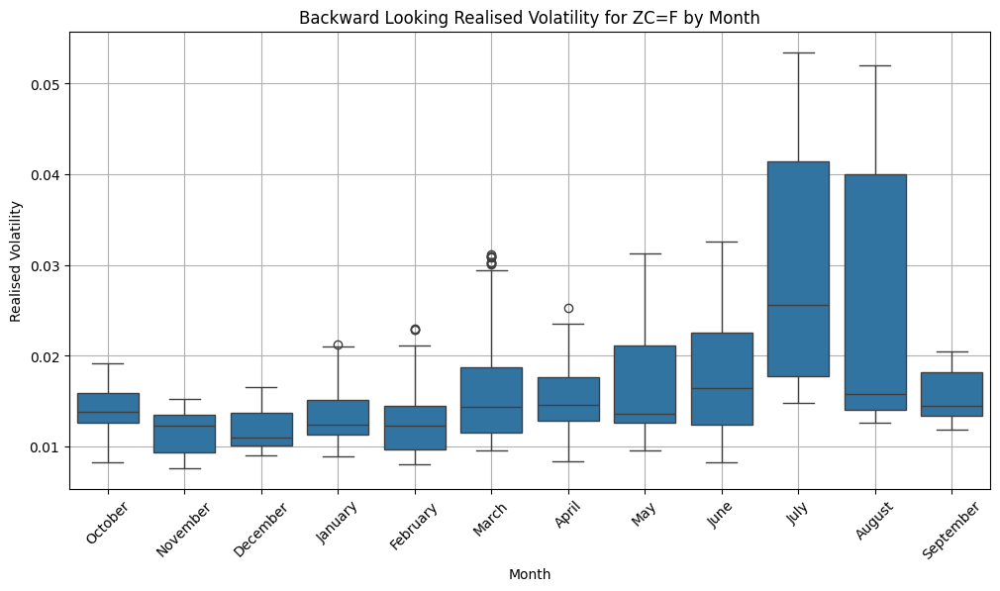

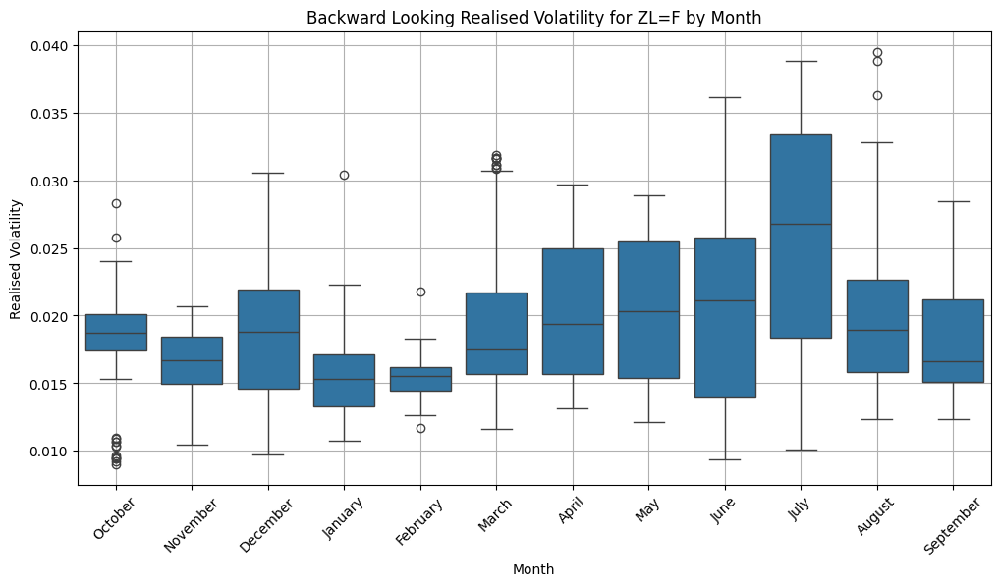

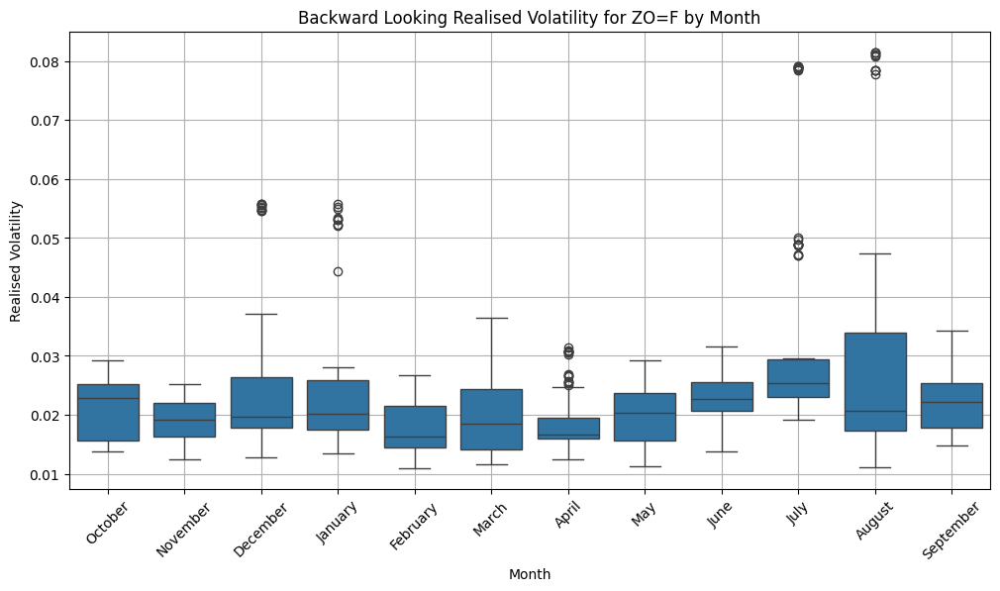

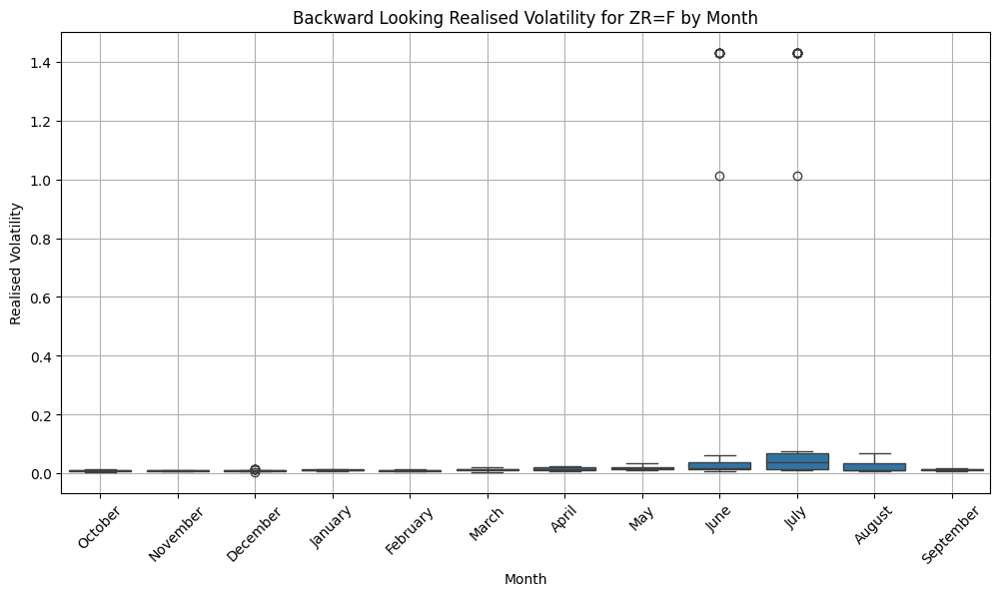

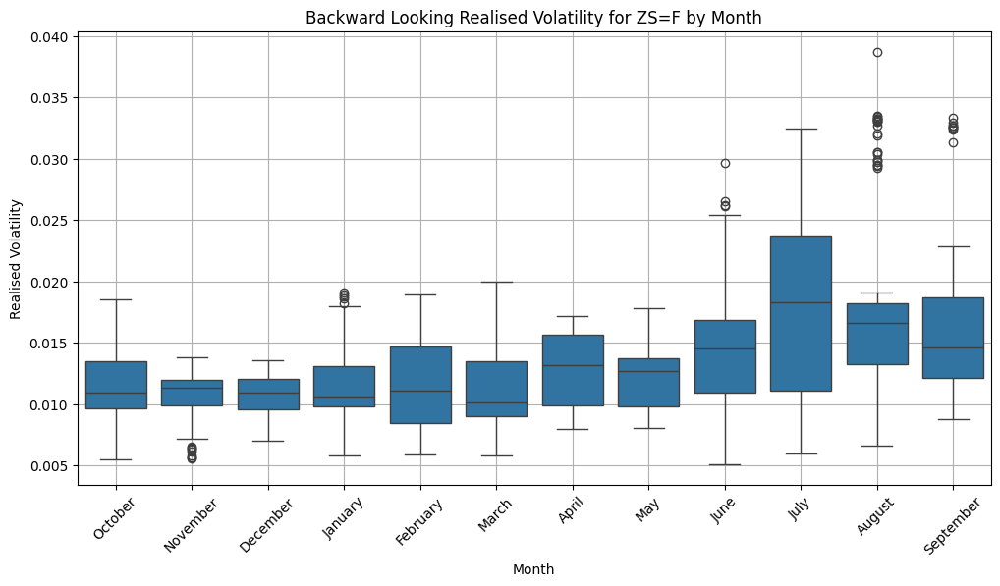

In [16]:
# We want to view the distribution of volatilities for each month
# Create a new column with the month name
vol_back_df['Month'] = vol_back_df.index.month_name()

# Group the data by month and commodity
grouped_data = vol_back_df.groupby(['Month'])

# Create a boxplot for each commodity
for ticker in vol_back_df.columns[:-1]:
  plt.figure(figsize=(12, 6))
  sns.boxplot(x='Month', y=ticker, data=vol_back_df)
  plt.title(f'Backward Looking Realised Volatility for {ticker} by Month')
  plt.xlabel('Month')
  plt.ylabel('Realised Volatility')
  plt.xticks(rotation=45)
  plt.grid(True)
  plt.show()


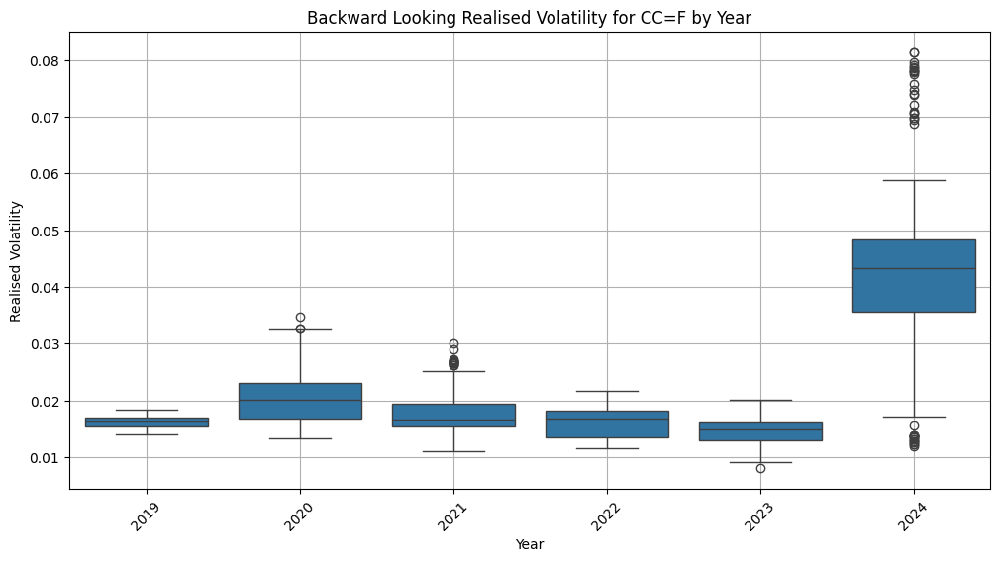

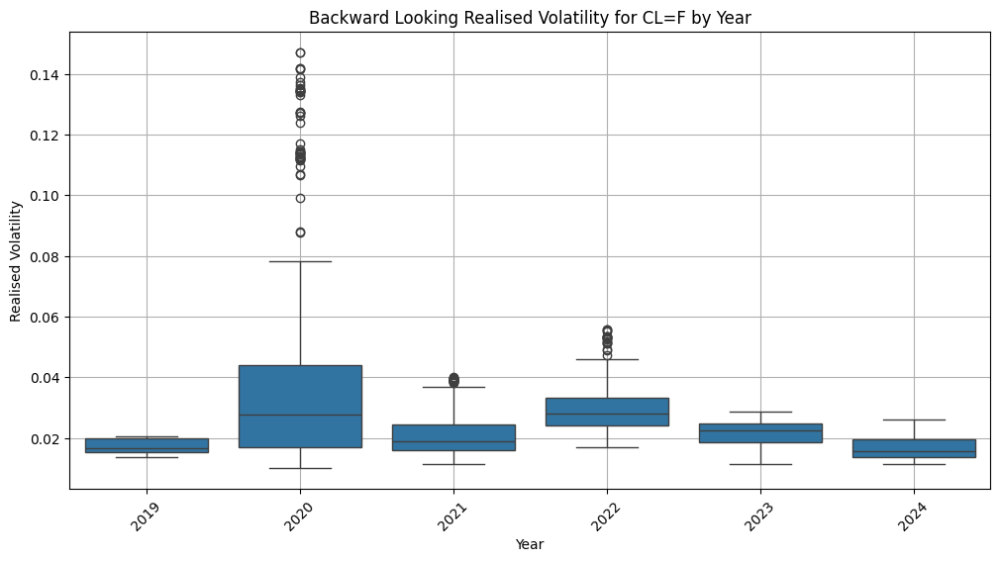

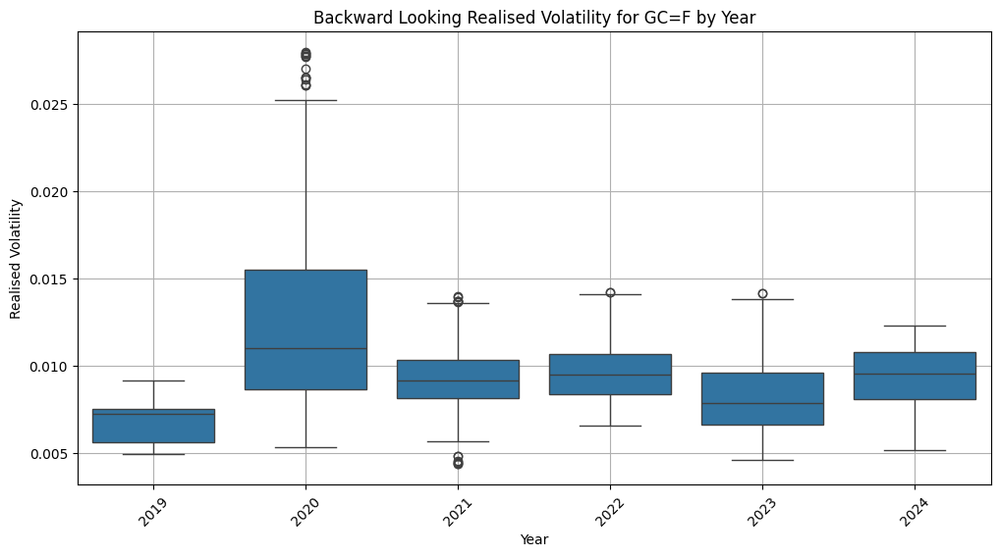

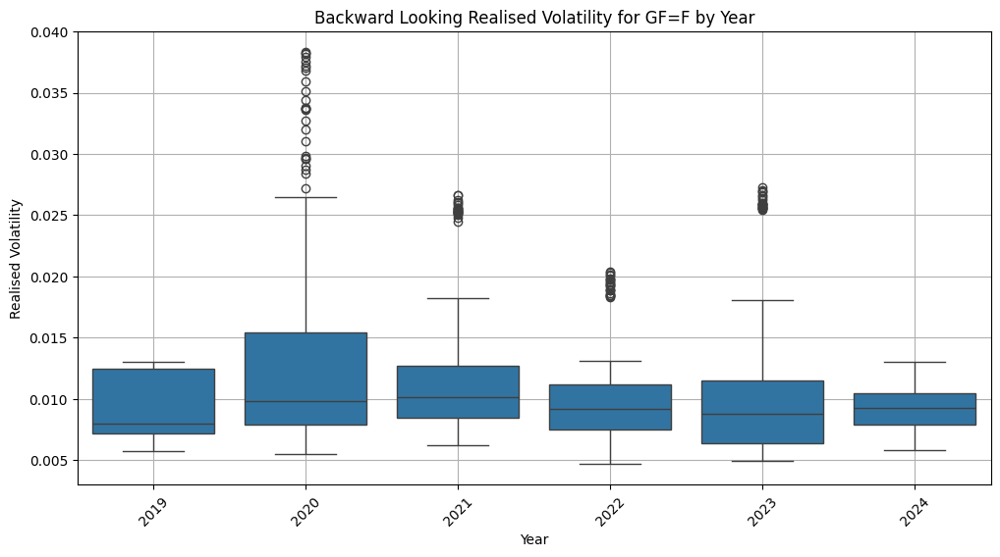

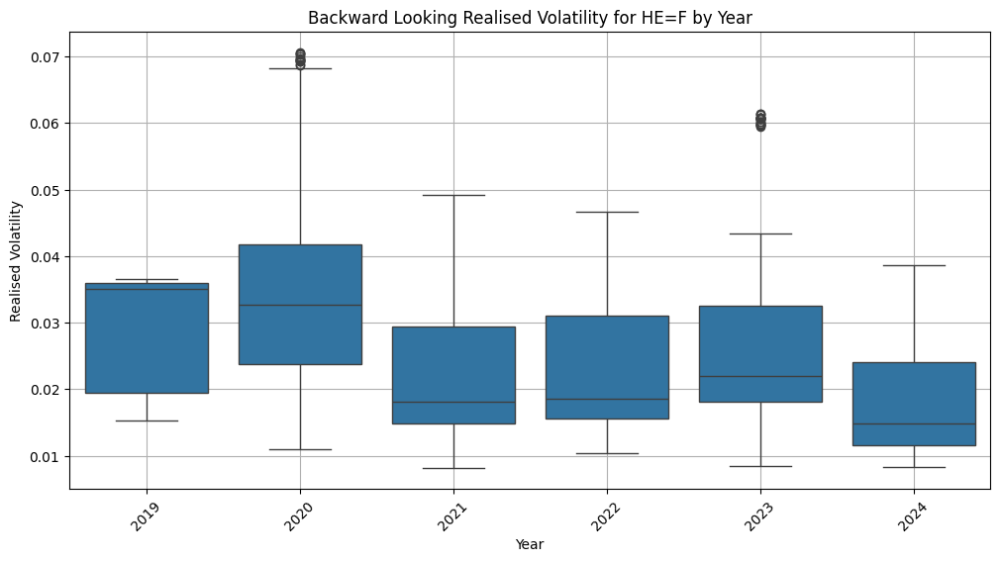

...

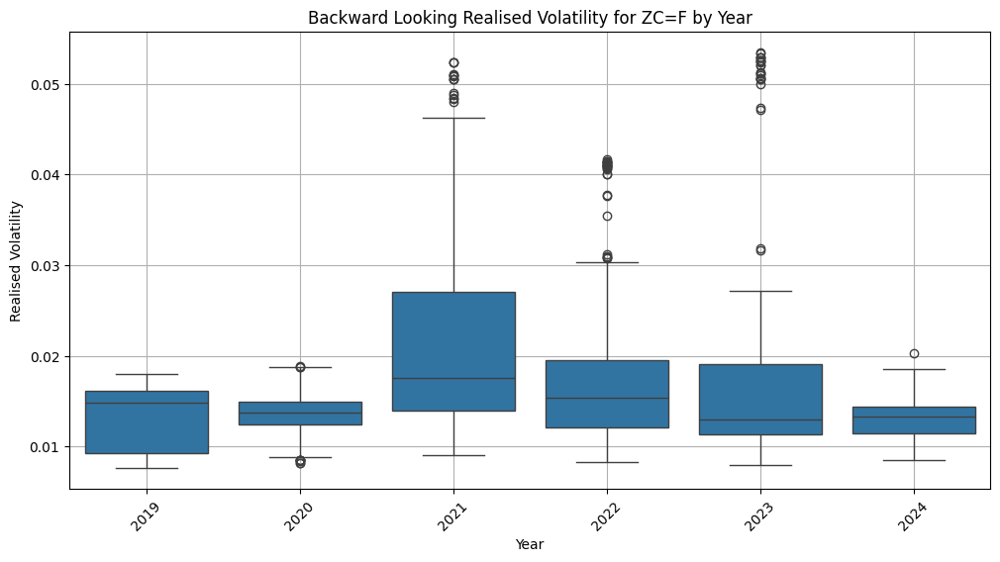

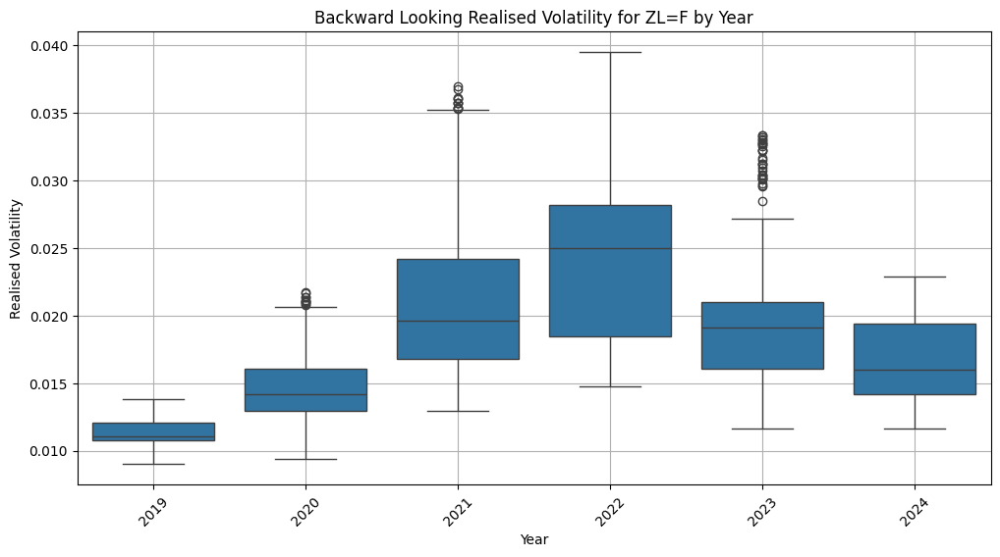

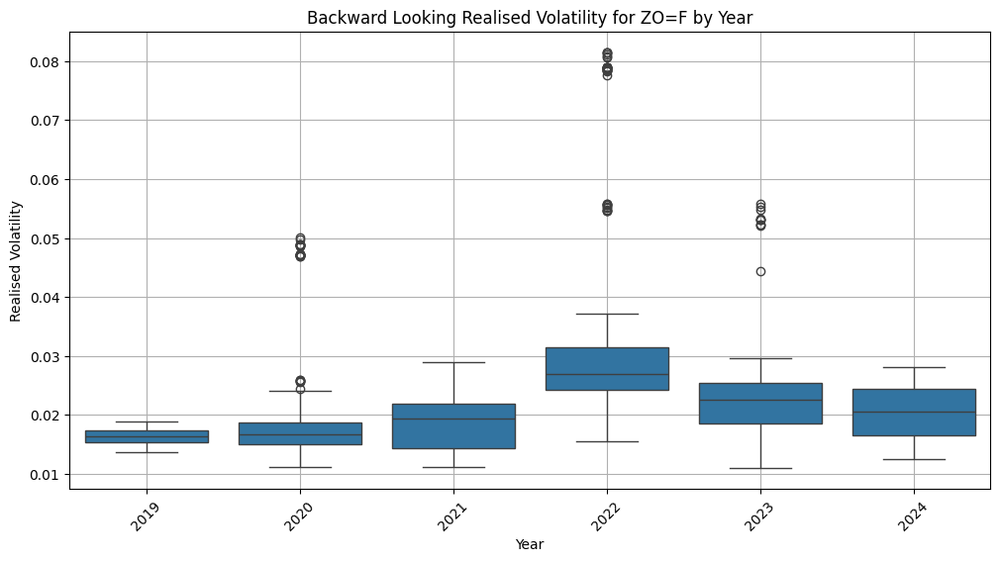

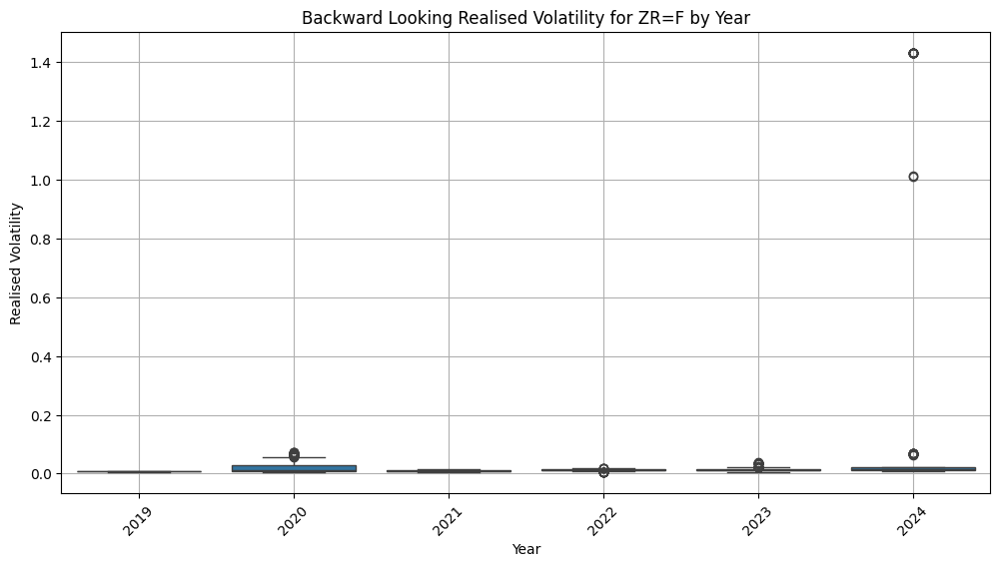

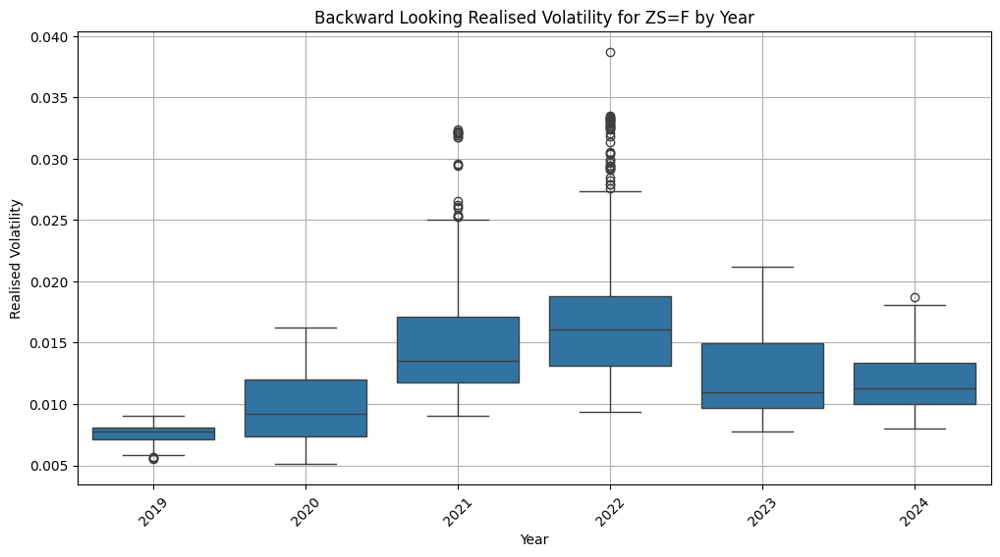

In [17]:
# We want to view the distribution of volatilities for each year
# Create a new column with the year
vol_back_df['Year'] = vol_back_df.index.year

# Group the data by year and commodity
grouped_data = vol_back_df.groupby(['Year'])

# Create a boxplot for each commodity
for ticker in vol_back_df.columns[:-2]:
  plt.figure(figsize=(12, 6))
  sns.boxplot(x='Year', y=ticker, data=vol_back_df)
  plt.title(f'Backward Looking Realised Volatility for {ticker} by Year')
  plt.xlabel('Year')
  plt.ylabel('Realised Volatility')
  plt.xticks(rotation=45)
  plt.grid(True)
  plt.show()


In [18]:
# Conduct ADF tests on each commodity for both the returns and log returns
# Create empty dictionaries to store the ADF test results for returns and log_returns
adf_returns_results = {}
adf_log_returns_results = {}

# Loop through each commodity
for ticker in returns.columns:
  # Perform ADF test for returns
  adf_result_returns = adfuller(returns[ticker])
  adf_returns_results[ticker] = {
      'Test Statistic': adf_result_returns[0],
      'P-value': adf_result_returns[1],
      '1% Critical Value': adf_result_returns[4]['1%'],
      '5% Critical Value': adf_result_returns[4]['5%'],
      '10% Critical Value': adf_result_returns[4]['10%']
  }

  # Perform ADF test for log_returns
  adf_result_log_returns = adfuller(log_returns[ticker])
  adf_log_returns_results[ticker] = {
      'Test Statistic': adf_result_log_returns[0],
      'P-value': adf_result_log_returns[1],
      '1% Critical Value': adf_result_log_returns[4]['1%'],
      '5% Critical Value': adf_result_log_returns[4]['5%'],
      '10% Critical Value': adf_result_log_returns[4]['10%']
  }

# Convert the dictionaries to pandas DataFrames
adf_returns_results_df = pd.DataFrame(adf_returns_results).T
adf_log_returns_results_df = pd.DataFrame(adf_log_returns_results).T

# Print the DataFrames
print("ADF Test Results for Returns:")
print(adf_returns_results_df)

print("\nADF Test Results for Log Returns:")
print(adf_log_returns_results_df)


ADF Test Results for Returns:
       Test Statistic       P-value  1% Critical Value  5% Critical Value  \
CC=F       -34.572975  0.000000e+00          -3.435567          -2.863844   
CL=F        -8.094905  1.347209e-12          -3.435656          -2.863883   
GC=F       -15.482741  2.543750e-28          -3.435592          -2.863855   
GF=F        -8.633581  5.669125e-14          -3.435643          -2.863877   
HE=F       -14.367748  9.608493e-27          -3.435592          -2.863855   
HG=F       -15.284672  4.528061e-28          -3.435588          -2.863853   
KC=F       -35.766391  0.000000e+00          -3.435567          -2.863844   
KE=F       -34.956772  0.000000e+00          -3.435567          -2.863844   
LE=F        -8.692041  4.016265e-14          -3.435639          -2.863876   
MGC=F      -15.504661  2.390967e-28          -3.435592          -2.863855   
NG=F       -39.224149  0.000000e+00          -3.435567          -2.863844   
OJ=F       -13.995240  3.950484e-26          -

No p value is greater than 0.05 so there is enough evidence to reject the null hypothesis. So the returns and log returns are both no dependent on time/trend

Prepare the Data

In [30]:
# Split the data into training, validation and testing with a 60:30:10 ratio and apply minmax scaler for each ticker, split the indices also
train_ratio = 0.6
val_ratio = 0.3
test_ratio = 0.1

# Create dictionaries to store the scaled data
returns_train_scaled_dict = {}
returns_val_scaled_dict = {}
returns_test_scaled_dict = {}
vol_back_train_scaled_dict = {}
vol_back_val_scaled_dict = {}
vol_back_test_scaled_dict = {}
train_indices_dict = {}
val_indices_dict = {}
test_indices_dict = {}
returns_train_dict = {}
returns_val_dict = {}
returns_test_dict = {}

# Create a MinMaxScaler for returns and backward volatility
scaler_returns = MinMaxScaler()
scaler_volatility = MinMaxScaler()

# Apply the scaler to the training, validation, and testing data for each commodity
for ticker in returns.columns:
  # Get the data for the current commodity
  returns_ticker = returns[ticker]
  vol_back_df_ticker = vol_back_df[ticker]

  # Calculate the split indices
  total_length = len(returns_ticker)
  train_split = int(total_length * train_ratio)
  val_split = int(total_length * (train_ratio + val_ratio))

  # Split the returns data
  returns_train = returns_ticker[:train_split]
  returns_val = returns_ticker[train_split:val_split]
  returns_test = returns_ticker[val_split:]

  # Split the backward volatility data
  vol_back_train = vol_back_df_ticker[:train_split]
  vol_back_val = vol_back_df_ticker[train_split:val_split]
  vol_back_test = vol_back_df_ticker[val_split:]

  # Split the indices
  train_indices = returns_ticker.index[:train_split]
  val_indices = returns_ticker.index[train_split:val_split]
  test_indices = returns_ticker.index[val_split:]

  # Fit the scaler on the training data for returns
  scaler_returns.fit(returns_train.values.reshape(-1, 1))

  # Transform the training, validation, and testing data for returns
  returns_train_scaled = scaler_returns.transform(returns_train.values.reshape(-1, 1))
  returns_val_scaled = scaler_returns.transform(returns_val.values.reshape(-1, 1))
  returns_test_scaled = scaler_returns.transform(returns_test.values.reshape(-1, 1))

  # Fit the scaler on the training data for backward volatility
  scaler_volatility.fit(vol_back_train.values.reshape(-1, 1))

  # Transform the training, validation, and testing data for backward volatility
  vol_back_train_scaled = scaler_volatility.transform(vol_back_train.values.reshape(-1, 1))
  vol_back_val_scaled = scaler_volatility.transform(vol_back_val.values.reshape(-1, 1))
  vol_back_test_scaled = scaler_volatility.transform(vol_back_test.values.reshape(-1, 1))

  # Store the scaled data in the dictionaries
  returns_train_dict[ticker] = returns_train
  returns_val_dict[ticker] = returns_val
  returns_test_dict[ticker] = returns_test
  returns_train_scaled_dict[ticker] = returns_train_scaled
  returns_val_scaled_dict[ticker] = returns_val_scaled
  returns_test_scaled_dict[ticker] = returns_test_scaled
  vol_back_train_scaled_dict[ticker] = vol_back_train_scaled
  vol_back_val_scaled_dict[ticker] = vol_back_val_scaled
  vol_back_test_scaled_dict[ticker] = vol_back_test_scaled
  train_indices_dict[ticker] = train_indices
  val_indices_dict[ticker] = val_indices
  test_indices_dict[ticker] = test_indices


Performance Metric Functions

In [20]:
def RMSE(y_true, y_pred):
    """
    Compute Root Mean Squared Error between 2 arrays
    """
    output = np.sqrt(mse(y_true, y_pred))
    return output

In [21]:
def RMSPE(y_true, y_pred):
    """
    Compute Root Mean Squared Percentage Error between 2 arrays
    """
    output = np.sqrt(np.mean(np.square((y_true - y_pred) / y_true)))
    return output

Model 1: Baseline (the mean)

In [22]:
vol_back_val_pred_mean_dict = {}

for ticker in vol_back_train_scaled_dict.keys():
  train_mean = np.mean(vol_back_train_scaled_dict[ticker])
  val_pred_mean = np.full(vol_back_val_scaled_dict[ticker].shape, train_mean)
  vol_back_val_pred_mean_dict[ticker] = val_pred_mean


In [23]:
# Get the MSE and RMSE scores and show them
rmse_scores = {}
rmspe_scores = {}

for ticker in vol_back_val_pred_mean_dict.keys():
  y_true = vol_back_val_scaled_dict[ticker]
  y_pred = vol_back_val_pred_mean_dict[ticker]
  rmse_scores[ticker] = RMSE(y_true, y_pred)
  rmspe_scores[ticker] = RMSPE(y_true, y_pred)

performance_df = pd.DataFrame({'RMSE': rmse_scores, 'RMSPE': rmspe_scores})

print(performance_df)


           RMSE      RMSPE
CC=F   0.356941  12.057143
CL=F   0.081689   2.514371
GC=F   0.119058   3.657344
GF=F   0.162150  80.995089
HE=F   0.195708   5.214604
HG=F   0.228105   1.651391
KC=F   0.117389   0.567844
KE=F   0.114893   2.240645
LE=F   0.110890  32.061551
MGC=F  0.116667   1.982976
NG=F   0.129957   0.377245
OJ=F   0.214040  15.858542
PA=F   0.077330   0.685685
PL=F   0.102590   0.847774
RB=F   0.056166   1.260652
SB=F   0.197775   0.716877
SI=F   0.123659   0.845763
SIL=F  0.123659   0.845763
ZC=F   0.228422   3.943254
ZL=F   0.175998   0.754938
ZO=F   0.124747   4.415255
ZR=F   0.096819  94.577823
ZS=F   0.112501   0.836381


Model 2: GARCH

<Figure size 1200x600 with 0 Axes>

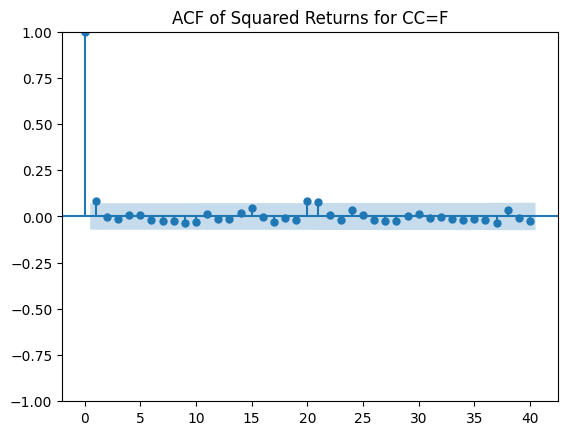

<Figure size 1200x600 with 0 Axes>

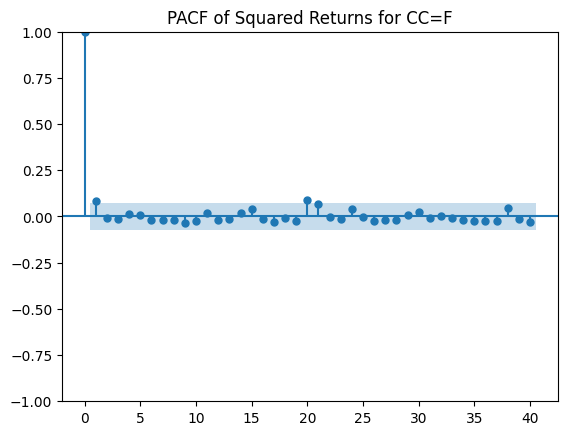

<Figure size 1200x600 with 0 Axes>

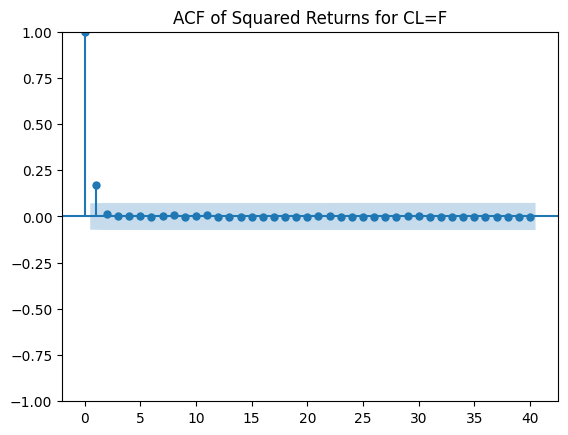

<Figure size 1200x600 with 0 Axes>

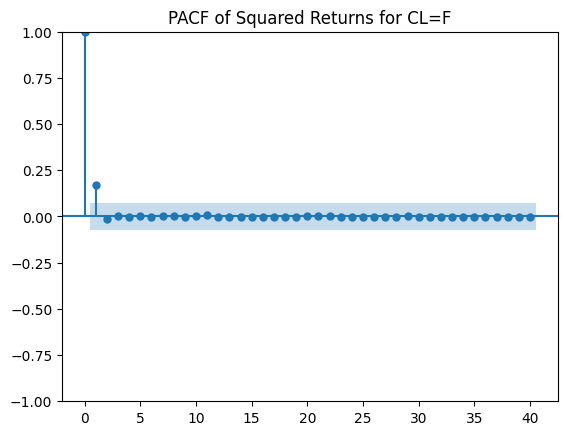

<Figure size 1200x600 with 0 Axes>

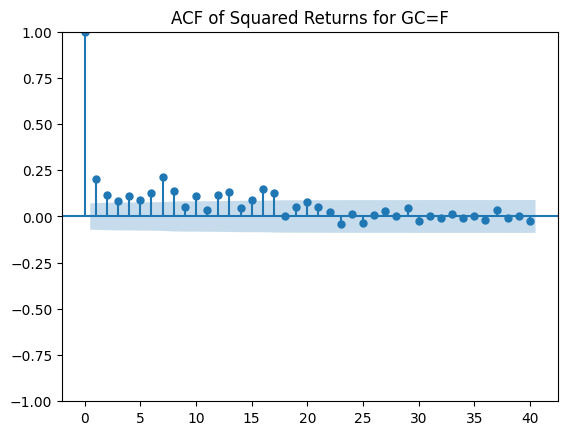

<Figure size 1200x600 with 0 Axes>

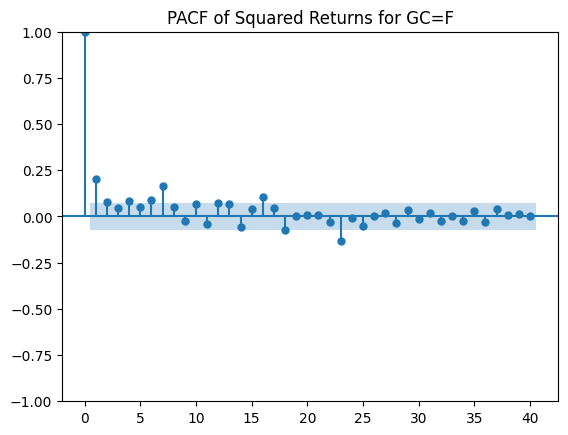

<Figure size 1200x600 with 0 Axes>

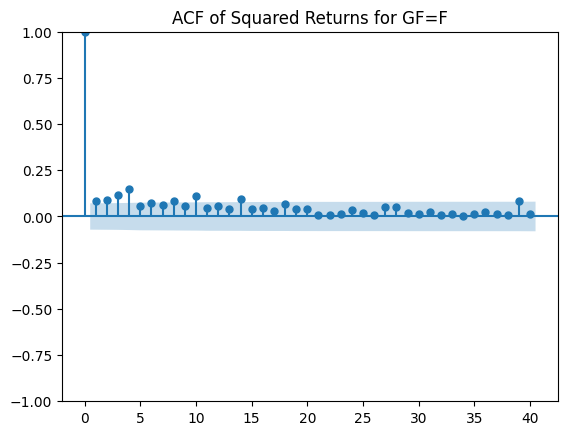

<Figure size 1200x600 with 0 Axes>

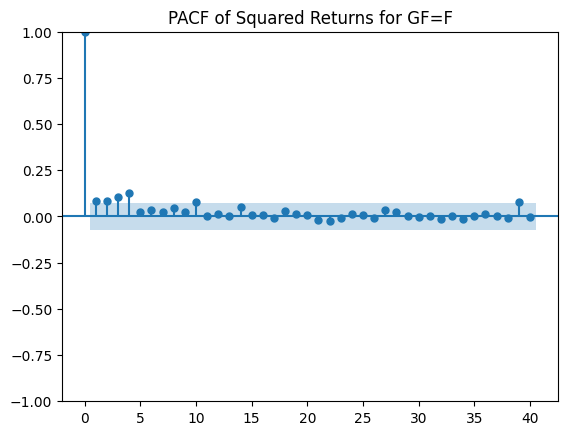

<Figure size 1200x600 with 0 Axes>

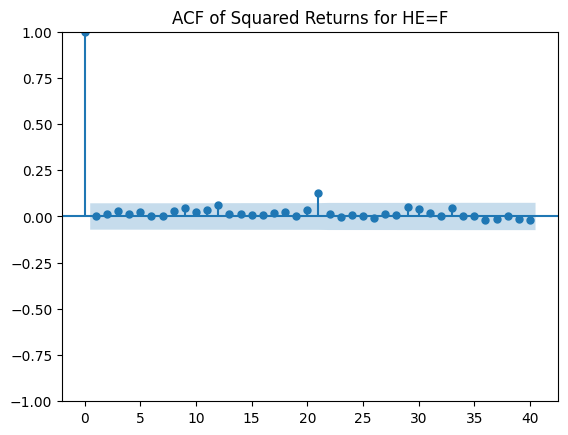

<Figure size 1200x600 with 0 Axes>

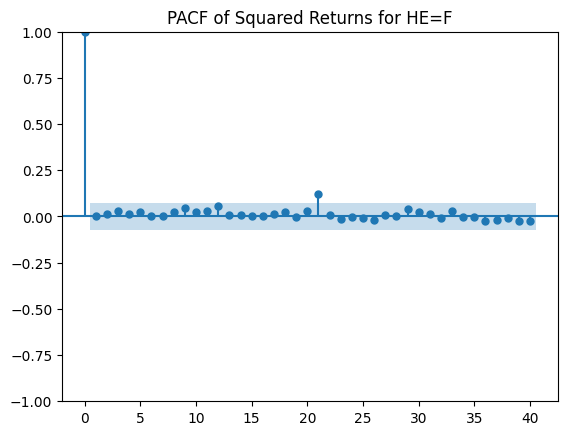

<Figure size 1200x600 with 0 Axes>

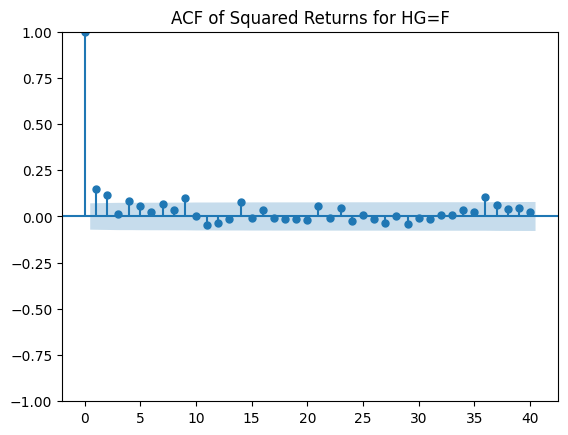

<Figure size 1200x600 with 0 Axes>

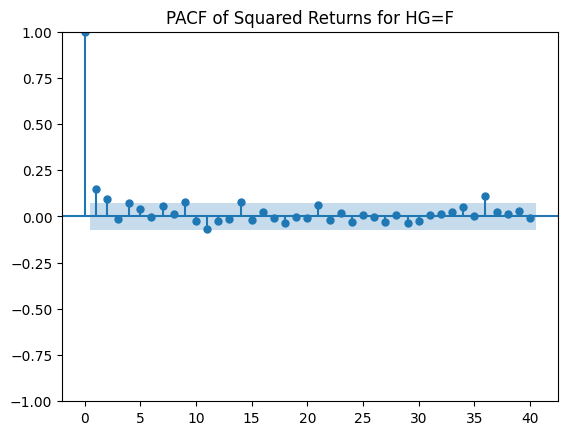

<Figure size 1200x600 with 0 Axes>

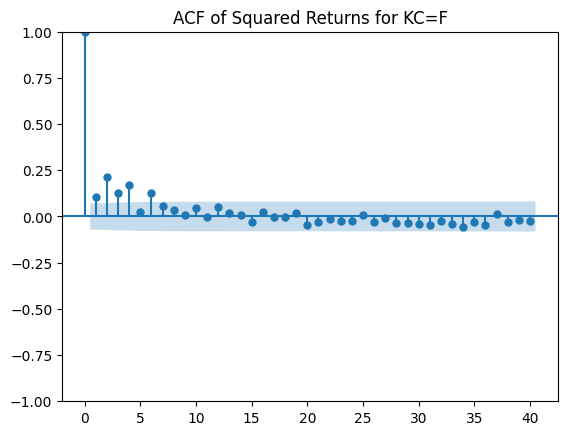

<Figure size 1200x600 with 0 Axes>

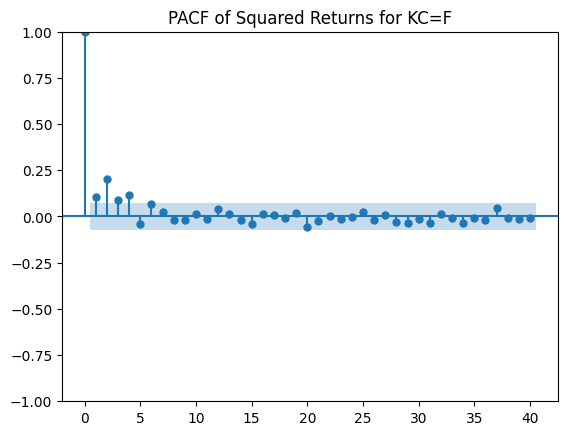

<Figure size 1200x600 with 0 Axes>

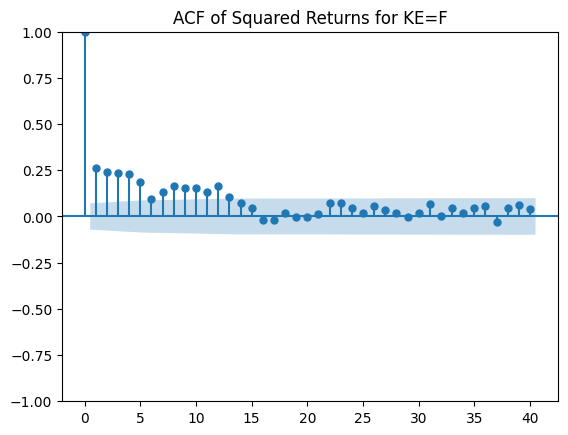

<Figure size 1200x600 with 0 Axes>

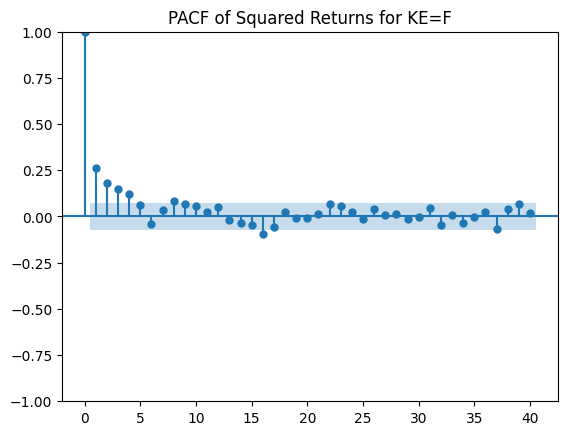

<Figure size 1200x600 with 0 Axes>

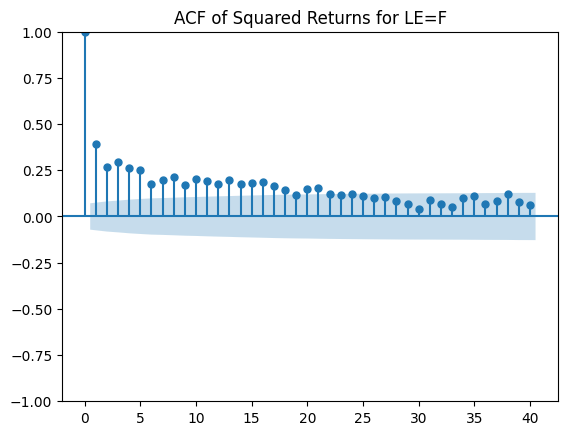

<Figure size 1200x600 with 0 Axes>

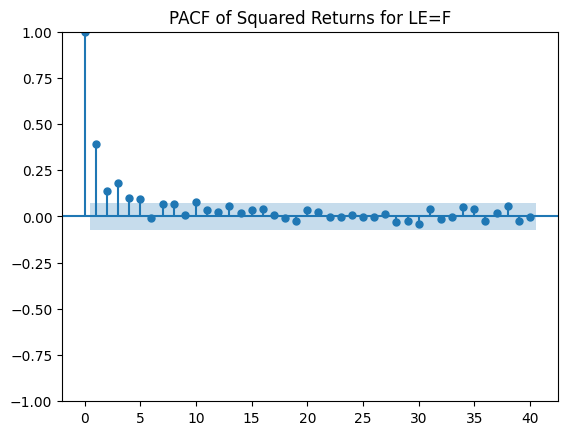

<Figure size 1200x600 with 0 Axes>

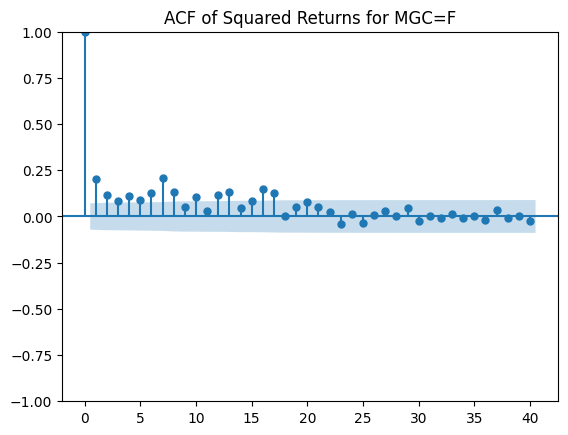

<Figure size 1200x600 with 0 Axes>

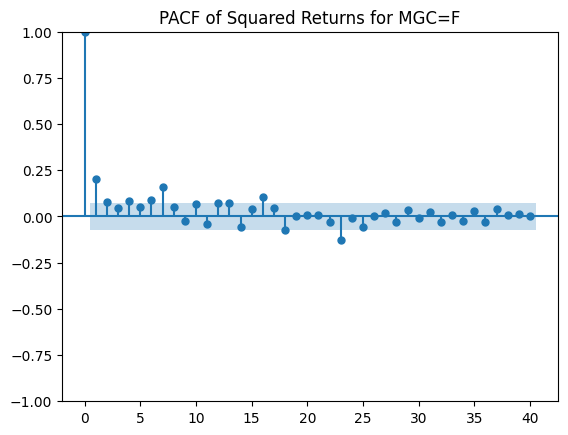

<Figure size 1200x600 with 0 Axes>

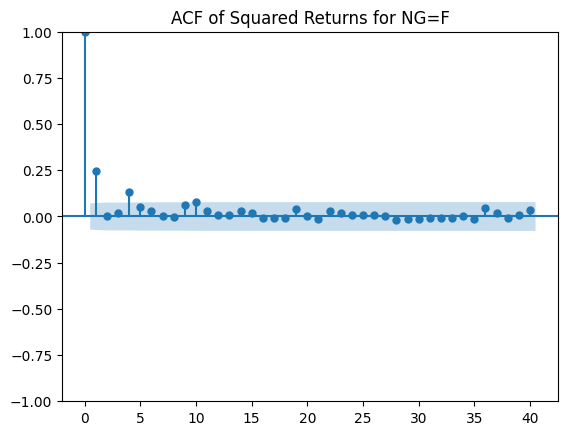

<Figure size 1200x600 with 0 Axes>

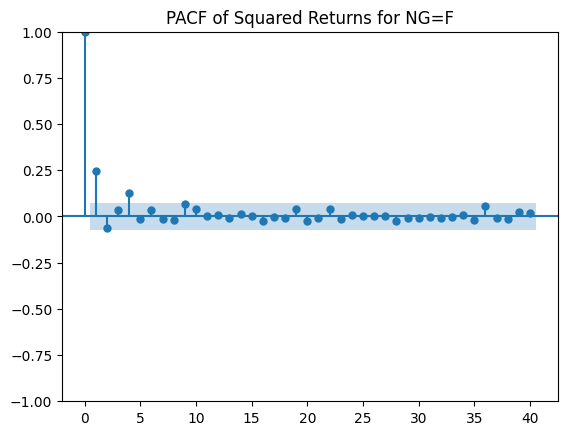

<Figure size 1200x600 with 0 Axes>

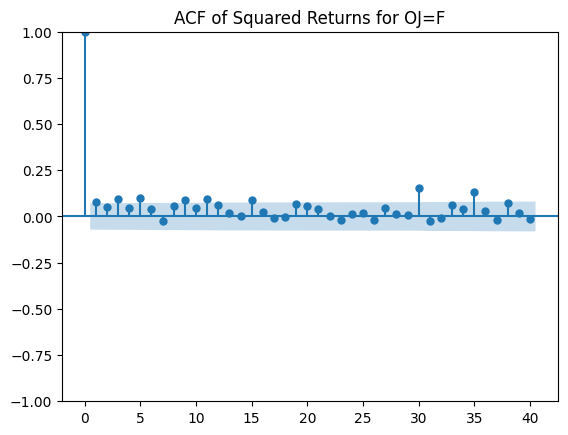

<Figure size 1200x600 with 0 Axes>

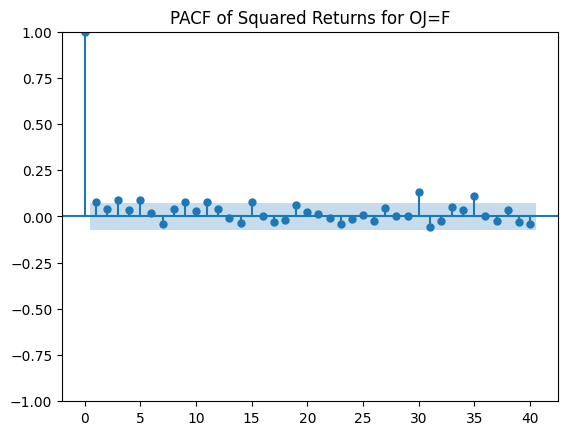

<Figure size 1200x600 with 0 Axes>

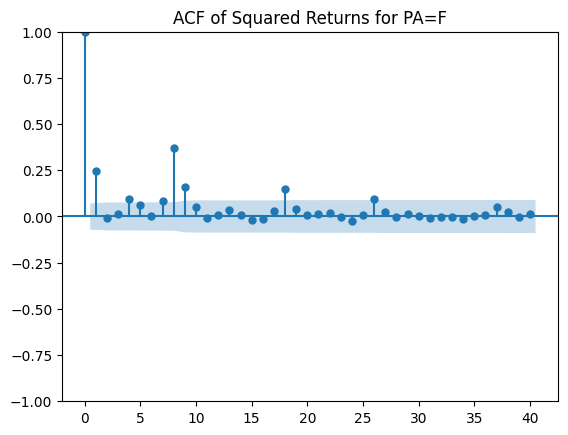

<Figure size 1200x600 with 0 Axes>

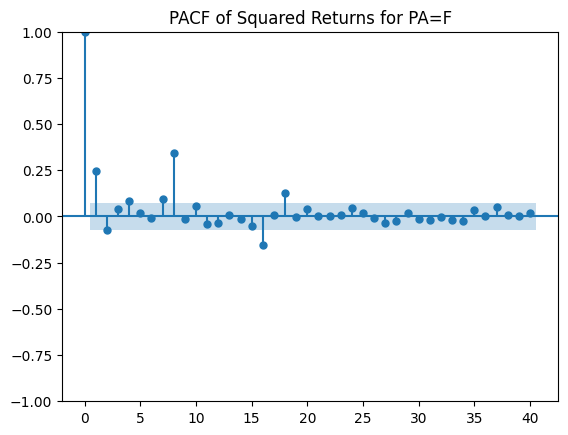

<Figure size 1200x600 with 0 Axes>

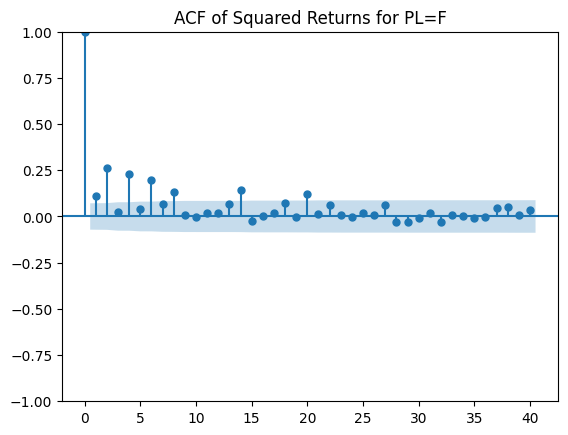

<Figure size 1200x600 with 0 Axes>

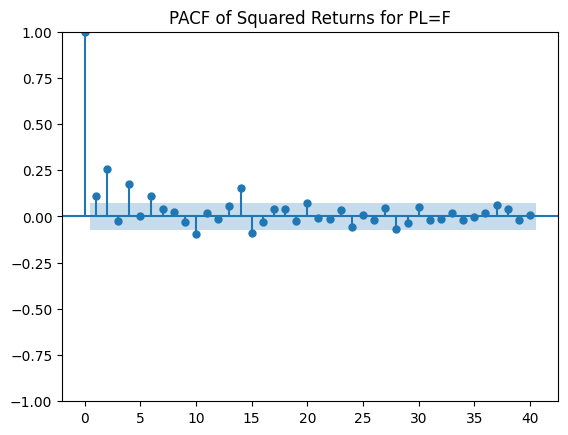

<Figure size 1200x600 with 0 Axes>

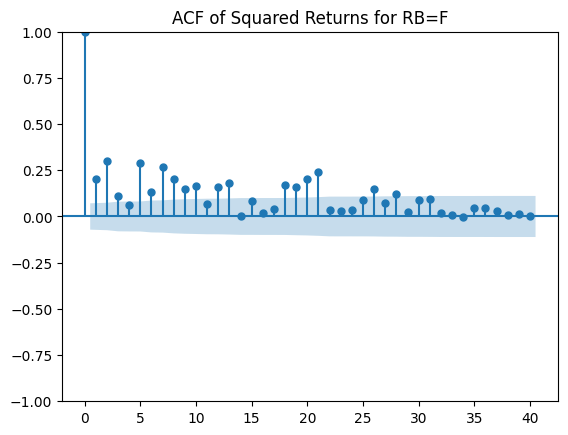

<Figure size 1200x600 with 0 Axes>

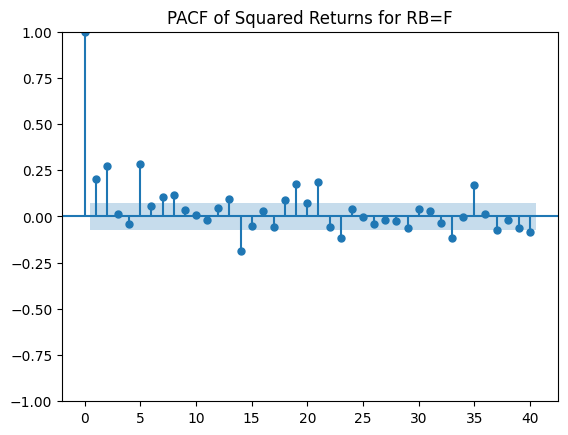

<Figure size 1200x600 with 0 Axes>

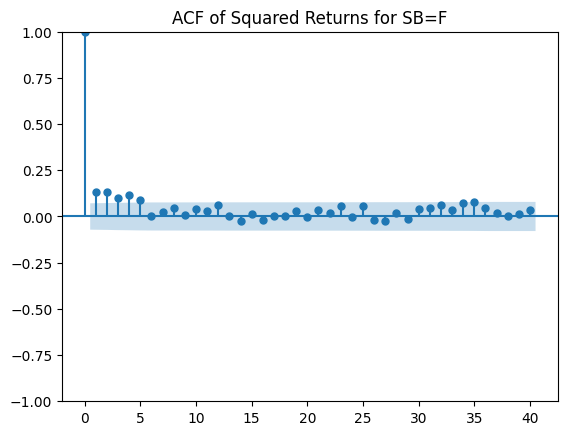

<Figure size 1200x600 with 0 Axes>

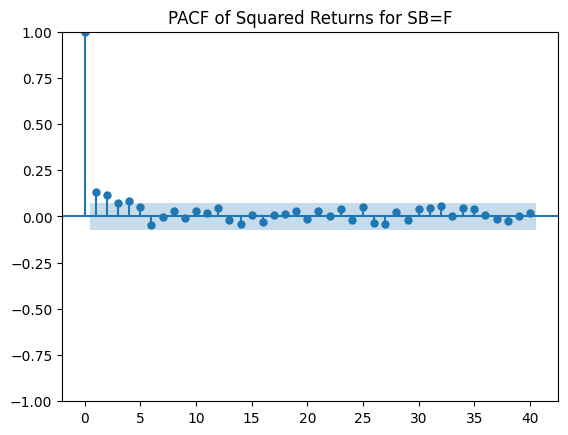

<Figure size 1200x600 with 0 Axes>

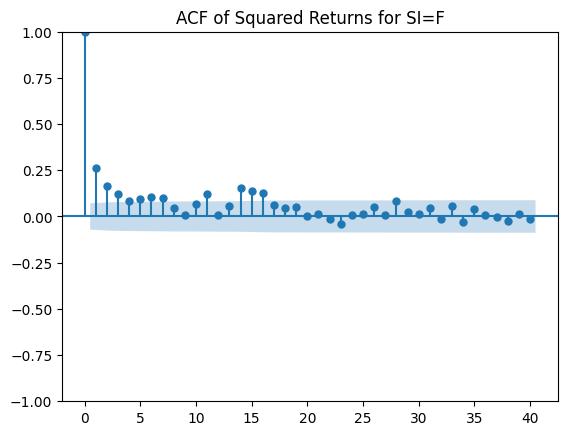

<Figure size 1200x600 with 0 Axes>

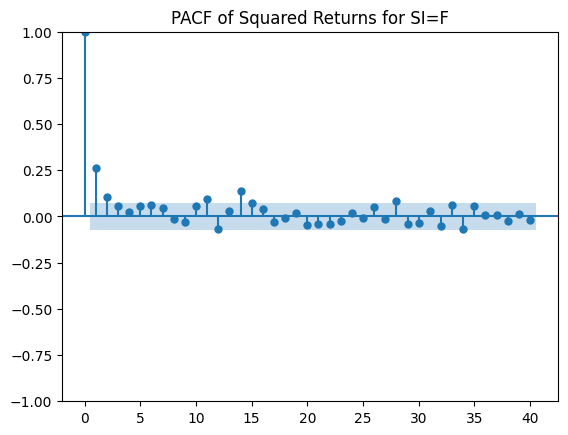

<Figure size 1200x600 with 0 Axes>

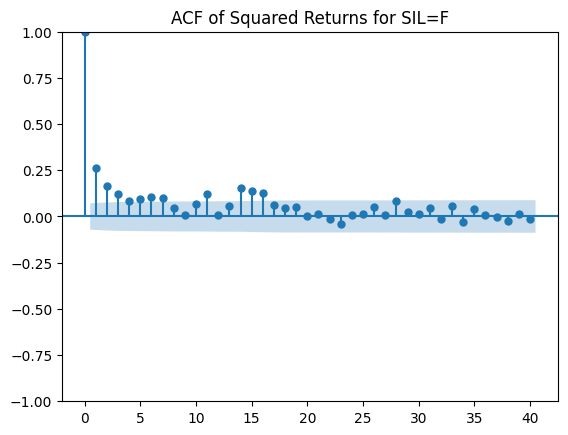

<Figure size 1200x600 with 0 Axes>

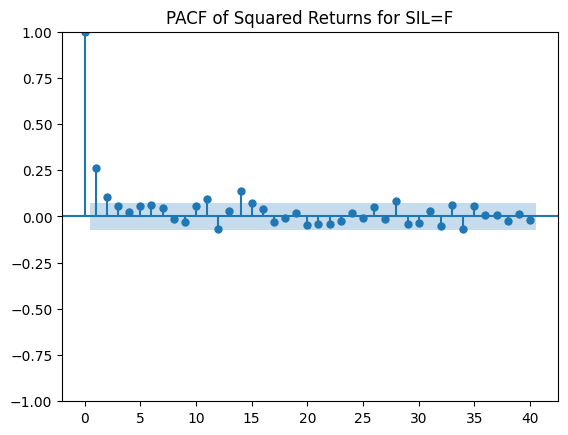

<Figure size 1200x600 with 0 Axes>

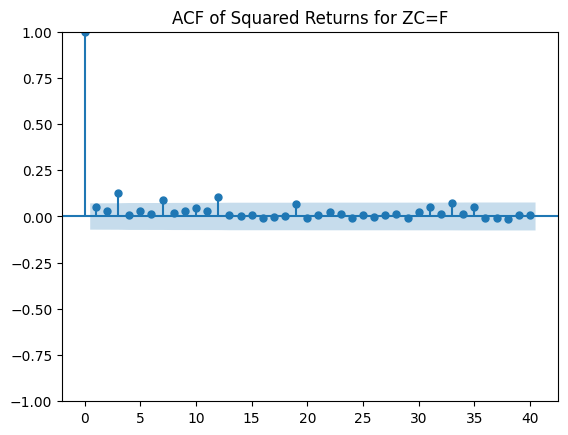

<Figure size 1200x600 with 0 Axes>

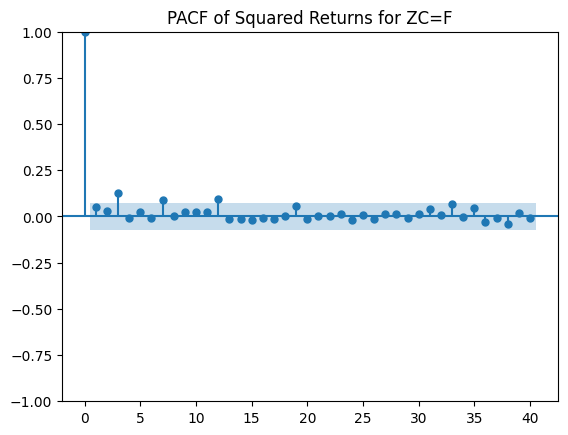

<Figure size 1200x600 with 0 Axes>

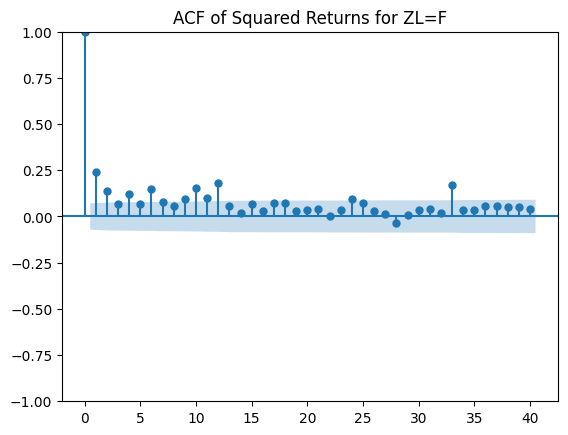

<Figure size 1200x600 with 0 Axes>

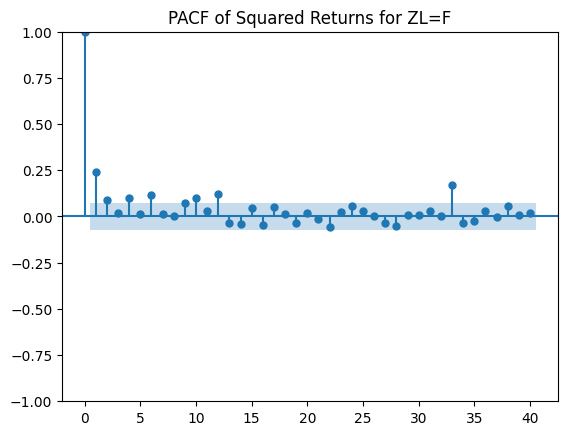

<Figure size 1200x600 with 0 Axes>

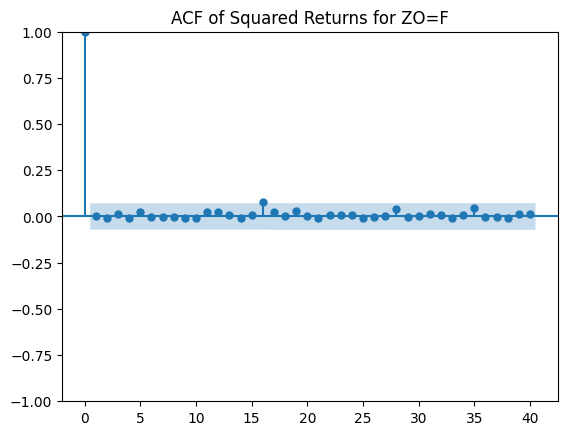

<Figure size 1200x600 with 0 Axes>

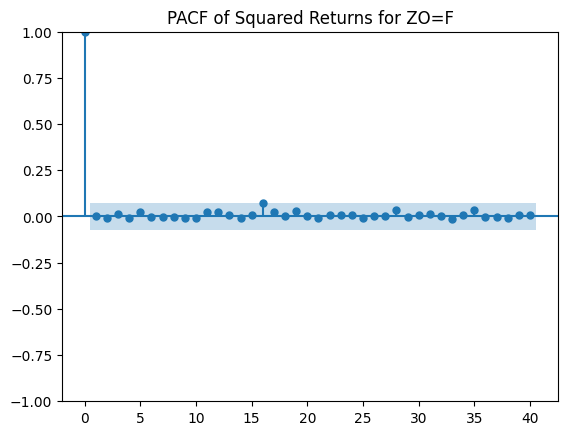

<Figure size 1200x600 with 0 Axes>

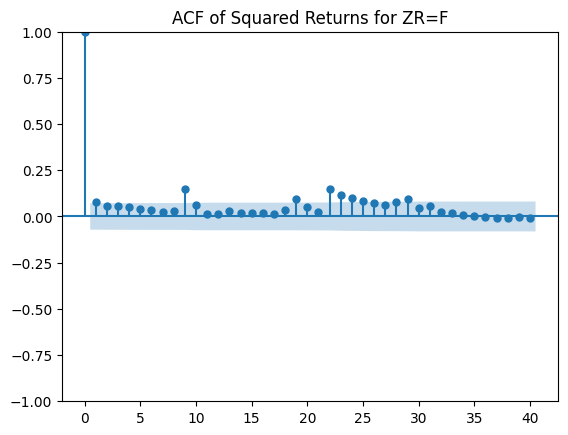

<Figure size 1200x600 with 0 Axes>

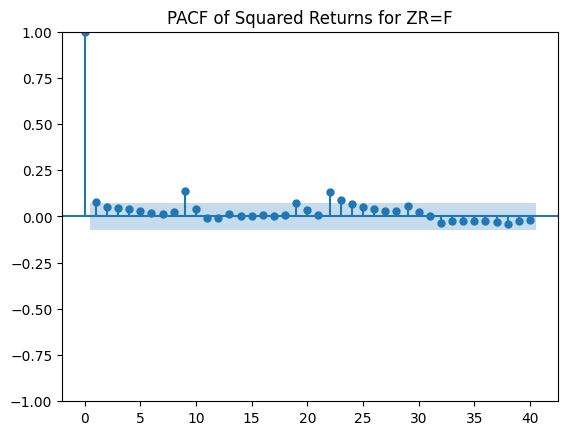

<Figure size 1200x600 with 0 Axes>

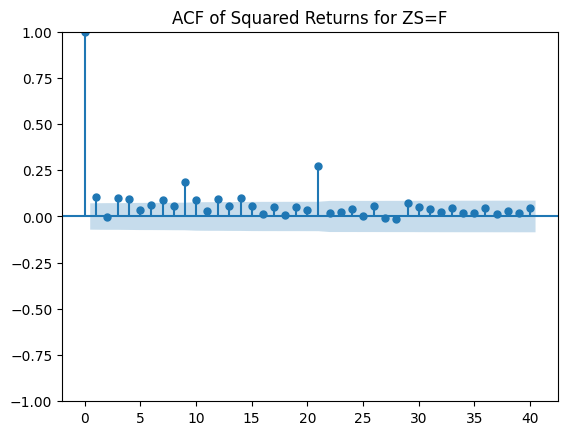

<Figure size 1200x600 with 0 Axes>

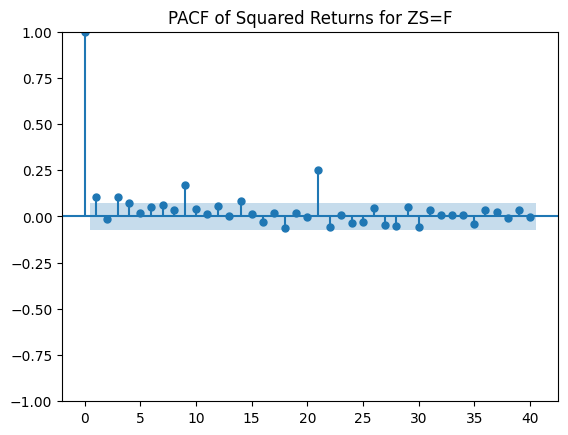

In [32]:
for ticker in returns.columns:
  # Get the squared returns for the training data
  squared_returns_train = (returns_train_dict[ticker] ** 2)

  # Create ACF and PACF plots
  plt.figure(figsize=(12, 6))
  plot_acf(squared_returns_train, lags=40, title=f'ACF of Squared Returns for {ticker}')
  plt.show()

  plt.figure(figsize=(12, 6))
  plot_pacf(squared_returns_train, lags=40, title=f'PACF of Squared Returns for {ticker}')
  plt.show()

  # You can manually identify lags with significant correlation from these plots.
  # For example, if the ACF or PACF bars extend beyond the confidence intervals,
  # it indicates significant correlation at that lag.


In [58]:
# Determine the optimal values of p and q for each ticker using the GARCH model
optimal_pq_dict = {}

for ticker in returns.columns:
  best_aic = float('inf')
  best_p = 0
  best_q = 0

  for p in range(0, 8):  # Try p values from 0 to 2
    for q in range(0, 8):  # Try q values from 0 to 2
      if p == 0 and q == 0:
        continue  # Skip if both p and q are 0

      try:
        model = arch_model(returns_train_scaled_dict[ticker], vol='Garch', p=p, q=q, dist='Normal')
        results = model.fit(disp='off')
        if results.aic < best_aic:
          best_aic = results.aic
          best_p = p
          best_q = q
      except:
        pass

  optimal_pq_dict[ticker] = (best_p, best_q)

optimal_pq_df = pd.DataFrame.from_dict(optimal_pq_dict, orient='index', columns=['Optimal p', 'Optimal q'])
print(optimal_pq_df)


/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/d

       Optimal p  Optimal q
CC=F           1          0
CL=F           7          0
GC=F           2          3
GF=F           4          5
HE=F           3          3
HG=F           1          3
KC=F           2          1
KE=F           1          1
LE=F           5          0
MGC=F          2          3
NG=F           5          5
OJ=F           3          3
PA=F           1          5
PL=F           1          1
RB=F           5          4
SB=F           1          1
SI=F           3          7
SIL=F          3          7
ZC=F           7          2
ZL=F           1          2
ZO=F           4          5
ZR=F           1          4
ZS=F           3          6


In [74]:
# Try p=1 and q=1 for each ticker and show the results, also save the models
# Create a dictionary to store the optimal models for each ticker
optimal_models_dict = {}

# Fit the GARCH model for each ticker with the optimal parameters
for ticker in returns.columns:
    model = arch_model(returns_train_scaled_dict[ticker], vol='Garch', p=1, q=1, dist='Normal')
    results = model.fit(disp='off')
    optimal_models_dict[ticker] = results
    print(f"Model results for {ticker}:")
    print(results.summary())



Model results for CC=F:
                     Constant Mean - GARCH Model Results                      
Dep. Variable:                      y   R-squared:                       0.000
Mean Model:             Constant Mean   Adj. R-squared:                  0.000
Vol Model:                      GARCH   Log-Likelihood:                759.322
Distribution:                  Normal   AIC:                          -1510.64
Method:            Maximum Likelihood   BIC:                          -1492.14
                                        No. Observations:                  754
Date:                Thu, Sep 12 2024   Df Residuals:                      753
Time:                        19:11:51   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------------------
mu             0.4120  3.264e-03    126.233   

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Model results for HE=F:
                     Constant Mean - GARCH Model Results                      
Dep. Variable:                      y   R-squared:                       0.000
Mean Model:             Constant Mean   Adj. R-squared:                  0.000
Vol Model:                      GARCH   Log-Likelihood:                825.057
Distribution:                  Normal   AIC:                          -1642.11
Method:            Maximum Likelihood   BIC:                          -1623.61
                                        No. Observations:                  754
Date:                Thu, Sep 12 2024   Df Residuals:                      753
Time:                        19:11:51   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------------------
mu             0.5280  3.009e-03    175.501   

In [75]:
# Create a dictionary to store the forecasts for each ticker
forecasts_dict = {}

# Loop through each ticker
for ticker in returns.columns:
  # Get the optimal model for the ticker
  model = optimal_models_dict[ticker]

  # Initialize an empty list to store the forecasts
  forecasts = []

  # Loop through the validation data in 5-day windows
  for i in range(0, len(returns_val_scaled_dict[ticker]) - 5 + 1, 5):
    # Get the data up to the current window
    current_train_data = pd.concat([pd.Series(returns_train_scaled_dict[ticker].flatten()), pd.Series(returns_val_scaled_dict[ticker][:i].flatten())])

    # Fit the model on the current training data

    model = arch_model(current_train_data, vol='Garch', p=1, q=1, dist='Normal')
    results = model.fit(disp='off')

    # Make a forecast for the next 5 days
    forecast = results.forecast(horizon=5)
    variance_forecast = forecast.variance.values[-1]

    # Get the volatility forecast (standard deviation of the forecast)
    volatility_forecast = np.sqrt(variance_forecast)

    # Append the volatility forecast to the list
    forecasts.extend(volatility_forecast)

  # Store the forecasts for the ticker in the dictionary
  forecasts_dict[ticker] = forecasts

# Convert the forecasts to a DataFrame
forecasts_df = pd.DataFrame(forecasts_dict)

# Print the DataFrame
print(forecasts_df)



/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


         CC=F      CL=F      GC=F      GF=F      HE=F      HG=F      KC=F  \
0    0.087668  0.017393  0.086991  0.057960  0.080534  0.118039  0.113042   
1    0.088729  0.018165  0.087915  0.058372  0.080546  0.118039  0.114307   
2    0.088814  0.018907  0.088747  0.058765  0.080559  0.118039  0.115380   
3    0.088821  0.019623  0.089499  0.059140  0.080571  0.118039  0.116291   
4    0.088822  0.020315  0.090177  0.059497  0.080582  0.118039  0.117066   
..        ...       ...       ...       ...       ...       ...       ...   
370  0.122820  0.013139  0.091201  0.059406  0.076858  0.081839  0.109845   
371  0.122595  0.013705  0.091204  0.059670  0.076883  0.084215  0.111578   
372  0.122372  0.014237  0.091206  0.059922  0.076909  0.086381  0.113039   
373  0.122150  0.014741  0.091208  0.060162  0.076933  0.088361  0.114272   
374  0.121930  0.015218  0.091210  0.060390  0.076958  0.090175  0.115316   

         KE=F      LE=F     MGC=F  ...      PL=F      RB=F      SB=F  \
0  

           RMSE      RMSPE
CC=F   0.393503   3.367590
CL=F   0.071911   0.764877
GC=F   0.124435   1.083539
GF=F   0.169110  26.238332
HE=F   0.268984   1.289006
HG=F   0.289806   0.622658
KC=F   0.230013   0.591947
KE=F   0.134412   1.043513
LE=F   0.078854  12.842893
MGC=F  0.124838   0.606257
NG=F   0.261611   0.757221
OJ=F   0.389679   6.295082
PA=F   0.167633   0.685716
PL=F   0.118419   0.520648
RB=F   0.067011   0.595907
SB=F   0.327367   0.652036
SI=F   0.145955   0.547303
SIL=F  0.145955   0.547303
ZC=F   0.236993   0.931749
ZL=F   0.276109   0.587340
ZO=F   0.162007   2.506793
ZR=F   0.123680  23.542708
ZS=F   0.147917   0.579336


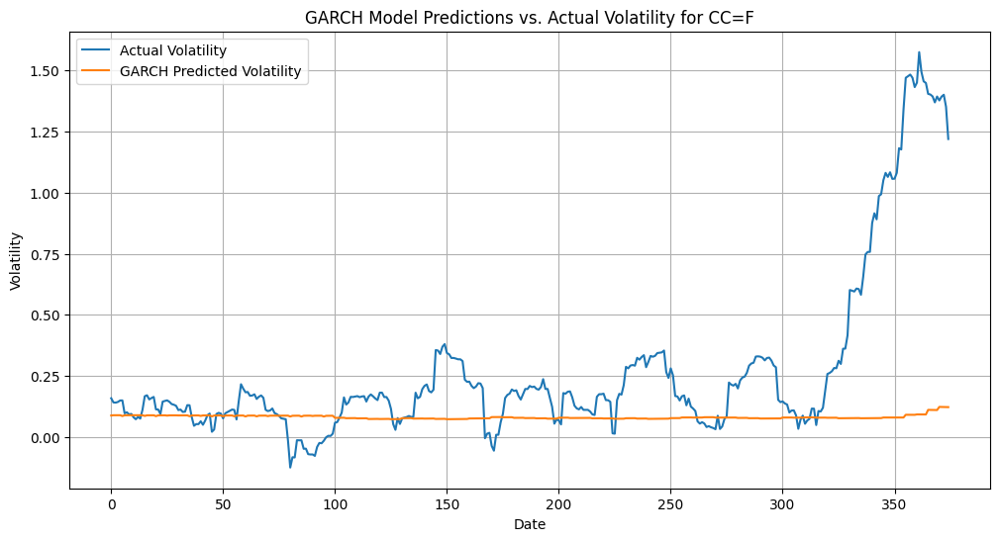

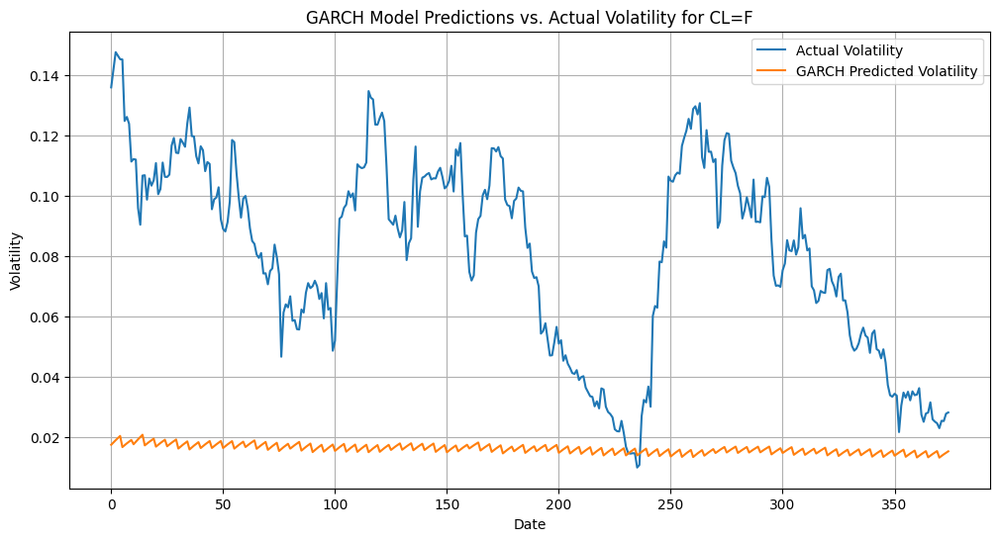

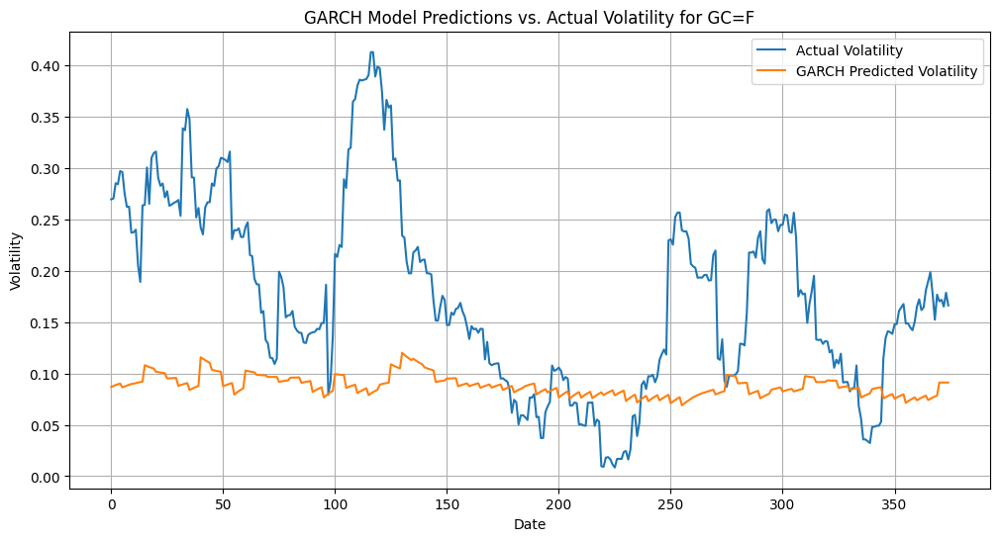

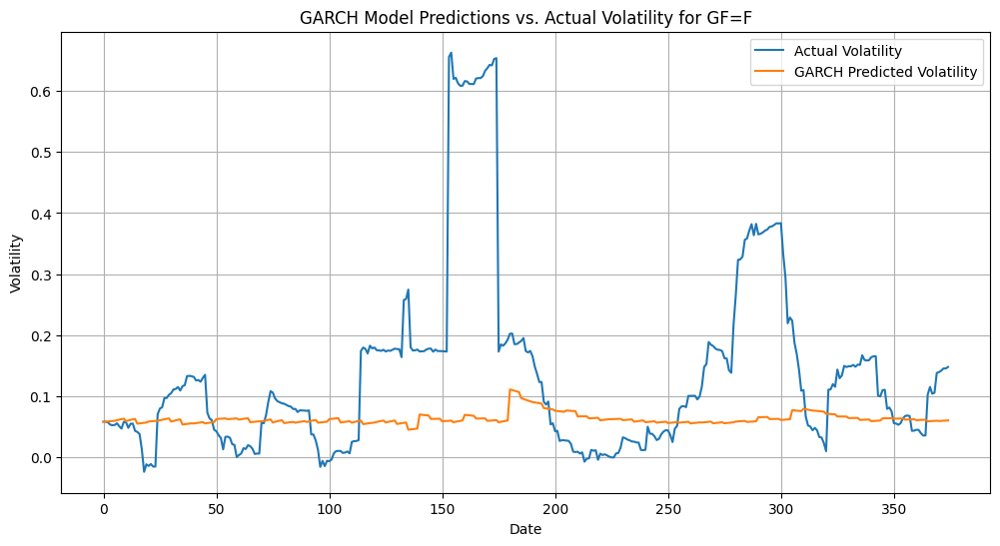

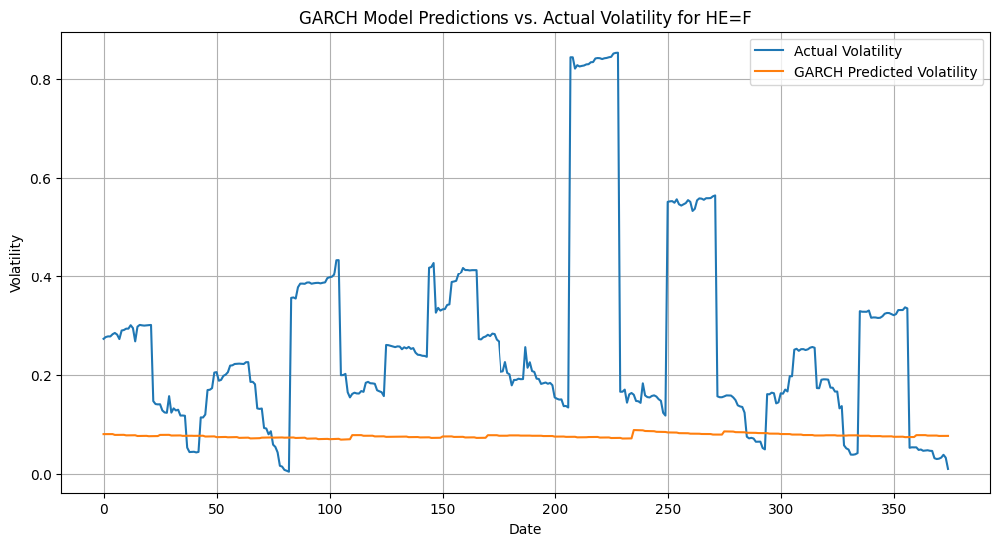

...

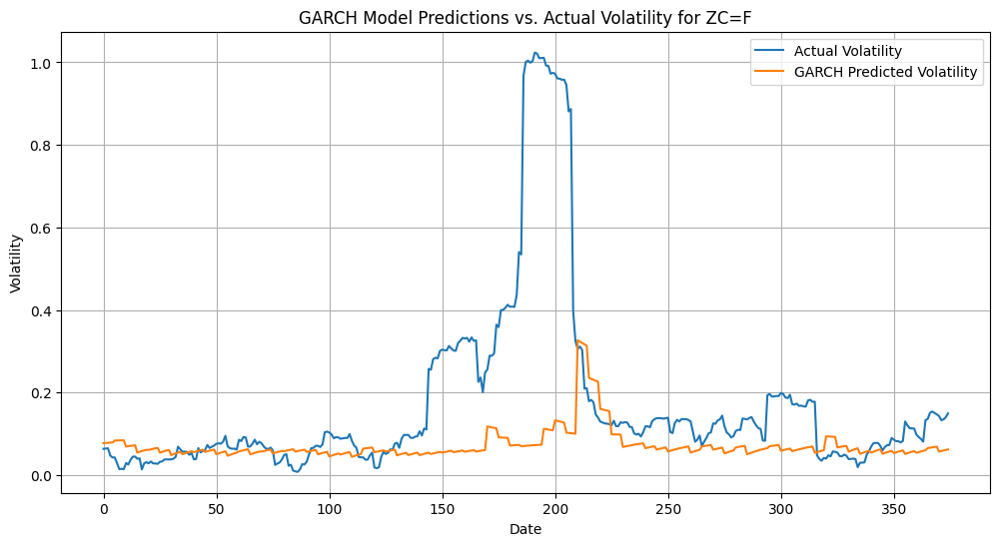

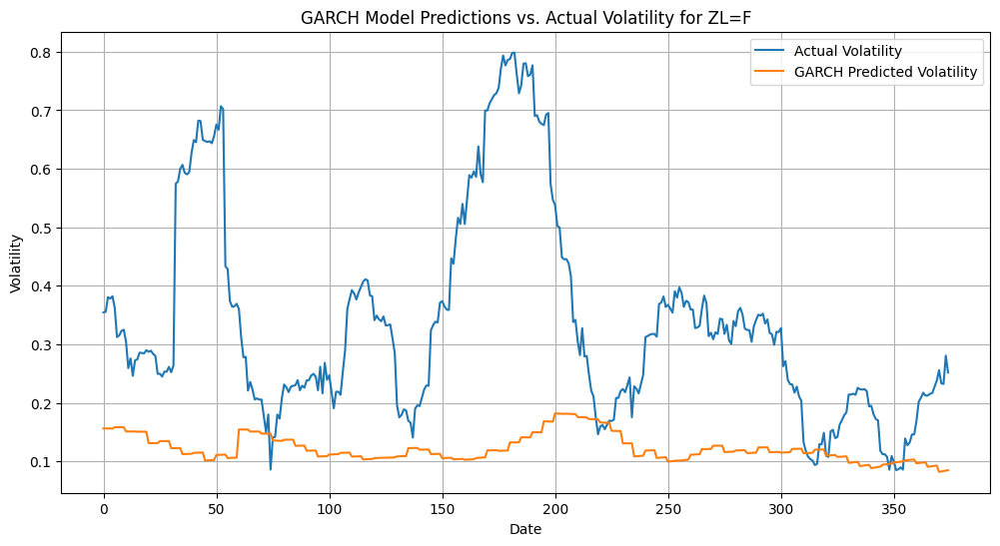

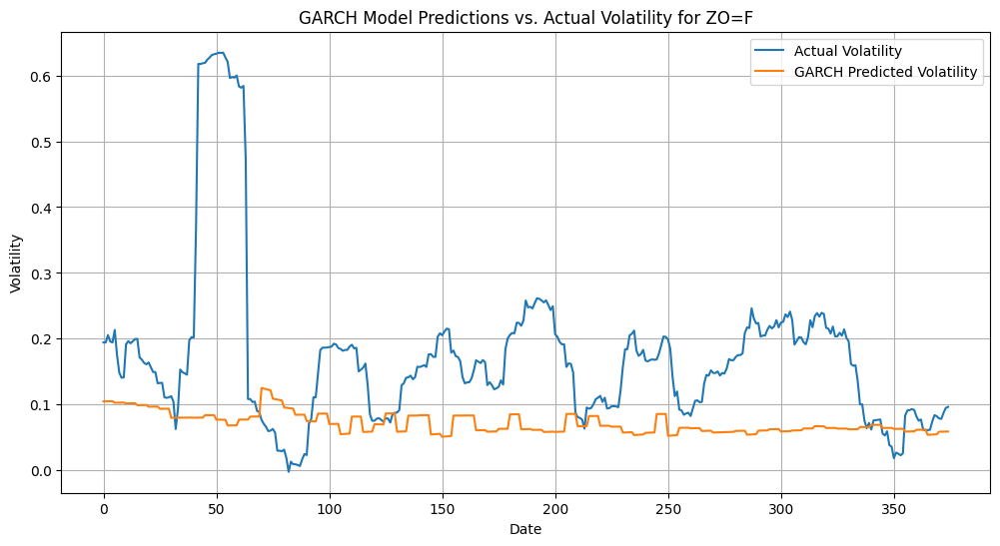

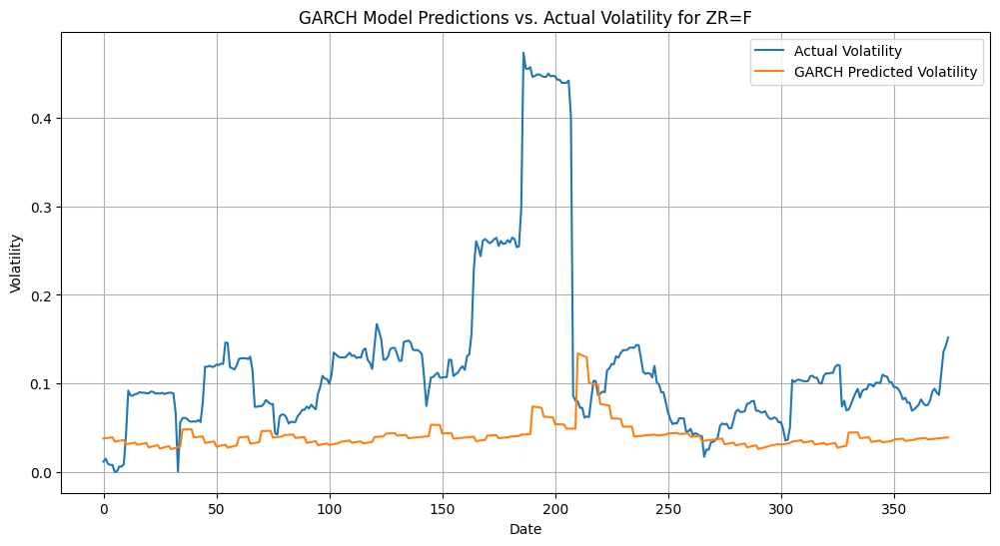

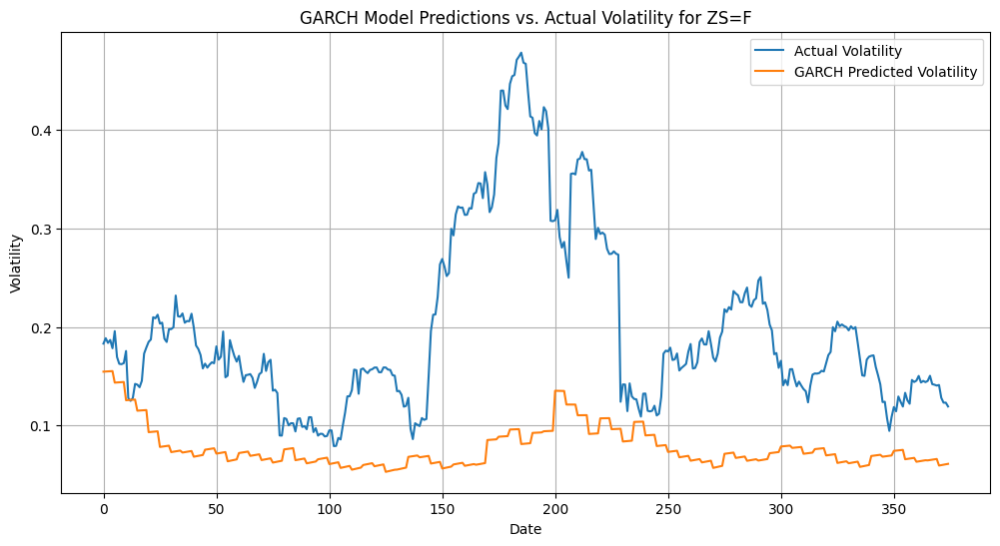

In [76]:
# Calculate performance metrics for each ticker
rmse_scores_garch = {}
rmspe_scores_garch = {}

for ticker in forecasts_df.columns:
  y_true = vol_back_val_scaled_dict[ticker][:len(forecasts_df)].flatten()
  y_pred = forecasts_df[ticker]
  rmse_scores_garch[ticker] = RMSE(y_true, y_pred)
  rmspe_scores_garch[ticker] = RMSPE(y_true, y_pred)

performance_df_garch = pd.DataFrame({'RMSE': rmse_scores_garch, 'RMSPE': rmspe_scores_garch})

print(performance_df_garch)

# Plot the predictions and actual values for each ticker
for ticker in forecasts_df.columns:
  plt.figure(figsize=(12, 6))
  plt.plot(vol_back_val_scaled_dict[ticker][:len(forecasts_df)], label='Actual Volatility')
  plt.plot(forecasts_df[ticker], label='GARCH Predicted Volatility')
  plt.title(f'GARCH Model Predictions vs. Actual Volatility for {ticker}')
  plt.xlabel('Date')
  plt.ylabel('Volatility')
  plt.legend()
  plt.grid(True)
  plt.show()


GARCH Model with Asymmetric Shocks Responses (GRJ GARCH)

For the GRJ GARCH model we set O to 1 so there is one lag of asymmetric shock.

In [77]:
# Create a dictionary to store the optimal GRJ GARCH models for each ticker
optimal_grj_models_dict = {}

# Fit the GRJ GARCH model for each ticker with the optimal parameters
for ticker in returns.columns:
    model = arch_model(returns_train_scaled_dict[ticker], vol='GARCH', p=1, o=1, q=1, dist='Normal')  # Set o=1 for GRJ
    results = model.fit(disp='off')
    optimal_grj_models_dict[ticker] = results
    print(f"GRJ GARCH Model results for {ticker}:")
    print(results.summary())


GRJ GARCH Model results for CC=F:
                   Constant Mean - GJR-GARCH Model Results                    
Dep. Variable:                      y   R-squared:                       0.000
Mean Model:             Constant Mean   Adj. R-squared:                  0.000
Vol Model:                  GJR-GARCH   Log-Likelihood:                760.108
Distribution:                  Normal   AIC:                          -1510.22
Method:            Maximum Likelihood   BIC:                          -1487.09
                                        No. Observations:                  754
Date:                Thu, Sep 12 2024   Df Residuals:                      753
Time:                        19:14:55   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------------------
mu             0.4123  3.158e-03    

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


GRJ GARCH Model results for NG=F:
                   Constant Mean - GJR-GARCH Model Results                    
Dep. Variable:                      y   R-squared:                       0.000
Mean Model:             Constant Mean   Adj. R-squared:                  0.000
Vol Model:                  GJR-GARCH   Log-Likelihood:                1094.54
Distribution:                  Normal   AIC:                          -2179.08
Method:            Maximum Likelihood   BIC:                          -2155.95
                                        No. Observations:                  754
Date:                Thu, Sep 12 2024   Df Residuals:                      753
Time:                        19:14:56   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------------------
mu             0.3604  1.827e-03    

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packag

         CC=F       CL=F      GC=F      GF=F      HE=F      HG=F      KC=F  \
0    0.087366   0.079851  0.081717  0.053256  0.084825  0.118669  0.110744   
1    0.087561   0.093154  0.082600  0.054013  0.084775  0.118691  0.111756   
2    0.087650   0.101767  0.083452  0.054749  0.084726  0.118711  0.112650   
3    0.087691   0.107616  0.084276  0.055465  0.084678  0.118731  0.113441   
4    0.087710   0.111690  0.085072  0.056162  0.084631  0.118750  0.114141   
..        ...        ...       ...       ...       ...       ...       ...   
370  0.133410  14.182139  0.093330  0.065160  0.234576  0.082685  0.112939   
371  0.132573  15.374281  0.093579  0.073091  0.287954  0.084890  0.113872   
372  0.131750  16.666634  0.093820  0.078067  0.319636  0.086907  0.114684   
373  0.130940  18.067622  0.094053  0.081304  0.339782  0.088755  0.115390   
374  0.130142  19.586376  0.094280  0.083452  0.353015  0.090454  0.116006   

         KE=F      LE=F     MGC=F  ...      PL=F      RB=F     

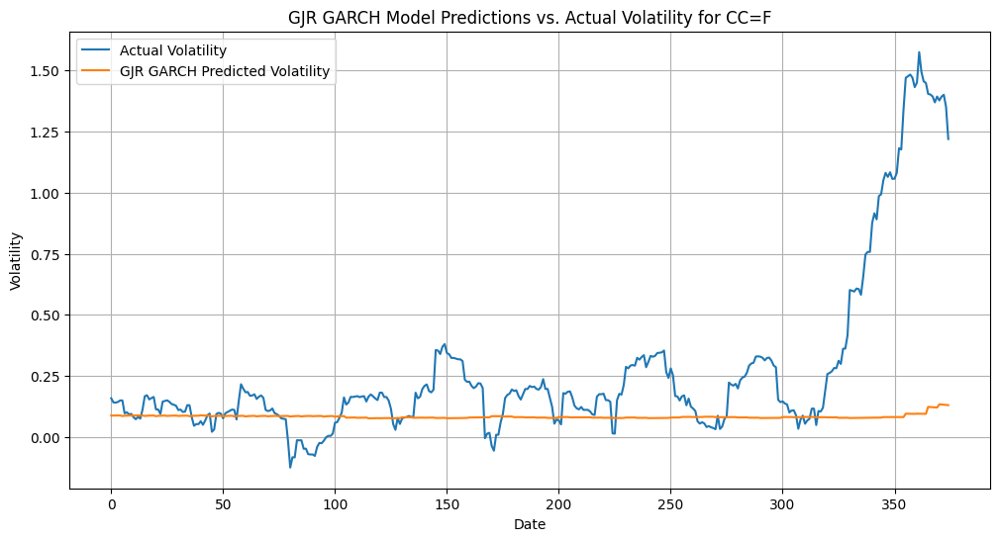

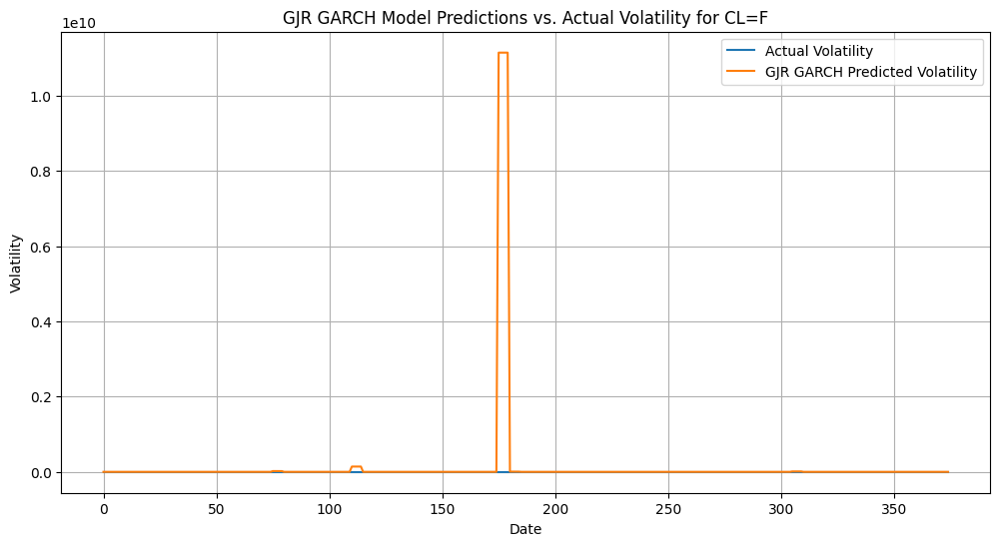

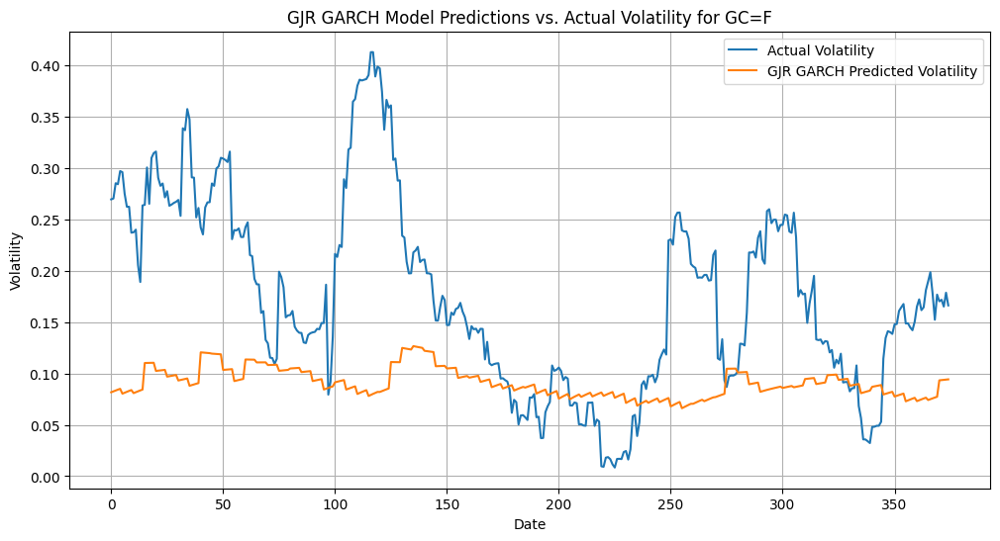

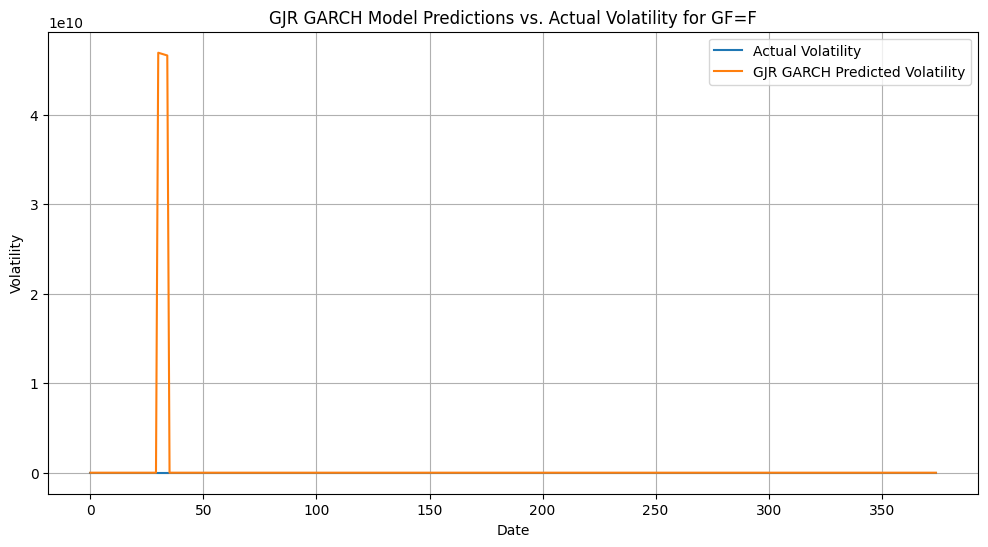

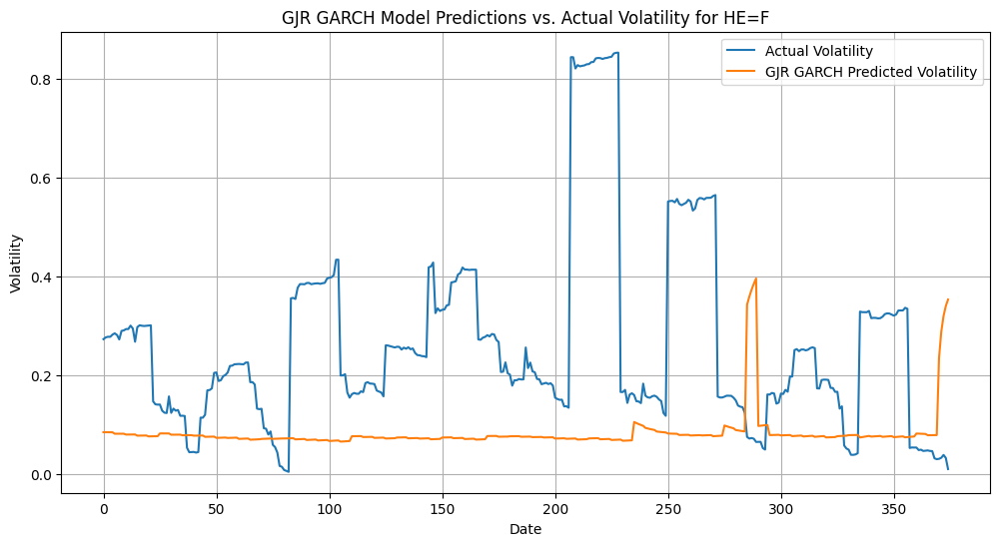

...

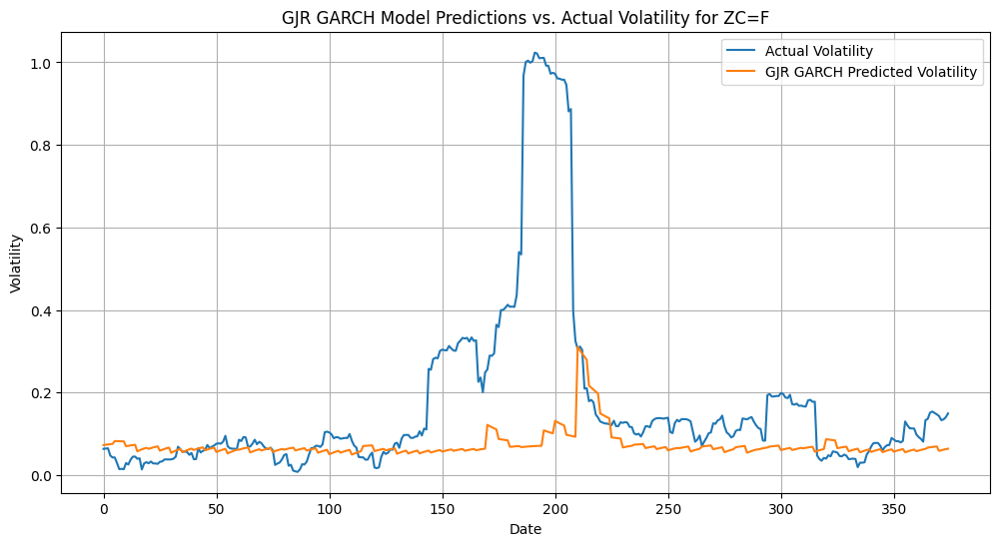

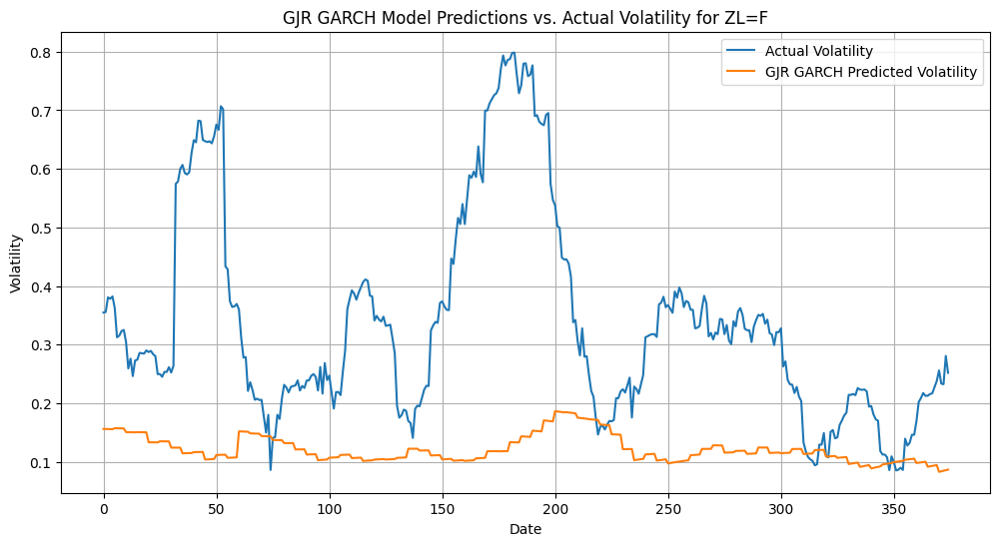

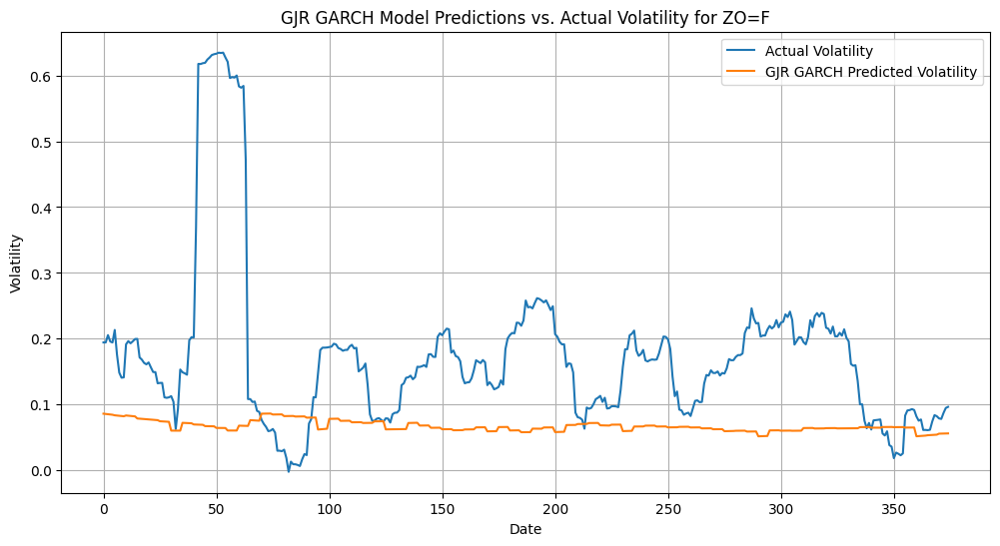

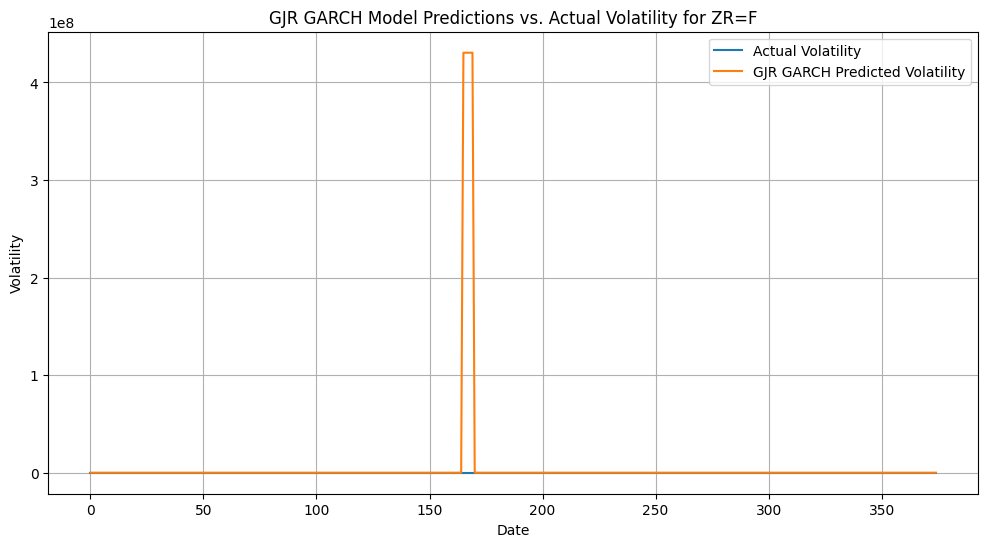

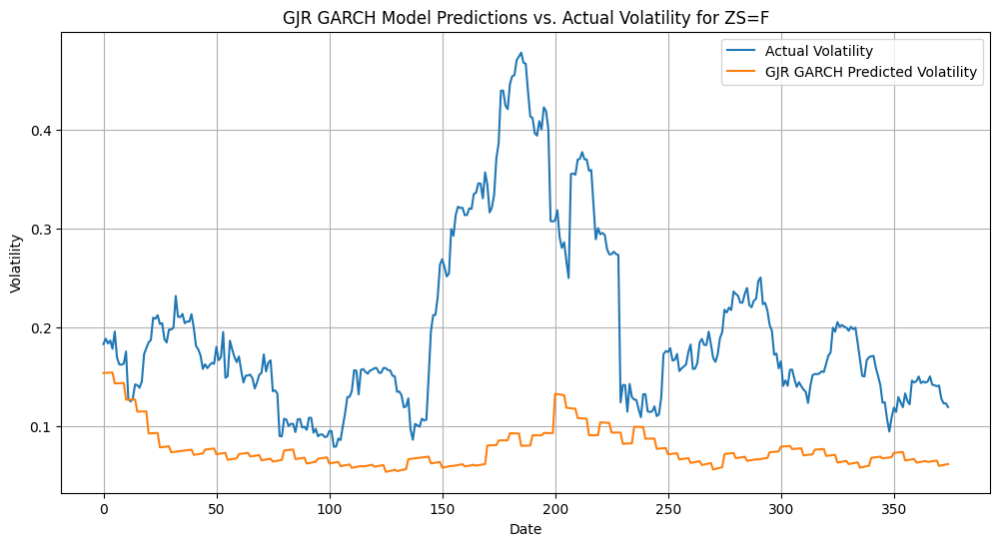

In [79]:
# Create a dictionary to store the forecasts for each ticker
grj_forecasts_dict = {}

# Loop through each ticker
for ticker in returns.columns:
  # Get the optimal model for the ticker
  model = optimal_grj_models_dict[ticker]

  # Initialize an empty list to store the forecasts
  forecasts = []

  # Loop through the validation data in 5-day windows
  for i in range(0, len(returns_val_scaled_dict[ticker]) - 5 + 1, 5):
    # Get the data up to the current window
    current_train_data = pd.concat([pd.Series(returns_train_scaled_dict[ticker].flatten()), pd.Series(returns_val_scaled_dict[ticker][:i].flatten())])

    # Fit the model on the current training data

    model = arch_model(current_train_data, vol='GARCH', p=1, o=1, q=1, dist='skewt')
    results = model.fit(disp='off')

    # Make a forecast for the next 5 days
    forecast = results.forecast(horizon=5)
    variance_forecast = forecast.variance.values[-1]

    # Get the volatility forecast (standard deviation of the forecast)
    volatility_forecast = np.sqrt(variance_forecast)

    # Append the volatility forecast to the list
    forecasts.extend(volatility_forecast)

  # Store the forecasts for the ticker in the dictionary
  grj_forecasts_dict[ticker] = forecasts

# Convert the forecasts to a DataFrame
grj_forecasts_df = pd.DataFrame(grj_forecasts_dict)

# Print the DataFrame
print(grj_forecasts_df)


# Calculate performance metrics for each ticker
rmse_scores_grj = {}
rmspe_scores_grj = {}

for ticker in grj_forecasts_df.columns:
  y_true = vol_back_val_scaled_dict[ticker][:len(grj_forecasts_df)].flatten()
  y_pred = grj_forecasts_df[ticker]
  rmse_scores_grj[ticker] = RMSE(y_true, y_pred)
  rmspe_scores_grj[ticker] = RMSPE(y_true, y_pred)

performance_df_grj = pd.DataFrame({'RMSE': rmse_scores_grj, 'RMSPE': rmspe_scores_grj})

print(performance_df_grj)

# Plot the predictions and actual values for each ticker
for ticker in grj_forecasts_df.columns:
  plt.figure(figsize=(12, 6))
  plt.plot(vol_back_val_scaled_dict[ticker][:len(grj_forecasts_df)], label='Actual Volatility')
  plt.plot(grj_forecasts_df[ticker], label='GJR GARCH Predicted Volatility')
  plt.title(f'GJR GARCH Model Predictions vs. Actual Volatility for {ticker}')
  plt.xlabel('Date')
  plt.ylabel('Volatility')
  plt.legend()
  plt.grid(True)
  plt.show()


Threshold Autoregressive Conditional Heteroskedasticity (TARCH)

TARCH Model results for CC=F:
                         Constant Mean - GJR-GARCH Model Results                         
Dep. Variable:                                 y   R-squared:                       0.000
Mean Model:                        Constant Mean   Adj. R-squared:                  0.000
Vol Model:                             GJR-GARCH   Log-Likelihood:                781.436
Distribution:      Standardized Skew Student's t   AIC:                          -1548.87
Method:                       Maximum Likelihood   BIC:                          -1516.49
                                                   No. Observations:                  754
Date:                           Thu, Sep 12 2024   Df Residuals:                      753
Time:                                   19:27:36   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
--------------

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packag

         CC=F       CL=F      GC=F      GF=F      HE=F      HG=F      KC=F  \
0    0.087366   0.079851  0.081717  0.053256  0.084825  0.118669  0.110744   
1    0.087561   0.093154  0.082600  0.054013  0.084775  0.118691  0.111756   
2    0.087650   0.101767  0.083452  0.054749  0.084726  0.118711  0.112650   
3    0.087691   0.107616  0.084276  0.055465  0.084678  0.118731  0.113441   
4    0.087710   0.111690  0.085072  0.056162  0.084631  0.118750  0.114141   
..        ...        ...       ...       ...       ...       ...       ...   
370  0.133410  14.182139  0.093330  0.065160  0.234576  0.082685  0.112939   
371  0.132573  15.374281  0.093579  0.073091  0.287954  0.084890  0.113872   
372  0.131750  16.666634  0.093820  0.078067  0.319636  0.086907  0.114684   
373  0.130940  18.067622  0.094053  0.081304  0.339782  0.088755  0.115390   
374  0.130142  19.586376  0.094280  0.083452  0.353015  0.090454  0.116006   

         KE=F      LE=F     MGC=F  ...      PL=F      RB=F     

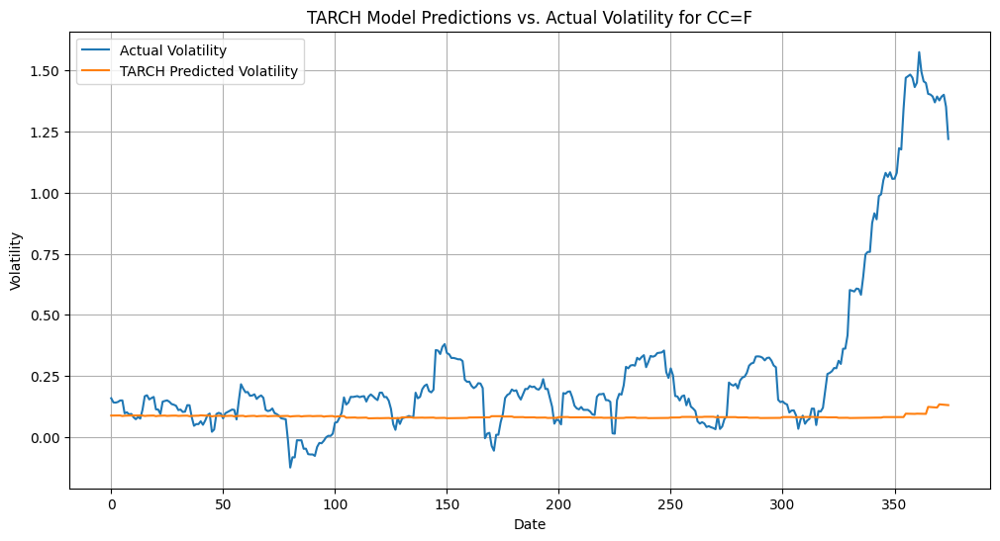

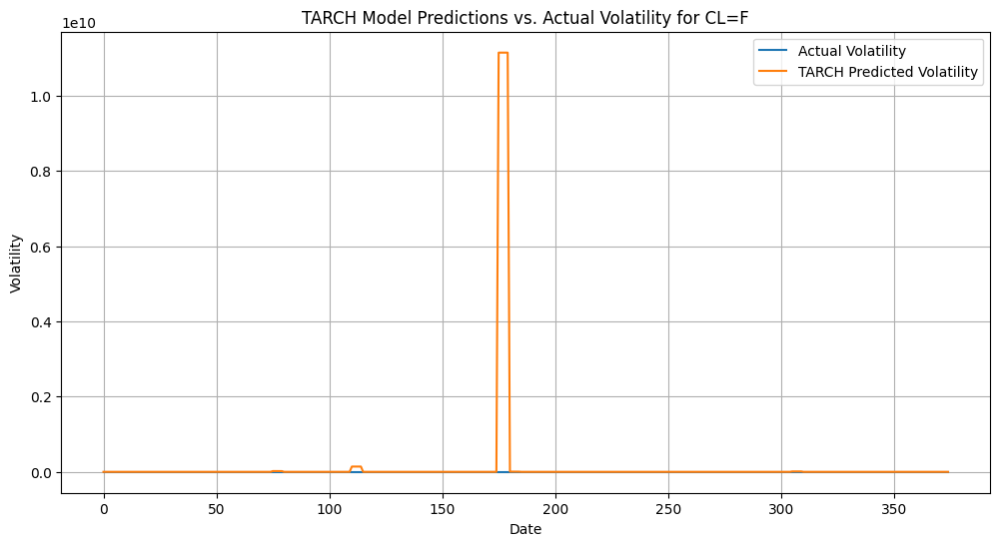

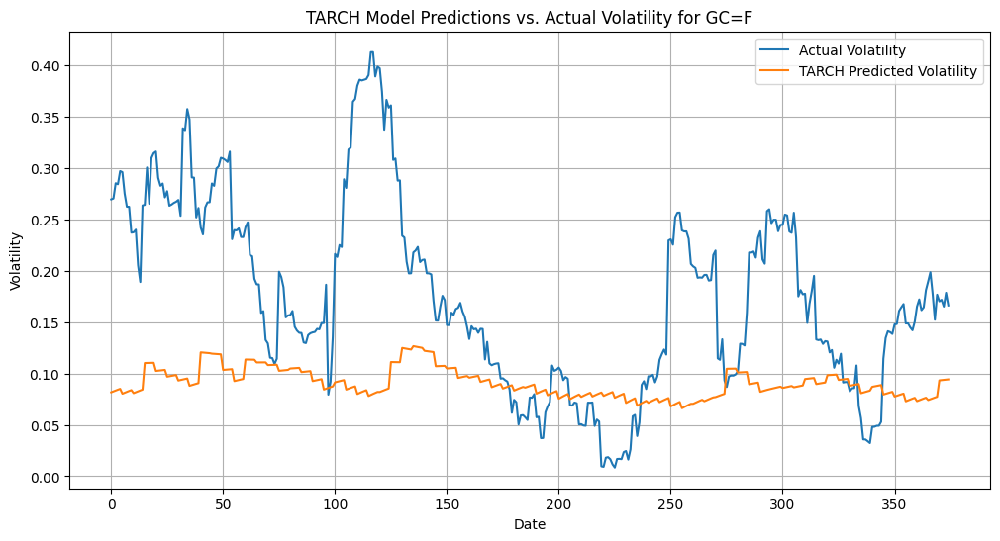

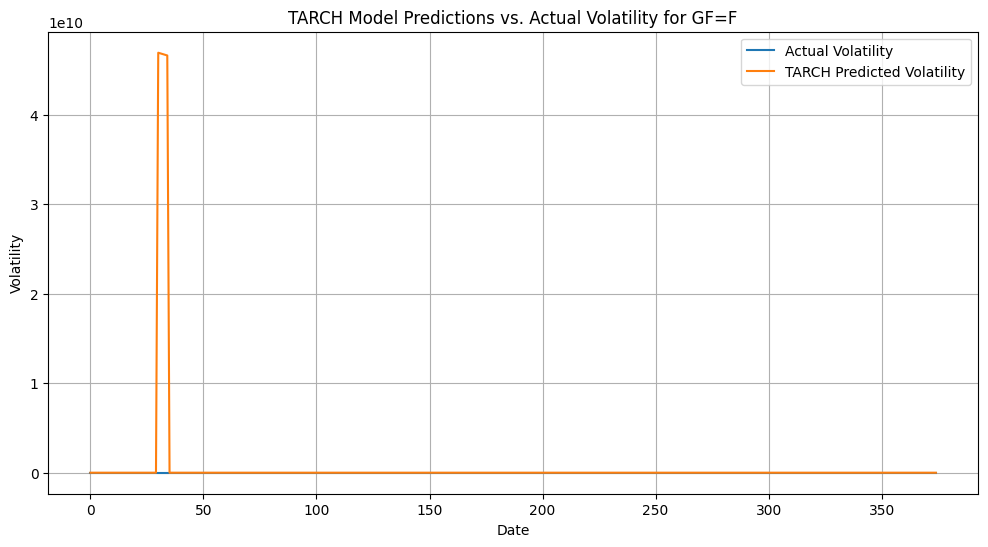

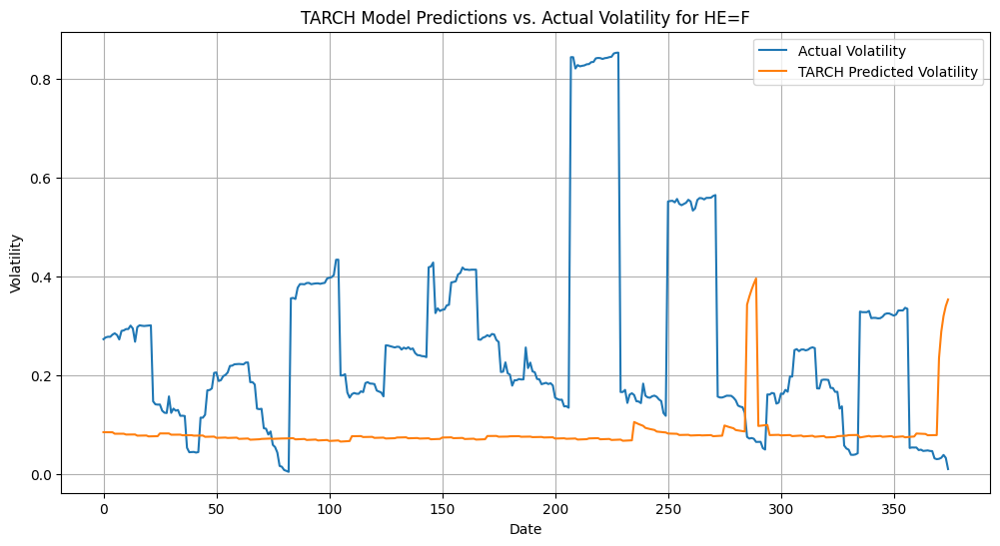

...

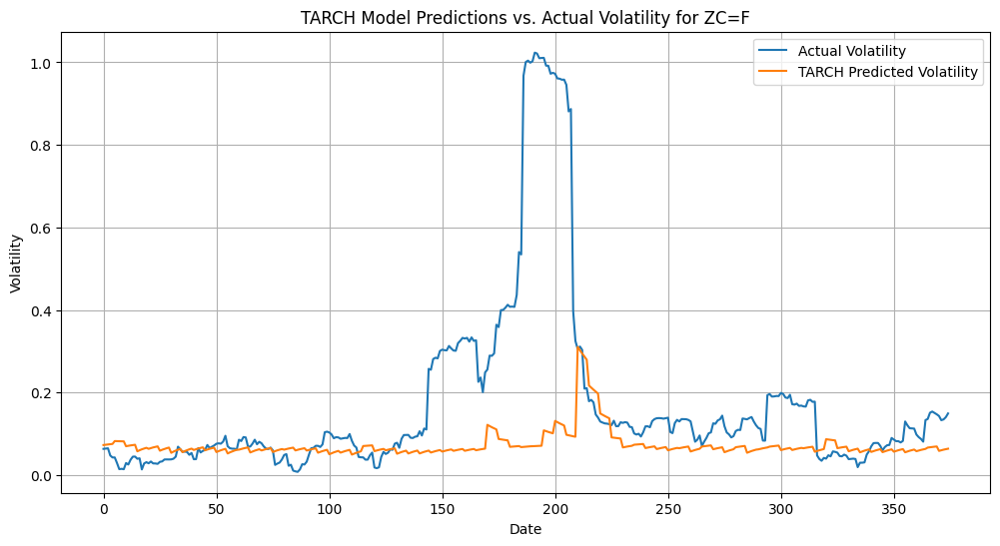

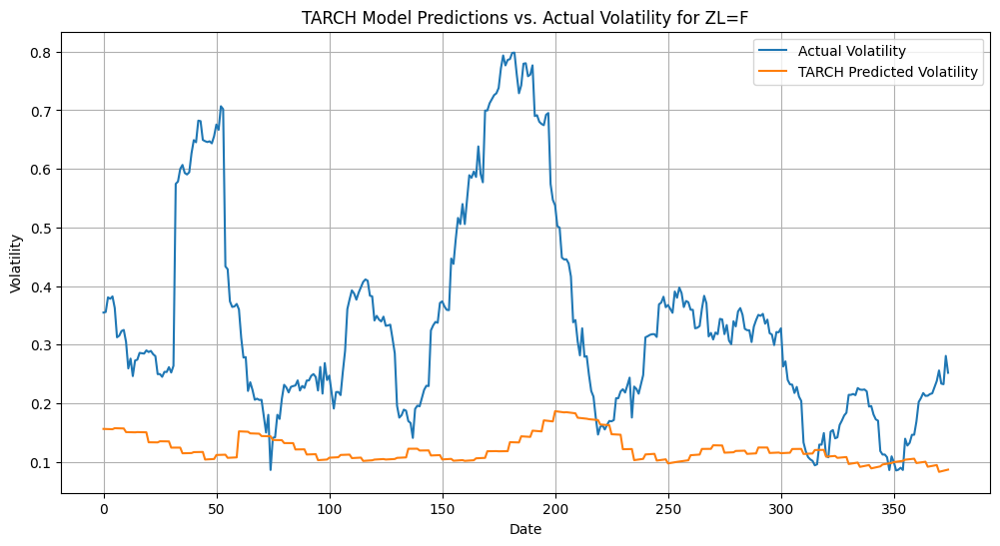

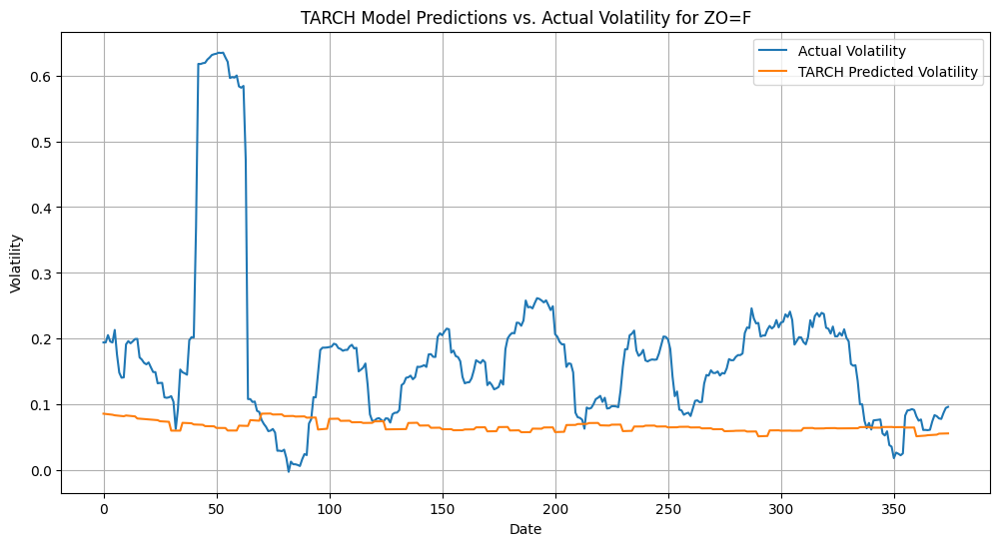

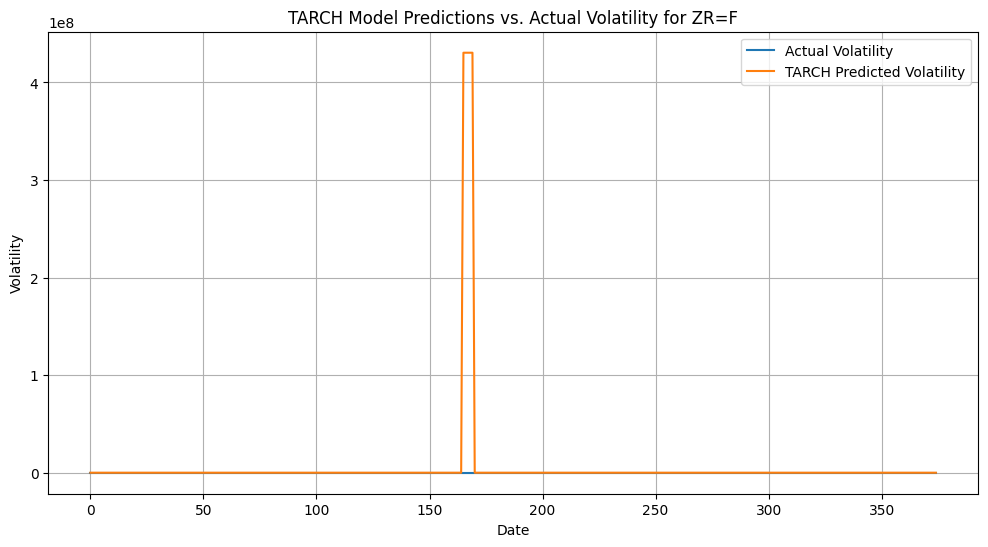

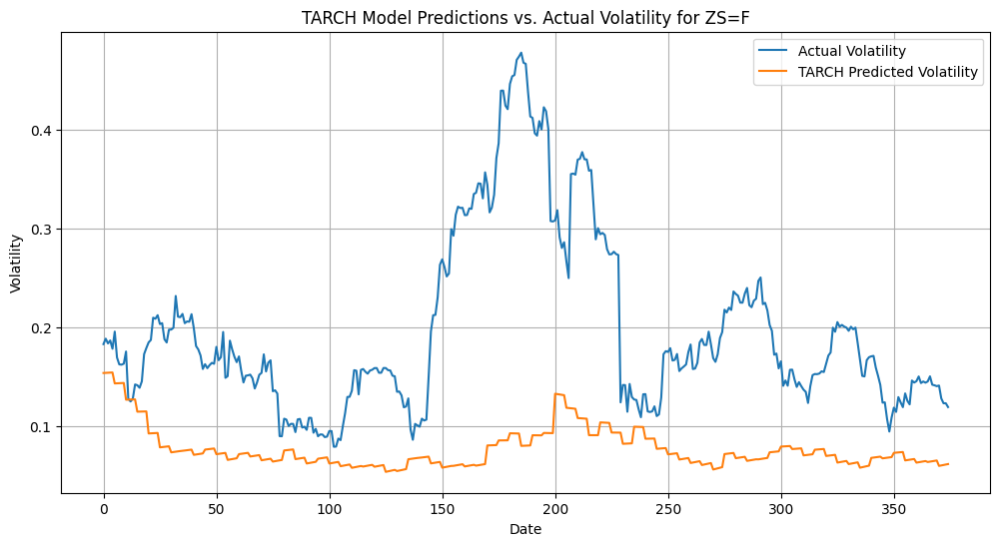

In [86]:
# Create a dictionary to store the optimal TARCH models for each ticker
optimal_tarch_models_dict = {}

# Fit the TARCH model for each ticker with the optimal parameters
for ticker in returns.columns:
    model = arch_model(returns_train_scaled_dict[ticker], vol='GARCH', p=1, o=1, q=1, power=2.0, dist='skewt')  # Set power=2.0 for TARCH
    results = model.fit(disp='off')
    optimal_tarch_models_dict[ticker] = results
    print(f"TARCH Model results for {ticker}:")
    print(results.summary())

# Create a dictionary to store the forecasts for each ticker
tarch_forecasts_dict = {}

# Loop through each ticker
for ticker in returns.columns:
  # Get the optimal model for the ticker
  model = optimal_tarch_models_dict[ticker]

  # Initialize an empty list to store the forecasts
  forecasts = []

  # Loop through the validation data in 5-day windows
  for i in range(0, len(returns_val_scaled_dict[ticker]) - 5 + 1, 5):
    # Get the data up to the current window
    current_train_data = pd.concat([pd.Series(returns_train_scaled_dict[ticker].flatten()), pd.Series(returns_val_scaled_dict[ticker][:i].flatten())])

    # Fit the model on the current training data

    model = arch_model(current_train_data, vol='GARCH', p=1, o=1, q=1, power=2.0, dist='skewt')
    results = model.fit(disp='off')

    # Make a forecast for the next 5 days
    forecast = results.forecast(horizon=5)
    variance_forecast = forecast.variance.values[-1]

    # Get the volatility forecast (standard deviation of the forecast)
    volatility_forecast = np.sqrt(variance_forecast)

    # Append the volatility forecast to the list
    forecasts.extend(volatility_forecast)

  # Store the forecasts for the ticker in the dictionary
  tarch_forecasts_dict[ticker] = forecasts

# Convert the forecasts to a DataFrame
tarch_forecasts_df = pd.DataFrame(tarch_forecasts_dict)

# Print the DataFrame
print(tarch_forecasts_df)


# Calculate performance metrics for each ticker
rmse_scores_tarch = {}
rmspe_scores_tarch = {}

for ticker in tarch_forecasts_df.columns:
  y_true = vol_back_val_scaled_dict[ticker][:len(tarch_forecasts_df)].flatten()
  y_pred = tarch_forecasts_df[ticker]
  rmse_scores_tarch[ticker] = RMSE(y_true, y_pred)
  rmspe_scores_tarch[ticker] = RMSPE(y_true, y_pred)

performance_df_tarch = pd.DataFrame({'RMSE': rmse_scores_tarch, 'RMSPE': rmspe_scores_tarch})

print(performance_df_tarch)

# Plot the predictions and actual values for each ticker
for ticker in tarch_forecasts_df.columns:
  plt.figure(figsize=(12, 6))
  plt.plot(vol_back_val_scaled_dict[ticker][:len(tarch_forecasts_df)], label='Actual Volatility')
  plt.plot(tarch_forecasts_df[ticker], label='TARCH Predicted Volatility')
  plt.title(f'TARCH Model Predictions vs. Actual Volatility for {ticker}')
  plt.xlabel('Date')
  plt.ylabel('Volatility')
  plt.legend()
  plt.grid(True)
  plt.show()


EGARCH

EGARCH Model results for CC=F:
                     Constant Mean - EGARCH Model Results                     
Dep. Variable:                      y   R-squared:                       0.000
Mean Model:             Constant Mean   Adj. R-squared:                  0.000
Vol Model:                     EGARCH   Log-Likelihood:                761.118
Distribution:                  Normal   AIC:                          -1512.24
Method:            Maximum Likelihood   BIC:                          -1489.11
                                        No. Observations:                  754
Date:                Thu, Sep 12 2024   Df Residuals:                      753
Time:                        19:33:20   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------------------
mu             0.4122  3.124e-03    131

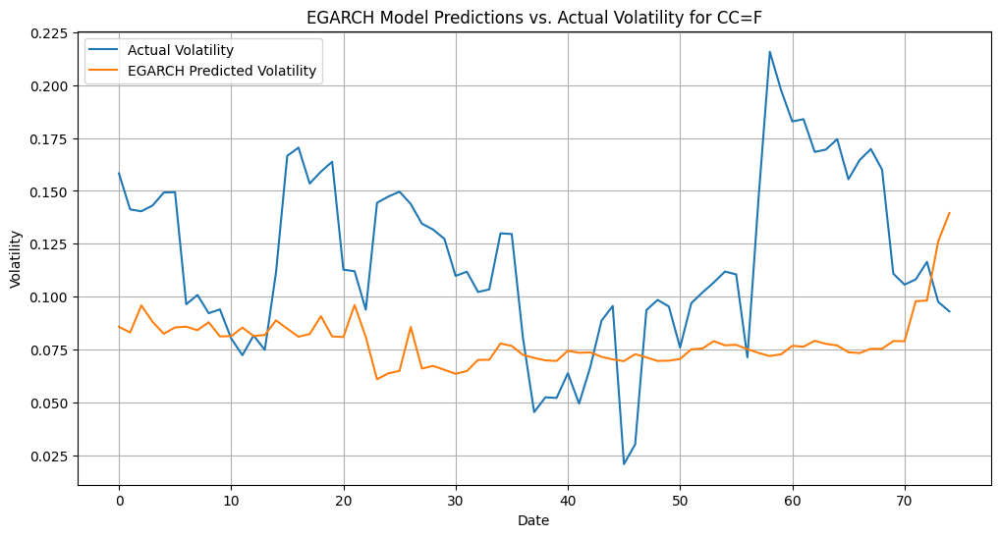

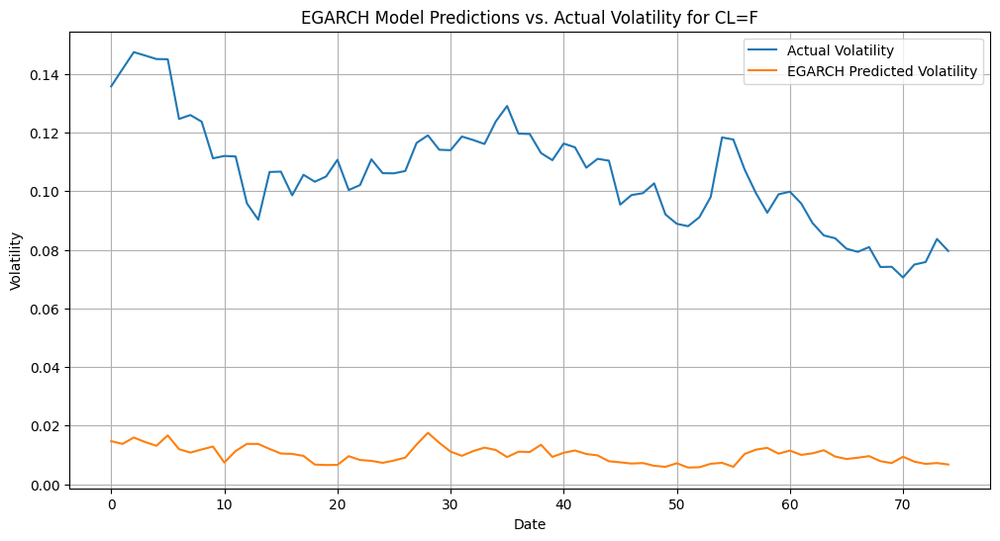

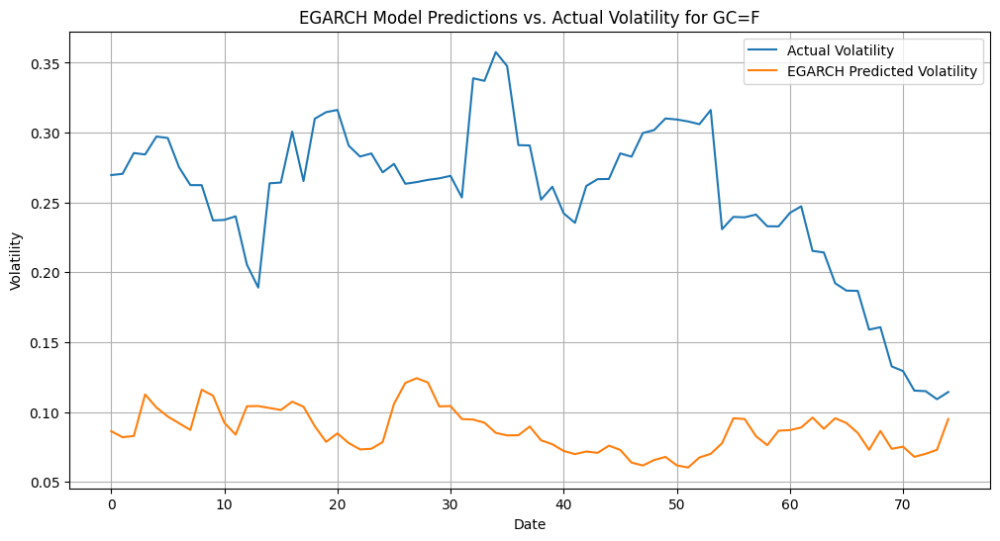

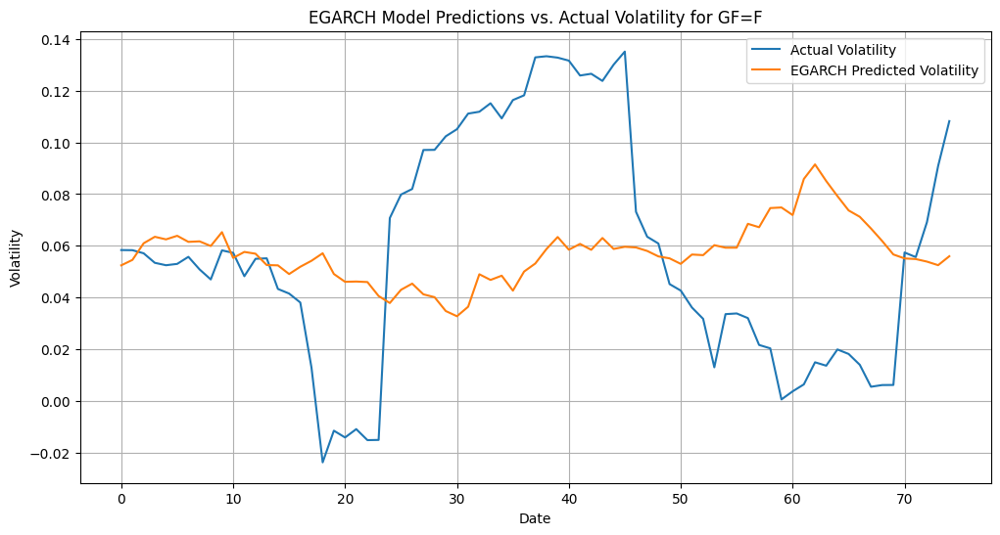

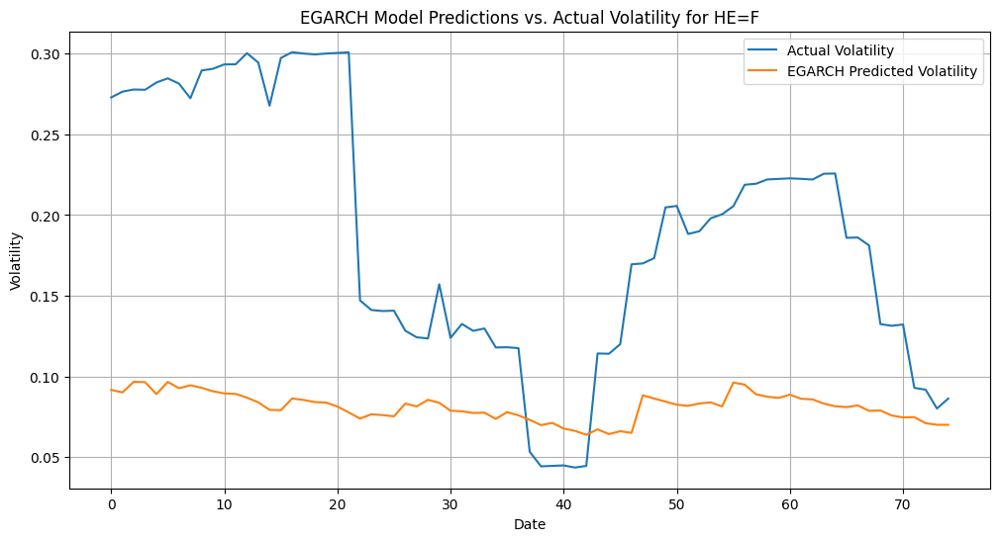

...

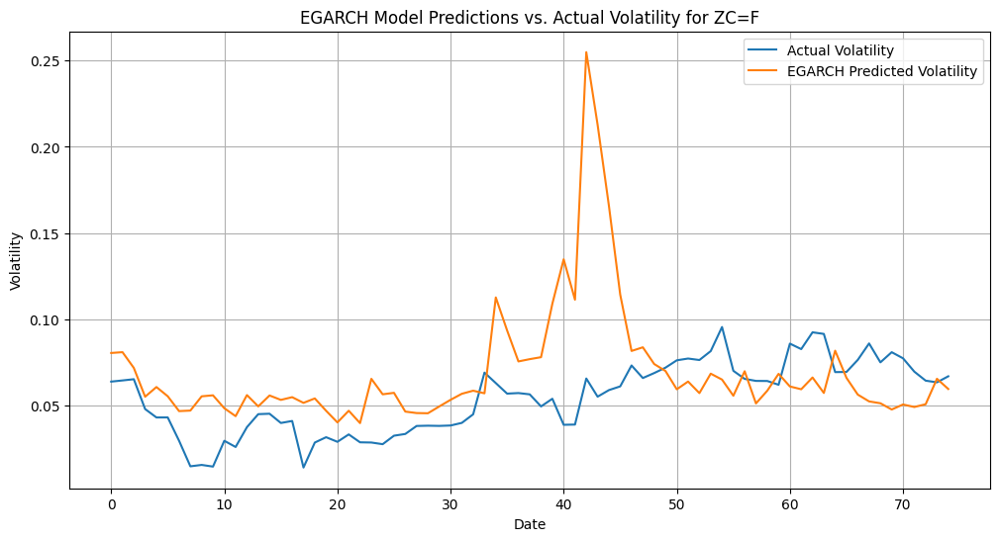

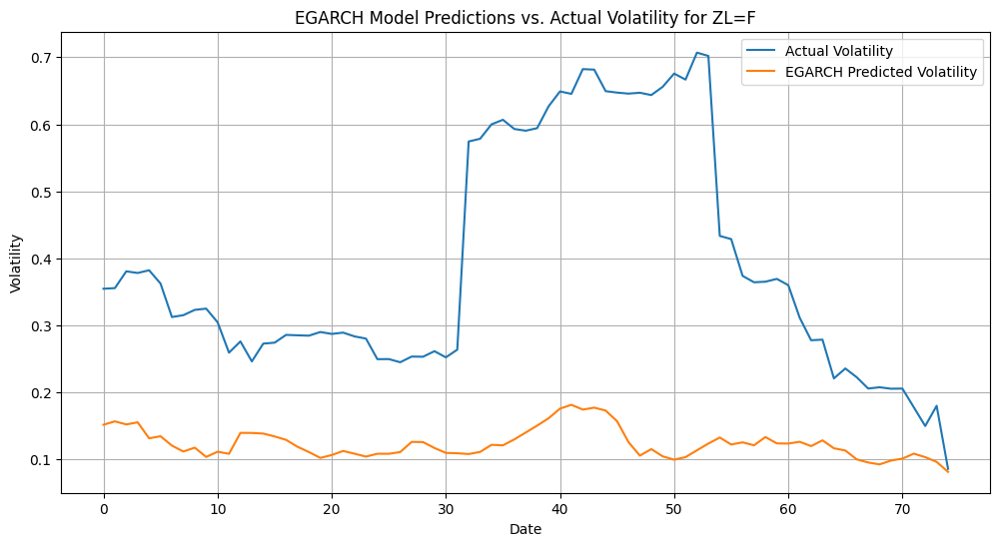

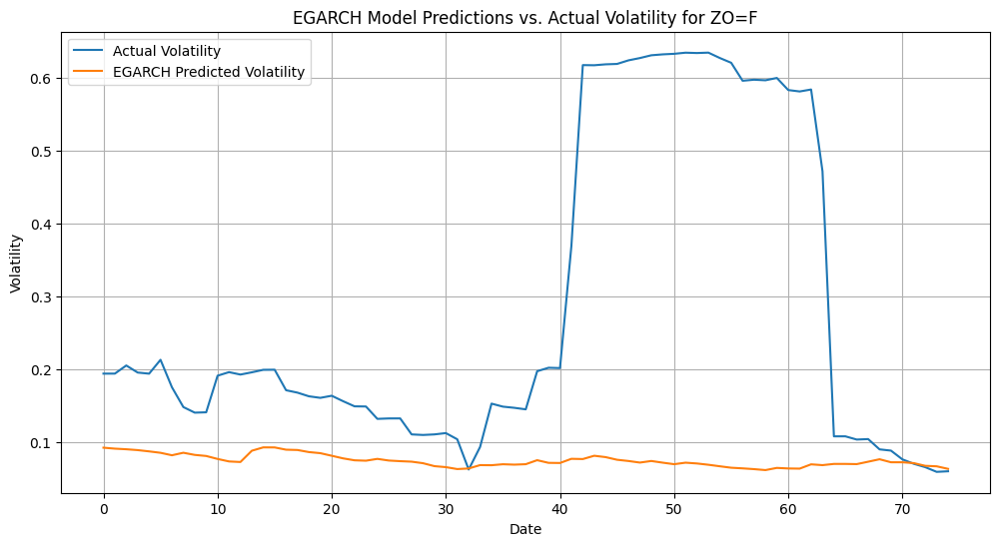

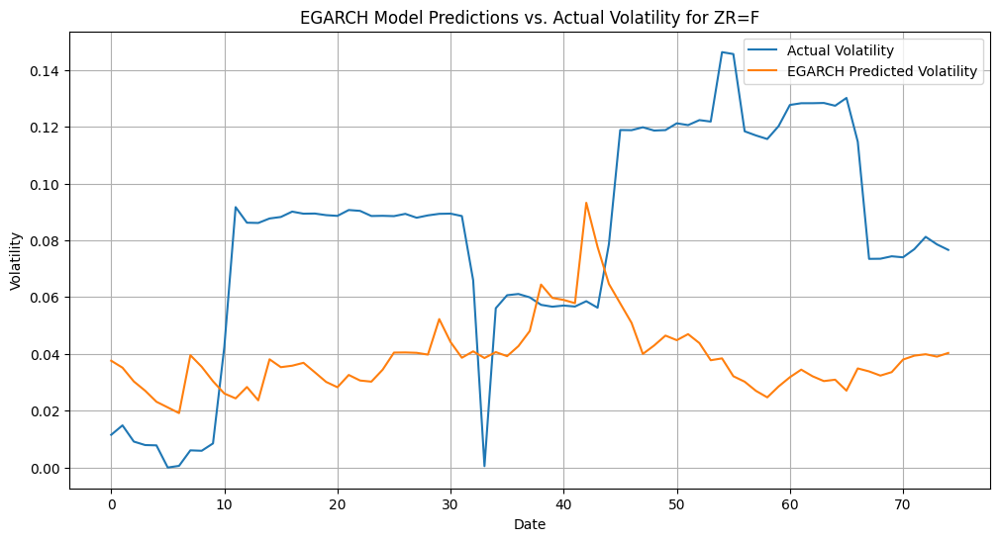

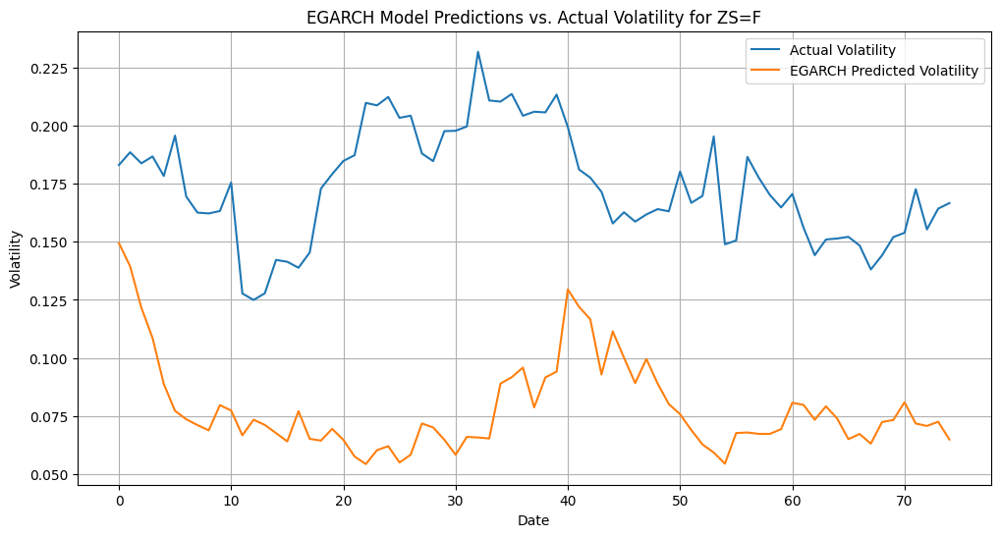

In [89]:
# Create a dictionary to store the optimal EGARCH models for each ticker
optimal_egarch_models_dict = {}

# Fit the EGARCH model for each ticker with the optimal parameters
for ticker in returns.columns:
    model = arch_model(returns_train_scaled_dict[ticker], vol='EGARCH', p=1, o=1, q=1, dist='Normal')  # Set o=1 for EGARCH
    results = model.fit(disp='off')
    optimal_egarch_models_dict[ticker] = results
    print(f"EGARCH Model results for {ticker}:")
    print(results.summary())

# Create a dictionary to store the forecasts for each ticker
egarch_forecasts_dict = {}

# Loop through each ticker
for ticker in returns.columns:
  # Get the optimal model for the ticker
  model = optimal_egarch_models_dict[ticker]

  # Initialize an empty list to store the forecasts
  forecasts = []

  # Loop through the validation data in 5-day windows
  for i in range(0, len(returns_val_scaled_dict[ticker]) - 5 + 1, 5):
    # Get the data up to the current window
    current_train_data = pd.concat([pd.Series(returns_train_scaled_dict[ticker].flatten()), pd.Series(returns_val_scaled_dict[ticker][:i].flatten())])

    # Fit the model on the current training data

    model = arch_model(current_train_data, vol='EGARCH', p=1, o=1, q=1, dist='Normal')
    results = model.fit(disp='off')

    # Make a forecast for the next 1 day
    forecast = results.forecast(horizon=1)
    variance_forecast = forecast.variance.values[-1]

    # Get the volatility forecast (standard deviation of the forecast)
    volatility_forecast = np.sqrt(variance_forecast)

    # Append the volatility forecast to the list
    forecasts.extend(volatility_forecast)

  # Store the forecasts for the ticker in the dictionary
  egarch_forecasts_dict[ticker] = forecasts

# Convert the forecasts to a DataFrame
egarch_forecasts_df = pd.DataFrame(egarch_forecasts_dict)

# Print the DataFrame
print(egarch_forecasts_df)


# Calculate performance metrics for each ticker
rmse_scores_egarch = {}
rmspe_scores_egarch = {}

for ticker in egarch_forecasts_df.columns:
  y_true = vol_back_val_scaled_dict[ticker][:len(egarch_forecasts_df)].flatten()
  y_pred = egarch_forecasts_df[ticker]
  rmse_scores_egarch[ticker] = RMSE(y_true, y_pred)
  rmspe_scores_egarch[ticker] = RMSPE(y_true, y_pred)

performance_df_egarch = pd.DataFrame({'RMSE': rmse_scores_egarch, 'RMSPE': rmspe_scores_egarch})

print(performance_df_egarch)

# Plot the predictions and actual values for each ticker
for ticker in egarch_forecasts_df.columns:
  plt.figure(figsize=(12, 6))
  plt.plot(vol_back_val_scaled_dict[ticker][:len(egarch_forecasts_df)], label='Actual Volatility')
  plt.plot(egarch_forecasts_df[ticker], label='EGARCH Predicted Volatility')
  plt.title(f'EGARCH Model Predictions vs. Actual Volatility for {ticker}')
  plt.xlabel('Date')
  plt.ylabel('Volatility')
  plt.legend()
  plt.grid(True)
  plt.show()


Final Results

In [93]:

# Merge the performance dataframes
performance_df_all = pd.concat([performance_df.rename(columns={'RMSE': 'RMSE_Mean', 'RMSPE': 'RMSPE_Mean'}),
                               performance_df_garch.rename(columns={'RMSE': 'RMSE_GARCH', 'RMSPE': 'RMSPE_GARCH'}),
                               performance_df_grj.rename(columns={'RMSE': 'RMSE_GJR', 'RMSPE': 'RMSPE_GJR'}),
                               performance_df_tarch.rename(columns={'RMSE': 'RMSE_TARCH', 'RMSPE': 'RMSPE_TARCH'}),
                               performance_df_egarch.rename(columns={'RMSE': 'RMSE_EGARCH', 'RMSPE': 'RMSPE_EGARCH'})], axis=1)

# Group the values by ticker
performance_df_grouped = performance_df_all.groupby(level=0, axis=1).mean()

print(performance_df_grouped)


       RMSE_EGARCH  RMSE_GARCH      RMSE_GJR  RMSE_Mean    RMSE_TARCH  \
CC=F      0.057158    0.393503  3.916212e-01   0.356941  3.916212e-01   
CL=F      0.097192    0.071911  1.287567e+09   0.081689  1.287567e+09   
GC=F      0.176839    0.124435  1.226551e-01   0.119058  1.226551e-01   
GF=F      0.049389    0.169110  5.403444e+09   0.162150  5.403444e+09   
HE=F      0.130100    0.268984  2.743077e-01   0.195708  2.743077e-01   
HG=F      0.519048    0.289806  2.896223e-01   0.228105  2.896223e-01   
KC=F      0.305463    0.230013  2.306210e-01   0.117389  2.306210e-01   
KE=F      0.092596    0.134412  1.341479e-01   0.114893  1.341479e-01   
LE=F      0.076648    0.078854  7.809099e-02   0.110890  7.809099e-02   
MGC=F     0.176960    0.124838  1.229900e-01   0.116667  1.229900e-01   
NG=F      0.374601    0.261611  2.614570e-01   0.129957  2.614570e-01   
OJ=F      0.347811    0.389679  3.913838e-01   0.214040  3.913838e-01   
PA=F      0.196238    0.167633  1.670404e-01   0.07